# Real-world Data Wrangling

In this project, you will apply the skills you acquired in the course to gather and wrangle real-world data with two datasets of your choice.

You will retrieve and extract the data, assess the data programmatically and visually, accross elements of data quality and structure, and implement a cleaning strategy for the data. You will then store the updated data into your selected database/data store, combine the data, and answer a research question with the datasets.

Throughout the process, you are expected to:

1. Explain your decisions towards methods used for gathering, assessing, cleaning, storing, and answering the research question
2. Write code comments so your code is more readable

Before you start, install the some of the required packages. 

In [1]:
!python -m pip install kaggle==1.6.12

Defaulting to user installation because normal site-packages is not writeable


In [2]:
!pip install --target=/workspace ucimlrepo

  Using cached ucimlrepo-0.0.7-py3-none-any.whl (8.0 kB)
  Using cached certifi-2024.6.2-py3-none-any.whl (164 kB)
  Using cached pandas-2.2.2-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (13.0 MB)
  Using cached numpy-2.0.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (19.3 MB)
  Using cached tzdata-2024.1-py2.py3-none-any.whl (345 kB)
  Using cached pytz-2024.1-py2.py3-none-any.whl (505 kB)
  Using cached python_dateutil-2.9.0.post0-py2.py3-none-any.whl (229 kB)
  Using cached six-1.16.0-py2.py3-none-any.whl (11 kB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
scipy 1.11.2 requires numpy<1.28.0,>=1.21.6, but you have numpy 2.0.0 which is incompatible.


**Note:** Restart the kernel to use updated package(s).

## 1. Gather data

In this section, you will extract data using two different data gathering methods and combine the data. Use at least two different types of data-gathering methods.

### **1.1.** Problem Statement
This project aims to invistegate the potential relationships between Space Weather, aka Solar flares and CME(Coronal Mass Ejection), NEO(Near Earth Objects) and Earth's Weather such as wind speed, tempreture and Pressure readings.



### **1.2.** Gather at least two datasets using two different data gathering methods

List of data gathering methods:

- Download data manually
- Programmatically downloading files
- Gather data by accessing APIs
- Gather and extract data from HTML files using BeautifulSoup
- Extract data from a SQL database

Each dataset must have at least two variables, and have greater than 500 data samples within each dataset.

For each dataset, briefly describe why you picked the dataset and the gathering method (2-3 full sentences), including the names and significance of the variables in the dataset. Show your work (e.g., if using an API to download the data, please include a snippet of your code). 

Load the dataset programmtically into this notebook.

#### **Dataset 1** Asteroids - NeoWs

Type: saved in jupyter as csv file.

Method: The data was gathered using the "API" method from [NASA APIs](https://api.nasa.gov/) source

The population of near-Earth objects (NEOs) contains asteroids, comets, and the precursor
bodies for meteorites.these objects are in the asteroid belt (Asteroid belt is a region located between the orbits of Mars and Jupiter.

![where astroids in space](Datasets_2024-01/AsteroidBelt)

Dataset variables:

*   *id * : The id of the object orbiting in asteroid belt, (could be Astroids which are the most common or comets which are not so common).
*   *name* : The name of the object.
*   *absolute_magnitude_h* : A measurement of how bright the object is, note that a lower number means the object is brighter..
*   *estimated_diameter_min* : The shortest diameter of the object in kilometers.
*   *estimated_diameter_max* : The longest diameter of the object in kilometers.
*   *close_approach_date* : The date when an object makes its closest approach to Earth.
*   *velocity_km_s* : The velocity at which an object is moving relative to Earth, in kilometers per second.
*   *miss_distance_km* : The distance by which an object will miss Earth,in kilometers, a smaller miss distance means an object comes closer to Earth.

In [47]:
#all the datasets will be saved in this folder in csv files.
import os
folder_name = 'Datasets_2024-01'
if not os.path.exists(folder_name):
    os.makedirs(folder_name)

In [48]:
import requests
import pandas as pd
import json
#my api key of nasa,gov datasets.
api_key = 'place_your_api_key'


In [5]:
#FILL IN 1st data gathering and loading method


#since i can't fetch more than 7 days of data i will fetch 7 days at a time, til 02-03-2024.
start_date = '2024-01-01'
end_date = '2024-01-07'

url = f"https://api.nasa.gov/neo/rest/v1/feed?start_date={start_date}&end_date={end_date}&api_key={api_key}"
#The first fetch was hard coded to observe the data closely.
neo_data = requests.get(url)
neo_data.raise_for_status()
neo_json = neo_data.json()
neo_json


{'links': {'next': 'http://api.nasa.gov/neo/rest/v1/feed?start_date=2024-01-07&end_date=2024-01-13&detailed=false&api_key=Kuzy0Koiia5FFefuSCXFz6yV1Q4kz1DhnmPXnvll',
  'previous': 'http://api.nasa.gov/neo/rest/v1/feed?start_date=2023-12-26&end_date=2024-01-01&detailed=false&api_key=Kuzy0Koiia5FFefuSCXFz6yV1Q4kz1DhnmPXnvll',
  'self': 'http://api.nasa.gov/neo/rest/v1/feed?start_date=2024-01-01&end_date=2024-01-07&detailed=false&api_key=Kuzy0Koiia5FFefuSCXFz6yV1Q4kz1DhnmPXnvll'},
 'element_count': 23,
 'near_earth_objects': {'2024-01-02': [{'links': {'self': 'http://api.nasa.gov/neo/rest/v1/neo/2415949?api_key=Kuzy0Koiia5FFefuSCXFz6yV1Q4kz1DhnmPXnvll'},
    'id': '2415949',
    'neo_reference_id': '2415949',
    'name': '415949 (2001 XY10)',
    'nasa_jpl_url': 'https://ssd.jpl.nasa.gov/tools/sbdb_lookup.html#/?sstr=2415949',
    'absolute_magnitude_h': 19.37,
    'estimated_diameter': {'kilometers': {'estimated_diameter_min': 0.3552670883,
      'estimated_diameter_max': 0.7944013596},
 

In [6]:
#A function to fetch neo dataset given the api key, the start date and the end date and return a json
#file of the origin dataset.
def get_neo(api_key, start_date, end_date):
    start_date = start_date
    end_date = end_date

    url = f"https://api.nasa.gov/neo/rest/v1/feed?start_date={start_date}&end_date={end_date}&api_key={api_key}"

    neo_data = requests.get(url)
    neo_data.raise_for_status()
    return neo_data.json()


In [7]:
def process_neo(neo_json):
    neo_data = []
    for date in neo_json:
        for data in neo_json[date]:
            neo_data.append({
                'id' : data['id'],
                'name' : data['name'],
                'absolute_magnitude_h' : data['absolute_magnitude_h'],
                'estimated_diameter_min' : data['estimated_diameter']['kilometers']['estimated_diameter_min'],
                'estimated_diameter_max' : data['estimated_diameter']['kilometers']['estimated_diameter_max'],
                'close_approach_date':data['close_approach_data'][0]['close_approach_date'],
                'velocity_km_s':data['close_approach_data'][0]['relative_velocity']['kilometers_per_second'],
                'miss_distance_km':data['close_approach_data'][0]['miss_distance']['kilometers']
            })
    return pd.DataFrame(neo_data)
    

In [8]:

neo_d = neo_json['near_earth_objects']
neo_df = process_neo(neo_d)



In [3]:
#A save function to save dataframes as csv files(every 7 days and a combined dataset also)
#it takes the dataframe that would be converted to csv, the folder name and the file name.
def save_neo(neo_df, folder_name, file_name):
    file = os.path.join(folder_name, file_name)
    if not os.path.exists(file):
        neo_df.to_csv(file, index=False)
    

In [10]:
file1 = "202401_02-07_neo_dataset.csv"
folder_neo = "Datasets_2024-01/2024_neo_datasets"
save_neo(neo_df, folder_neo, file1)

In [11]:
start_date2 = '2024-01-08'
end_date2 = '2024-01-14'
neo_json2 = get_neo(api_key, start_date2, end_date2)


In [12]:
neo_objects = neo_json2['near_earth_objects']
neo_df2 = process_neo(neo_objects)
neo_df2
        

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
0,3147312,(2003 BN1),20.59,0.202561,0.452939,2024-01-13,32.0921477759,23819476.10863468
1,3266506,(2005 BH14),21.44,0.136948,0.306225,2024-01-12,17.4495318432,48698372.004509653
2,2430804,430804 (2005 AD13),17.89,0.702352,1.570507,2024-01-14,29.0073806068,20388991.117825347
3,2456946,456946 (2008 AF32),21.26,0.148784,0.332690,2024-01-14,15.4778854481,38618399.935591987
4,2168318,168318 (1989 DA),18.91,0.439091,0.981838,2024-01-08,8.8851478203,17607387.097578032
5,3102728,(2002 AY1),20.85,0.179703,0.401828,2024-01-08,17.3391710732,5803011.720688912
6,3781028,(2017 QP17),19.60,0.319562,0.714562,2024-01-09,20.4028017464,58688124.051435387
7,2678263,678263 (2017 QP17),19.58,0.322519,0.721174,2024-01-09,20.4027975978,58688123.079049232
8,3092124,(1994 GL),25.50,0.021113,0.047211,2024-01-11,7.9110407383,68392432.770871925
9,3363430,(2006 XY2),22.50,0.084053,0.187949,2024-01-11,9.2537526551,50573342.875874447


In [13]:
file2 = "202401_08-14_neo_dataset.csv"
save_neo(neo_df2, folder_neo, file2)

In [14]:
start_date3 = '2024-01-15'
end_date3 = '2024-01-21'
neo_json3 = get_neo(api_key, start_date3, end_date3)



In [15]:
neo_objects3 = neo_json3['near_earth_objects']
neo_df3 = process_neo(neo_objects3)
neo_df3


,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
0,2380476,380476 (2003 YO1),19.35,0.358554,0.801752,2024-01-15,9.4111274411,50543385.049699088
1,3312035,(2006 AM8),19.59,0.321037,0.717860,2024-01-15,39.5920533483,64141071.460559701
2,3632236,(2013 EH89),20.18,0.244655,0.547066,2024-01-15,9.4885247624,15343813.244408803
3,2670011,670011 (2013 EH89),20.08,0.256186,0.572849,2024-01-15,9.488525687,15343807.679368039
4,3009717,(1997 AC11),20.68,0.194337,0.434550,2024-01-17,16.2394388797,38744735.995037615
5,2042286,42286 (2001 TN41),16.65,1.243240,2.779969,2024-01-16,9.8716049671,72441875.493095461
6,2508767,508767 (1993 BD2),18.20,0.608913,1.361570,2024-01-16,12.8547670552,74157207.335827985
7,2264357,264357 (2000 AZ93),21.17,0.155080,0.346769,2024-01-19,24.0143933935,72841929.279301389
8,2308041,308041 (2004 TN),18.98,0.425163,0.950692,2024-01-19,12.1667418528,35395665.411356061
9,2523657,523657 (2012 DJ4),20.39,0.222103,0.496638,2024-01-18,4.1615551077,65624920.256627343


In [16]:
file3 = "202401_15-21_neo_dataset.csv"
save_neo(neo_df2, folder_neo, file3)

In [17]:
start_date4 = '2024-01-22'
end_date4 = '2024-01-27'
neo_json4 = get_neo(api_key, start_date4, end_date4)


In [18]:
neo_objects4 = neo_json4['near_earth_objects']
neo_df4 = process_neo(neo_objects4)
neo_df4

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
0,2524391,524391 (2002 AD2),20.60,0.201630,0.450858,2024-01-23,19.7453369715,45129680.916782311
1,3172327,(2004 BH11),23.95,0.043108,0.096392,2024-01-23,4.9111111526,47266712.250485525
2,2163693,163693 Atira (2003 CP20),16.41,1.388529,3.104845,2024-01-26,17.3727597981,33600363.543890395
3,2418265,418265 (2008 EA32),16.48,1.344482,3.006353,2024-01-25,18.731902447,62161537.587180772
4,2505657,505657 (2014 SR339),18.48,0.535248,1.196851,2024-01-25,16.4652725542,63956600.382290391
5,2382825,382825 (2003 XB22),19.30,0.366906,0.820427,2024-01-27,15.8386297153,61020855.937760739
6,3512347,(2010 FC6),20.23,0.239086,0.534614,2024-01-27,19.4531382702,74539243.195536225
7,2666360,666360 (2010 FC6),20.23,0.239086,0.534614,2024-01-27,19.4531384987,74539243.689209196
8,3183847,(2004 LO2),25.00,0.026580,0.059435,2024-01-22,19.1371842643,47061356.277338912


In [19]:
file4 = "202401_22-27_neo_dataset.csv"
save_neo(neo_df4, folder_neo, file4)

In [20]:
start_date5 = '2024-01-28'
end_date5 = '2024-02-02'
neo_json5 = get_neo(api_key, start_date5, end_date5)


In [21]:
neo_objects5 = neo_json5['near_earth_objects']
neo_df5 = process_neo(neo_objects5)
neo_df5

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
0,3789224,(2017 VT12),20.40,0.221083,0.494356,2024-02-02,11.984125665,41198419.704030277
1,2585185,585185 (2017 VT12),20.43,0.218049,0.487573,2024-02-02,11.98412627,41198422.157435345
2,2152742,152742 (1998 XE12),19.10,0.402305,0.899580,2024-01-28,24.9483490763,17412222.045491346
3,2175706,175706 (1996 FG3),18.32,0.576176,1.288368,2024-01-28,9.8520250044,63027270.99256082
4,2476904,476904 (2008 WK32),19.11,0.400456,0.895447,2024-01-28,13.7949666467,44267980.699897037
5,2267720,267720 (2003 CA),18.93,0.435066,0.972837,2024-01-29,32.6242547648,35295191.652158589
6,3560816,(2011 FR29),21.54,0.130784,0.292442,2024-01-29,9.3384442533,10609397.838783215
7,2667303,667303 (2011 FR29),21.55,0.130183,0.291099,2024-01-29,9.33844426,10609397.898622363
8,3309091,(2005 YO3),25.10,0.025384,0.056760,2024-01-31,22.9567735451,69008383.585099128
9,3402610,(2008 CH116),19.27,0.372010,0.831840,2024-01-31,25.1553623685,50145460.400218148


In [22]:
file5 = "2024_0128_0202_neo_dataset.csv"
save_neo(neo_df5, folder_neo, file5)

In [23]:
start_date6 = '2024-02-03'
end_date6 = '2024-02-10'
neo_json6 = get_neo(api_key, start_date6, end_date6)


In [24]:
neo_objects6 = neo_json6['near_earth_objects']
neo_df6 = process_neo(neo_objects6)
neo_df6

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
0,2004544,4544 Xanthus (1989 FB),17.380,0.888290,1.986278,2024-02-03,6.8414179658,50097107.720751849
1,2280136,280136 (2002 OM4),17.200,0.965061,2.157943,2024-02-03,37.7013032674,46058770.531045846
2,2444004,444004 (2004 AS1),20.670,0.195234,0.436556,2024-02-03,17.6392732842,48716096.97349852
3,3366282,(2007 BD),25.400,0.022108,0.049436,2024-02-03,12.0613788286,24884676.701646874
4,54402375,(1999 TJ10),20.960,0.170826,0.381979,2024-02-03,7.8277963769,55542460.794005613
5,54426230,(2024 CW2),24.333,0.036137,0.080805,2024-02-03,7.7485945687,4482860.109632817
6,2347813,347813 (2002 NP1),17.650,0.784431,1.754042,2024-02-05,13.3104163583,38036461.678128197
7,2444627,444627 (2006 WU),19.060,0.409784,0.916305,2024-02-05,1.9982610855,62716380.214676765
8,2451370,451370 (2011 AK5),21.480,0.134448,0.300635,2024-02-05,8.2382303218,64603502.008474652
9,3383667,(2007 RF1),26.100,0.016016,0.035813,2024-02-04,10.9204815314,50796452.690398837


In [25]:
file6 = "202402_03-10_neo_dataset.csv"
save_neo(neo_df6, folder_neo, file6)

In [26]:
start_date7 = '2024-02-11'
end_date7 = '2024-02-17'
neo_json7 = get_neo(api_key, start_date7, end_date7)
neo_json7

{'links': {'next': 'http://api.nasa.gov/neo/rest/v1/feed?start_date=2024-02-17&end_date=2024-02-23&detailed=false&api_key=Kuzy0Koiia5FFefuSCXFz6yV1Q4kz1DhnmPXnvll',
  'previous': 'http://api.nasa.gov/neo/rest/v1/feed?start_date=2024-02-05&end_date=2024-02-11&detailed=false&api_key=Kuzy0Koiia5FFefuSCXFz6yV1Q4kz1DhnmPXnvll',
  'self': 'http://api.nasa.gov/neo/rest/v1/feed?start_date=2024-02-11&end_date=2024-02-17&detailed=false&api_key=Kuzy0Koiia5FFefuSCXFz6yV1Q4kz1DhnmPXnvll'},
 'element_count': 18,
 'near_earth_objects': {'2024-02-13': [{'links': {'self': 'http://api.nasa.gov/neo/rest/v1/neo/2505093?api_key=Kuzy0Koiia5FFefuSCXFz6yV1Q4kz1DhnmPXnvll'},
    'id': '2505093',
    'neo_reference_id': '2505093',
    'name': '505093 (2011 VQ5)',
    'nasa_jpl_url': 'https://ssd.jpl.nasa.gov/tools/sbdb_lookup.html#/?sstr=2505093',
    'absolute_magnitude_h': 20.2,
    'estimated_diameter': {'kilometers': {'estimated_diameter_min': 0.2424124811,
      'estimated_diameter_max': 0.5420507863},
   

In [27]:
neo_objects7 = neo_json7['near_earth_objects']
neo_df7 = process_neo(neo_objects7)
neo_df7

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
0,2505093,505093 (2011 VQ5),20.20,0.242412,0.542051,2024-02-13,2.4104282616,53716483.045548375
1,3063823,(2000 WP19),22.70,0.076658,0.171412,2024-02-13,10.7760890124,23666921.795769018
2,3384028,(2007 RX8),24.53,0.033003,0.073797,2024-02-13,6.9922696305,48762731.985181266
3,3451019,(2009 EF3),21.57,0.128990,0.288430,2024-02-13,11.7484951148,29762717.656307387
4,2612197,612197 (2000 WP19),22.93,0.068953,0.154184,2024-02-13,10.7760869275,23666922.394160498
5,2665326,665326 (2009 EF3),21.57,0.128990,0.288430,2024-02-13,11.7484950955,29762717.671267174
6,2137924,137924 (2000 BD19),17.50,0.840533,1.879490,2024-02-16,23.6888818034,65043227.414469288
7,2355046,355046 (2006 SO19),19.67,0.309425,0.691895,2024-02-16,8.7056158569,66939530.418503537
8,3092138,(1995 FO),20.78,0.185590,0.414992,2024-02-16,8.917022582,19913642.479680369
9,3274166,(2005 EL169),22.06,0.102933,0.230165,2024-02-16,5.7822832319,45181646.713924424


In [28]:
file7 = "202402_11-17_neo_dataset.csv"
save_neo(neo_df7, folder_neo, file7)

In [29]:
start_date8 = '2024-02-18'
end_date8 = '2024-02-24'
neo_json8 = get_neo(api_key, start_date8, end_date8)


In [30]:
neo_objects8 = neo_json8['near_earth_objects']
neo_df8 = process_neo(neo_objects8)
neo_df8

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
0,3341510,(2006 RH2),27.200,0.009651,0.021579,2024-02-18,6.5483451916,23711727.031024433
1,2163243,163243 (2002 FB3),16.470,1.350688,3.020230,2024-02-19,15.0506746994,46991829.275996221
2,2225586,225586 (2000 WS67),18.510,0.527904,1.180429,2024-02-19,27.3672365157,53825559.101144883
3,2417264,417264 (2006 AT2),17.100,1.010543,2.259644,2024-02-21,15.3033229925,23912957.334273038
4,2187026,187026 (2005 EK70),17.360,0.896510,2.004657,2024-02-20,15.1097938071,14492380.318296091
5,2311554,311554 (2006 BQ147),18.720,0.479242,1.071618,2024-02-20,21.016382495,34159406.565420461
6,3330686,(2006 HX30),26.200,0.015295,0.034201,2024-02-20,2.9726421634,56602614.254079747
7,2483423,483423 (2000 DO1),20.530,0.208236,0.465629,2024-02-23,32.6214179403,48310068.098766922
8,3726791,(2015 RH2),22.010,0.105331,0.235527,2024-02-23,9.6737303128,14697568.652069582
9,2674590,674590 (2015 RH2),22.000,0.105817,0.236614,2024-02-23,9.6737258102,14697540.856785336


In [31]:
file_n8 = "202402_18-24_neo_dataset.csv"
save_neo(neo_df8, folder_neo, file_n8)

In [32]:
start_date9 = '2024-02-25'
end_date9 = '2024-03-02'
neo_json9 = get_neo(api_key, start_date9, end_date9)


In [33]:
neo_objects9 = neo_json9['near_earth_objects']
neo_df9 = process_neo(neo_objects9)
neo_df9

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
0,2523971,523971 (1999 AJ39),21.27,0.148100,0.331162,2024-02-25,9.0838749664,65139624.347473307
1,2363505,363505 (2003 UC20),18.47,0.537718,1.202375,2024-02-26,5.9569802299,47673169.932551691
2,3558387,(2011 EG17),20.70,0.192555,0.430566,2024-02-26,11.8711161341,72091645.651487708
3,2667255,667255 (2011 EG17),20.68,0.194337,0.434550,2024-02-26,11.8711161034,72091645.651487708
4,3160723,(2003 RU11),25.50,0.021113,0.047211,2024-02-28,7.8560487764,38188780.075152869
5,3160737,(2003 SK84),21.23,0.150853,0.337318,2024-02-28,15.5945194939,30081649.768497552
6,3172332,(2004 BV18),25.90,0.017561,0.039268,2024-02-28,10.6916938954,35627987.193438885
7,3666785,(2014 FP47),22.35,0.090065,0.201391,2024-02-28,7.8880498206,63261743.004668302
8,2671076,671076 (2014 FP47),22.36,0.089651,0.200466,2024-02-28,7.888049918,63261742.989708515
9,2366470,366470 (2002 FD),19.48,0.337719,0.755162,2024-03-01,17.7306726523,62302477.166298995


In [34]:
file9 = "2024_0225_0302_neo_dataset.csv"
save_neo(neo_df9, folder_neo, file9)

In [35]:
neos_df = pd.concat([neo_df, neo_df2, neo_df3, neo_df4, neo_df5, neo_df6, neo_df7, neo_df8, neo_df9])
neos_df

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
0,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.8905264223,50452409.349026638
1,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.7191818981,19798169.933318188
2,3309828,(2005 YQ96),20.62,0.199781,0.446725,2024-01-02,15.6702817644,24984732.559194501
3,3608936,(2012 SD22),20.05,0.259750,0.580818,2024-01-02,11.0227943004,24597313.435094098
4,2613286,613286 (2005 YQ96),20.63,0.198863,0.444672,2024-01-02,15.6702896005,24984795.0462248
...,...,...,...,...,...,...,...,...
15,2539856,539856 (2017 EV2),20.92,0.174002,0.389081,2024-03-02,19.3996029506,18231092.033160732
16,3071939,(2001 BB16),23.20,0.060891,0.136157,2024-03-02,15.2274293677,53576160.303327523
17,3069758,(2001 CP36),23.92,0.043707,0.097733,2024-03-02,14.6383486549,27823239.614926687
18,3160748,(2003 SW130),29.10,0.004023,0.008996,2024-03-02,8.567219024,44588301.618873134


In [36]:
file_com = "202401-03_neo_combined.csv"
save_neo(neos_df, folder_name, file_com)

In [37]:
os.listdir(folder_name)

['2024_01-03_temp_dataset.csv',
 '2024_donki_flr_dataset.csv',
 '202401-03_neo_combined.csv',
 '2024_cme_flr_donki_dataset.csv',
 '2024_neo_datasets',
 'TempDaily.csv',
 'AsteroidBelt',
 '2024_neo_cme_flr_temp_combined_dataset.csv',
 '2024_01-03_cme_dataset.csv',
 '.ipynb_checkpoints']

#### **Dataset 2** Space Weather (DONKI)

Type: saved in jupyter as csv file.

Method: The data was gathered using the "API" method from [NASA APIs](https://api.nasa.gov/) source.

Harmful space weather events can trigger atmospheric changes that result in physical and economic damages on a global scale. In 1989, Earth experienced the effects of a powerful geomagnetic storm that caused satellites to malfunction,[(Prediction of Space Weather Events)](https://arxiv.org/abs/2405.02545), i focused here on two space weather events : CME ( Coronal Mass Ejection, CMEs are large expulsions of plasma and magnetic field from the Sun's corona) and
FLR (Solar flares are sudden and intense bursts of radiation emanating from the Sun's atmosphere.).

Dataset variables(CME):

*   *date * : The date of CME event.
*   *halfAngle_CME* : The half-angle of the CME cone, which indicates the angular width of the CME. A larger half-angle generally means a wider spread of the CME material.
*   *speed_CME* : speed at which the CME is traveling in km/s.
*   *type_CME* :  'S' (Structured CME): have a defined structure and easier to track, 'C' (Cloude-like CME): doesn't have a shape and kinda look like cloud, are harder to track.

--------------------------------------------------------------------------------------------------

Dataset variables(FLR):

*   *date * : The date of FLR event.
*   *classType_FLR* :  represents the classification of the solar flare based on its X-ray brightness.there are class A, B, C, M and X with X being the most intense and would cause a world-wide blackout.
     

In [38]:
#using the same api because they are from the same source.
donki_url = 'https://api.nasa.gov/DONKI/'


In [39]:
urld = f"{donki_url}CME?startDate=2024-01-01&endDate=2024-03-02&api_key={api_key}"
donki_data = requests.get(urld)
donki_data.raise_for_status()
donki_json = donki_data.json()
donki_json

[{'activityID': '2024-01-01T17:00:00-CME-001',
  'catalog': 'M2M_CATALOG',
  'startTime': '2024-01-01T17:00Z',
  'instruments': [{'displayName': 'SOHO: LASCO/C2'},
   {'displayName': 'SOHO: LASCO/C3'}],
  'sourceLocation': '',
  'activeRegionNum': None,
  'note': 'Faint CME with the source is likely the minor movement of field lines behind the limb in SE in AIA 171 starting around 2024-01-01T16:30Z. Fully covered by data gap in STEREO A.',
  'submissionTime': '2024-01-02T13:40Z',
  'versionId': 1,
  'link': 'https://webtools.ccmc.gsfc.nasa.gov/DONKI/view/CME/28435/-1',
  'cmeAnalyses': [{'isMostAccurate': True,
    'time21_5': '2024-01-02T01:01Z',
    'latitude': -64.0,
    'longitude': None,
    'halfAngle': 26.0,
    'speed': 416.0,
    'type': 'S',
    'featureCode': 'LE',
    'imageType': 'running difference',
    'measurementTechnique': 'Plane-of-sky',
    'note': '3D measurement not possible because the source is behind the limb and only SOHO coronagraph imagery is available (dat

In [40]:
#a function to process the CME dataset and return a dataframe.
def process_donki(donki_json):
    donki = []
    for data in donki_json:
        donki.append({
            "date" : data['startTime'][:10],#i only want the date to be able to merge the datsets
            "halfAngle_CME" : data['cmeAnalyses'][0]['halfAngle'],
            "speed_CME" : data['cmeAnalyses'][0]['speed'],
            "type_CME" : data['cmeAnalyses'][0]['type']
        })
    return pd.DataFrame(donki)
    

In [41]:
cme_df = process_donki(donki_json)
cme_df

,date,halfAngle_CME,speed_CME,type_CME
0,2024-01-01,26.0,416.0,S
1,2024-01-02,40.0,617.0,C
2,2024-01-02,31.0,462.0,S
3,2024-01-02,15.0,206.0,S
4,2024-01-03,41.0,413.0,S
...,...,...,...,...
204,2024-02-28,43.0,730.0,C
205,2024-02-28,22.0,779.0,C
206,2024-02-29,36.0,322.0,S
207,2024-03-01,13.0,552.0,C


In [42]:
#saving cme df from 2024-01-01 to 2024-03-03
file_nD = "2024_01-03_cme_dataset.csv"
save_neo(cme_df, folder_name, file_nD)

In [43]:

def fetch_donki(event_type):
    urld = f"{donki_url}{event_type}?startDate=2024-01-01&endDate=2024-03-03&api_key={api_key}"
    data_donki = requests.get(urld)
    data_donki.raise_for_status()
    return data_donki.json()
    


In [44]:
event = 'FLR'
flr_json = fetch_donki(event)
flr_json

[{'flrID': '2024-01-01T08:33:00-FLR-001',
  'instruments': [{'displayName': 'GOES-P: EXIS 1.0-8.0'}],
  'beginTime': '2024-01-01T08:33Z',
  'peakTime': '2024-01-01T08:54Z',
  'endTime': '2024-01-01T09:04Z',
  'classType': 'M2.3',
  'sourceLocation': 'N03E70',
  'activeRegionNum': 13536,
  'note': '',
  'submissionTime': '2024-01-01T13:28Z',
  'versionId': 1,
  'link': 'https://webtools.ccmc.gsfc.nasa.gov/DONKI/view/FLR/28428/-1',
  'linkedEvents': None},
 {'flrID': '2024-01-01T11:54:00-FLR-001',
  'instruments': [{'displayName': 'GOES-P: EXIS 1.0-8.0'}],
  'beginTime': '2024-01-01T11:54Z',
  'peakTime': '2024-01-01T12:25Z',
  'endTime': '2024-01-01T12:35Z',
  'classType': 'M4.7',
  'sourceLocation': 'N03E68',
  'activeRegionNum': 13536,
  'note': '',
  'submissionTime': '2024-01-01T13:24Z',
  'versionId': 1,
  'link': 'https://webtools.ccmc.gsfc.nasa.gov/DONKI/view/FLR/28427/-1',
  'linkedEvents': None},
 {'flrID': '2024-01-02T18:02:00-FLR-001',
  'instruments': [{'displayName': 'GOES-

In [45]:
def process_solar_flare(flr_json):
    flares = []
    for data in flr_json:
        flares.append({
            "date": data['flrID'][:10],  
            "classType_FLR": data['classType'],
        })
    return pd.DataFrame(flares)

In [46]:
df_FLR = process_solar_flare(flr_json)
df_FLR

,date,classType_FLR
0,2024-01-01,M2.3
1,2024-01-01,M4.7
2,2024-01-02,M1.1
3,2024-01-04,M1.1
4,2024-01-04,M3.8
...,...,...
106,2024-02-24,M3.6
107,2024-02-24,M1.0
108,2024-02-25,M2.0
109,2024-02-28,C5.1


In [47]:
#saving the flr df 
file_f = "2024_donki_flr_dataset.csv"
save_neo(df_FLR, folder_name, file_f)

In [48]:
#reading the flr df 
flr_df = pd.read_csv("Datasets_2024-01/2024_donki_flr_dataset.csv")
flr_df

,date,classType_FLR
0,2024-01-01,M2.3
1,2024-01-01,M4.7
2,2024-01-02,M1.1
3,2024-01-04,M1.1
4,2024-01-04,M3.8
...,...,...
106,2024-02-24,M3.6
107,2024-02-24,M1.0
108,2024-02-25,M2.0
109,2024-02-28,C5.1


In [49]:
#reading the cme and change the column name to date to merge them
cme_df = pd.read_csv("Datasets_2024-01/2024_01-03_cme_dataset.csv")
cme_df.rename(columns={'date_CME':'date'}, inplace=True)
cme_df

,date,halfAngle_CME,speed_CME,type_CME
0,2024-01-01,26.0,416.0,S
1,2024-01-02,40.0,617.0,C
2,2024-01-02,31.0,462.0,S
3,2024-01-02,15.0,206.0,S
4,2024-01-03,41.0,413.0,S
...,...,...,...,...
204,2024-02-28,43.0,730.0,C
205,2024-02-28,22.0,779.0,C
206,2024-02-29,36.0,322.0,S
207,2024-03-01,13.0,552.0,C


In [50]:
#i chose the outer for this merge because we have two different space event, both of them happened at 
#different dates maybe so i want all the dates that FLR happened or CME.
donki_df = pd.merge(flr_df, cme_df, on='date', how='outer')
donki_df

,date,classType_FLR,halfAngle_CME,speed_CME,type_CME
0,2024-01-01,M2.3,26.0,416.0,S
1,2024-01-01,M4.7,26.0,416.0,S
2,2024-01-02,M1.1,40.0,617.0,C
3,2024-01-02,M1.1,31.0,462.0,S
4,2024-01-02,M1.1,15.0,206.0,S
...,...,...,...,...,...
549,2024-02-28,M1.5,43.0,730.0,C
550,2024-02-28,M1.5,22.0,779.0,C
551,2024-02-29,NaN,36.0,322.0,S
552,2024-03-01,NaN,13.0,552.0,C


In [51]:
#reading the combined neo df and change the date column to merge.
neos_dfr = pd.read_csv("Datasets_2024-01/2024_neo_datasets/202401-03_neo_combined.csv")
neos_dfr.rename(columns={'close_approach_date' : 'date'}, inplace=True)
neos_dfr

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km
0,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07
1,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07
2,3309828,(2005 YQ96),20.62,0.199781,0.446725,2024-01-02,15.670282,2.498473e+07
3,3457842,(2009 HC21),22.10,0.101054,0.225964,2024-01-02,6.080866,7.360980e+07
4,3553062,(2010 XA11),26.10,0.016016,0.035813,2024-01-02,8.741383,3.527551e+07
...,...,...,...,...,...,...,...,...
1146,54426894,(2024 CX6),23.67,0.049041,0.109658,2024-03-02,16.718872,1.177312e+07
1147,54427300,(2024 DF),24.36,0.035691,0.079807,2024-03-02,10.643755,8.631646e+06
1148,54429482,(2024 ER),21.40,0.139494,0.311918,2024-03-02,12.692361,8.787370e+06
1149,54429483,(2024 ES),25.05,0.025975,0.058082,2024-03-02,6.154392,1.368924e+07


In [52]:
#but this i only want the dates where there were observations fro near eath objects and there's either
#a FLR or CME, i'm not interested in dates where there's only FLR or CME with no data for neo, 
#or there's data for neo but there's no CME or FLR.
df_neo_donki = pd.merge(neos_dfr, donki_df, on = 'date', how='inner')
df_neo_donki['date'] = pd.to_datetime(df_neo_donki['date'])

In [53]:
df_neo_donki

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km,classType_FLR,halfAngle_CME,speed_CME,type_CME
0,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07,M1.1,40.0,617.0,C
1,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07,M1.1,31.0,462.0,S
2,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07,M1.1,15.0,206.0,S
3,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07,M1.1,40.0,617.0,C
4,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07,M1.1,31.0,462.0,S
...,...,...,...,...,...,...,...,...,...,...,...,...
10799,54431498,(2024 FE1),26.13,0.015796,0.035322,2024-03-01,6.006097,6.071125e+06,NaN,40.0,263.0,S
10800,54431500,(2024 FH1),25.72,0.019079,0.042662,2024-03-01,4.491427,5.728611e+06,NaN,13.0,552.0,C
10801,54431500,(2024 FH1),25.72,0.019079,0.042662,2024-03-01,4.491427,5.728611e+06,NaN,40.0,263.0,S
10802,2678989,678989 (2018 GY4),19.06,0.409784,0.916305,2024-03-01,35.644483,6.728181e+07,NaN,13.0,552.0,C


#### Dataset 3(Temp Daily)

Type: CSV File.

Method: The data was gathered using 'Download data manually' method from [www.ncei.noaa.gov](https://www.ncei.noaa.gov/data/global-summary-of-the-day/access/2024/) (it was the first one) source.
The dataset was aploaded to the same folder that has all the previous datasets.
Dataset variables:

*   *date* : the date of the temperature.
*   *TEMP* : the mean value of the temperature in Celsius.
*   *SLP* : Mean sea level pressure for the day in hPa.
*   *WDSP* : Mean wind speed for the day(m/s).
*   *MXSPD* : Maximum sustained wind speed for the day(m/s).
*   *GUST* : Maximum wind gust for the day(m/s), a wind gust is a sudden, brief increase in speed of the wind.
*   *MAX* : Maximum temperature for the day.
*   *MIN* : Minimum temperature for the day.

In [54]:
temp_df = pd.read_csv("Datasets_2024-01/TempDaily.csv")
temp_df.rename(columns={'DATE' : 'date'}, inplace=True)
temp_df['date'] = pd.to_datetime(temp_df['date'], format='%d-%m-%y')
temp_df

,STATION,date,LATITUDE,LONGITUDE,ELEVATION,NAME,TEMP,TEMP_ATTRIBUTES,DEWP,DEWP_ATTRIBUTES,...,MXSPD,GUST,MAX,MAX_ATTRIBUTES,MIN,MIN_ATTRIBUTES,PRCP,PRCP_ATTRIBUTES,SNDP,FRSHTT
0,1001099999,2024-01-01,70.933333,-8.666667,9,"JAN MAYEN NOR NAVY, NO",26.6,24,20.5,24,...,21.0,27.8,32.9,,17.4,,0.01,G,999.9,0
1,1001099999,2024-01-02,70.933333,-8.666667,9,"JAN MAYEN NOR NAVY, NO",33.3,24,30.9,24,...,15.3,20.6,34.5,,31.1,,99.99,,999.9,111000
2,1001099999,2024-01-03,70.933333,-8.666667,9,"JAN MAYEN NOR NAVY, NO",29.7,24,27.2,24,...,22.5,30.1,34.3,,25.3,,0.00,G,999.9,0
3,1001099999,2024-01-04,70.933333,-8.666667,9,"JAN MAYEN NOR NAVY, NO",19.5,24,14.8,24,...,25.6,32.1,28.8,,14.7,,0.00,G,999.9,1000
4,1001099999,2024-01-05,70.933333,-8.666667,9,"JAN MAYEN NOR NAVY, NO",20.6,24,16.5,24,...,22.0,31.9,26.6,*,16.0,,0.06,G,999.9,1000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
154,1001099999,2024-06-08,70.933333,-8.666667,9,"JAN MAYEN NOR NAVY, NO",41.6,24,38.2,24,...,25.3,31.7,46.2,,34.7,,0.32,G,999.9,0
155,1001099999,2024-06-09,70.933333,-8.666667,9,"JAN MAYEN NOR NAVY, NO",33.6,24,31.3,24,...,26.8,35.7,42.8,,30.6,,0.01,G,999.9,110000
156,1001099999,2024-06-10,70.933333,-8.666667,9,"JAN MAYEN NOR NAVY, NO",33.0,24,30.0,24,...,26.8,33.4,34.3,,30.6,,0.00,G,999.9,11000
157,1001099999,2024-06-11,70.933333,-8.666667,9,"JAN MAYEN NOR NAVY, NO",33.6,24,29.8,24,...,22.0,28.2,35.8,,32.4,*,0.00,G,999.9,0


In [55]:
col = ['date', 'TEMP', 'SLP', 'WDSP', 'MXSPD', 'GUST', 'MAX', 'MIN']
temp_df = temp_df[col].loc[(temp_df['date'] < '2024-03-03') & (temp_df['date'] > '2024-01-01')].sort_values('date')
temp_df

,date,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
1,2024-01-02,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
2,2024-01-03,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
3,2024-01-04,19.5,1010.4,17.5,25.6,32.1,28.8,14.7
4,2024-01-05,20.6,1010.3,11.9,22.0,31.9,26.6,16.0
5,2024-01-06,20.6,1016.2,7.4,20.8,25.4,22.8,16.0
...,...,...,...,...,...,...,...,...
57,2024-02-27,32.5,970.9,6.5,29.3,37.3,36.3,27.7
58,2024-02-28,13.4,981.2,22.0,37.1,55.9,33.8,8.4
59,2024-02-29,14.8,988.7,11.9,21.0,35.0,18.1,10.2
60,2024-03-01,22.3,999.0,24.2,32.2,44.3,26.4,15.3


In [56]:
file_temp = "2024_01-03_temp_dataset.csv"
save_neo(temp_df, folder_name, file_temp)

In [57]:
#now i want to merge the final dataset to start using it, i will use inner merge because
#i only want the matching dates.
df = pd.merge(df_neo_donki, temp_df, on='date', how = 'inner')
df

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km,classType_FLR,halfAngle_CME,speed_CME,type_CME,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
0,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07,M1.1,40.0,617.0,C,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
1,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07,M1.1,31.0,462.0,S,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
2,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07,M1.1,15.0,206.0,S,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
3,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07,M1.1,40.0,617.0,C,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
4,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07,M1.1,31.0,462.0,S,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10781,54431498,(2024 FE1),26.13,0.015796,0.035322,2024-03-01,6.006097,6.071125e+06,NaN,40.0,263.0,S,22.3,999.0,24.2,32.2,44.3,26.4,15.3
10782,54431500,(2024 FH1),25.72,0.019079,0.042662,2024-03-01,4.491427,5.728611e+06,NaN,13.0,552.0,C,22.3,999.0,24.2,32.2,44.3,26.4,15.3
10783,54431500,(2024 FH1),25.72,0.019079,0.042662,2024-03-01,4.491427,5.728611e+06,NaN,40.0,263.0,S,22.3,999.0,24.2,32.2,44.3,26.4,15.3
10784,2678989,678989 (2018 GY4),19.06,0.409784,0.916305,2024-03-01,35.644483,6.728181e+07,NaN,13.0,552.0,C,22.3,999.0,24.2,32.2,44.3,26.4,15.3


In [58]:
#saving the final dataset.
filek = '2024_neo_cme_flr_temp_combined_dataset.csv'
save_neo(df, folder_name, filek)

In [59]:
#Optional: store the raw data in your local data store

## 2. Assess data

Assess the data according to data quality and tidiness metrics using the report below.

List **two** data quality issues and **two** tidiness issues. Assess each data issue visually **and** programmatically, then briefly describe the issue you find.  **Make sure you include justifications for the methods you use for the assessment.**

### *Quality Issues*:

### 1. Completeness 
 is my data sufficient to answer my questions?, how many missing values my datset have? and how can i fix them?

In [60]:
#load the dataset:
df_com = pd.read_csv('Datasets_2024-01/2024_neo_cme_flr_temp_combined_dataset.csv')

In [61]:
#- Inspecting the dataframe visually
#using head() shows the first few rows
df_com.head(10)

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km,classType_FLR,halfAngle_CME,speed_CME,type_CME,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
0,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07,M1.1,40.0,617.0,C,20.9,986.9,13.0,22.7,41.4,24.1,18.0
1,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07,M1.1,31.0,462.0,S,20.9,986.9,13.0,22.7,41.4,24.1,18.0
2,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07,M1.1,15.0,206.0,S,20.9,986.9,13.0,22.7,41.4,24.1,18.0
3,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07,M1.1,40.0,617.0,C,20.9,986.9,13.0,22.7,41.4,24.1,18.0
4,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07,M1.1,31.0,462.0,S,20.9,986.9,13.0,22.7,41.4,24.1,18.0
5,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07,M1.1,15.0,206.0,S,20.9,986.9,13.0,22.7,41.4,24.1,18.0
6,3309828,(2005 YQ96),20.62,0.199781,0.446725,2024-01-02,15.670282,2.498473e+07,M1.1,40.0,617.0,C,20.9,986.9,13.0,22.7,41.4,24.1,18.0
7,3309828,(2005 YQ96),20.62,0.199781,0.446725,2024-01-02,15.670282,2.498473e+07,M1.1,31.0,462.0,S,20.9,986.9,13.0,22.7,41.4,24.1,18.0
8,3309828,(2005 YQ96),20.62,0.199781,0.446725,2024-01-02,15.670282,2.498473e+07,M1.1,15.0,206.0,S,20.9,986.9,13.0,22.7,41.4,24.1,18.0
9,3457842,(2009 HC21),22.10,0.101054,0.225964,2024-01-02,6.080866,7.360980e+07,M1.1,40.0,617.0,C,20.9,986.9,13.0,22.7,41.4,24.1,18.0


In [62]:
#so far so good no missing values spotted, how about we see a random sample?
#Let's see the last few rows:
df_com.tail(10)

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km,classType_FLR,halfAngle_CME,speed_CME,type_CME,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
7699,54429767,(2024 ES1),26.40,0.013949,0.031192,2024-03-01,7.434106,2.639278e+06,NaN,13.0,552.0,C,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
7700,54429767,(2024 ES1),26.40,0.013949,0.031192,2024-03-01,7.434106,2.639278e+06,NaN,40.0,263.0,S,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
7701,54431183,(2024 FA),22.55,0.082140,0.183671,2024-03-01,15.280389,2.529522e+07,NaN,13.0,552.0,C,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
7702,54431183,(2024 FA),22.55,0.082140,0.183671,2024-03-01,15.280389,2.529522e+07,NaN,40.0,263.0,S,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
7703,54431498,(2024 FE1),26.13,0.015796,0.035322,2024-03-01,6.006097,6.071125e+06,NaN,13.0,552.0,C,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
7704,54431498,(2024 FE1),26.13,0.015796,0.035322,2024-03-01,6.006097,6.071125e+06,NaN,40.0,263.0,S,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
7705,54431500,(2024 FH1),25.72,0.019079,0.042662,2024-03-01,4.491427,5.728611e+06,NaN,13.0,552.0,C,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
7706,54431500,(2024 FH1),25.72,0.019079,0.042662,2024-03-01,4.491427,5.728611e+06,NaN,40.0,263.0,S,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
7707,2678989,678989 (2018 GY4),19.06,0.409784,0.916305,2024-03-01,35.644483,6.728181e+07,NaN,13.0,552.0,C,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
7708,2678989,678989 (2018 GY4),19.06,0.409784,0.916305,2024-03-01,35.644483,6.728181e+07,NaN,40.0,263.0,S,29.7,1006.9,14.0,22.5,30.1,34.3,25.3


In [63]:
#looks like classType_FLR column has nan values that event might haven't occurred on these days
#let's retrieve 10 random samples but set random_state = 2, to retrieve the same samples
df_com.sample(10, random_state=2)

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km,classType_FLR,halfAngle_CME,speed_CME,type_CME,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
5964,54246616,(2022 CK6),26.58,0.012840,0.028710,2024-02-14,12.071462,2.300942e+07,M1.0,39.0,341.0,S,22.5,998.7,21.3,35.2,48.4,31.3,19.0
6070,3989097,(2020 BR5),25.50,0.021113,0.047211,2024-02-13,15.444092,6.287856e+07,C5.0,18.0,791.0,C,32.2,992.6,16.6,31.7,50.5,35.2,27.1
1837,3795107,(2017 YL6),22.69,0.077011,0.172203,2024-01-23,16.350491,3.300810e+07,M4.3,42.0,613.0,C,26.3,982.2,14.2,24.9,46.0,31.5,21.4
5195,3841201,(2019 GO20),19.32,0.363542,0.812905,2024-01-30,14.948663,4.833021e+07,C1.9,18.0,563.0,C,25.5,986.2,15.0,24.3,31.5,28.9,19.4
3072,54423053,(2024 BV3),26.79,0.011656,0.026064,2024-01-23,12.823610,3.436067e+06,M2.3,20.0,696.0,C,26.3,982.2,14.2,24.9,46.0,31.5,21.4
5426,54426076,(2024 CN2),25.93,0.017320,0.038729,2024-02-05,17.500295,4.617473e+06,M1.4,48.0,782.0,C,31.9,1019.9,26.7,34.4,38.5,37.0,29.8
6009,54425755,(2024 CU1),26.72,0.012038,0.026918,2024-02-14,10.811105,5.849466e+05,M1.0,16.0,428.0,S,22.5,998.7,21.3,35.2,48.4,31.3,19.0
1630,3172327,(2004 BH11),23.95,0.043108,0.096392,2024-01-23,4.911111,4.726671e+07,C9.6,20.0,696.0,C,26.3,982.2,14.2,24.9,46.0,31.5,21.4
2756,54416963,(2023 XV14),22.86,0.071212,0.159236,2024-01-23,1.552993,2.524011e+07,M1.3,37.0,577.0,C,26.3,982.2,14.2,24.9,46.0,31.5,21.4
606,54419186,(2024 AH1),25.84,0.018053,0.040368,2024-01-06,9.648023,3.441305e+06,C4.1,36.0,451.0,S,38.3,1007.5,6.1,10.7,13.4,41.5,34.7


In [64]:
# no missing values

In [65]:
#FILL IN - Inspecting the dataframe programmatically
#using .info() 
df_com.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7709 entries, 0 to 7708
Data columns (total 19 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   id                      7709 non-null   int64  
 1   name                    7709 non-null   object 
 2   absolute_magnitude_h    7709 non-null   float64
 3   estimated_diameter_min  7709 non-null   float64
 4   estimated_diameter_max  7709 non-null   float64
 5   date                    7709 non-null   object 
 6   velocity_km_s           7709 non-null   float64
 7   miss_distance_km        7709 non-null   float64
 8   classType_FLR           6906 non-null   object 
 9   halfAngle_CME           7534 non-null   float64
 10  speed_CME               7534 non-null   float64
 11  type_CME                7534 non-null   object 
 12  TEMP                    7709 non-null   float64
 13  SLP                     7709 non-null   float64
 14  WDSP                    7709 non-null   

Issue and justification: Looking at the summary of the neo_donki_twmp DataFrame returned by .info we can see that there are only 6906 classType_FLR and 7534 (classType_FLR, speed_CME, type_CME) entries while there are 7709 entries for the other columns.

In [66]:
#Now let's asses each dataset separately, starting with the neo dataset.
neo_dataset = pd.read_csv("Datasets_2024-01/2024_neo_datasets/202401-03_neo_combined.csv")
neo_dataset.head(10)

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
0,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07
1,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07
2,3309828,(2005 YQ96),20.62,0.199781,0.446725,2024-01-02,15.670282,2.498473e+07
3,3457842,(2009 HC21),22.10,0.101054,0.225964,2024-01-02,6.080866,7.360980e+07
4,3553062,(2010 XA11),26.10,0.016016,0.035813,2024-01-02,8.741383,3.527551e+07
5,3591616,(2011 YP10),23.94,0.043307,0.096837,2024-01-02,5.807002,1.054515e+07
6,3608936,(2012 SD22),20.05,0.259750,0.580818,2024-01-02,11.022794,2.459731e+07
7,3795154,(2017 YD8),21.87,0.112345,0.251212,2024-01-02,18.993643,3.010768e+07
8,3842680,(2019 KK5),22.79,0.073545,0.164452,2024-01-02,20.833130,3.904097e+06
9,2613286,613286 (2005 YQ96),20.63,0.198863,0.444672,2024-01-02,15.670290,2.498480e+07


In [67]:
neo_dataset.tail(10)

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
1141,3674864,(2014 OG1),21.72,0.120380,0.269178,2024-03-02,19.594015,4.499388e+07
1142,3693428,(2014 UR),26.60,0.012722,0.028447,2024-03-02,12.982130,5.828716e+07
1143,54117581,(2021 CM7),21.10,0.160160,0.358129,2024-03-02,25.694403,5.877195e+07
1144,54184281,(2021 PC7),19.39,0.352010,0.787118,2024-03-02,25.772583,6.239712e+07
1145,54200470,(2021 SD3),25.12,0.025151,0.056239,2024-03-02,5.198609,1.905772e+07
1146,54426894,(2024 CX6),23.67,0.049041,0.109658,2024-03-02,16.718872,1.177312e+07
1147,54427300,(2024 DF),24.36,0.035691,0.079807,2024-03-02,10.643755,8.631646e+06
1148,54429482,(2024 ER),21.40,0.139494,0.311918,2024-03-02,12.692361,8.787370e+06
1149,54429483,(2024 ES),25.05,0.025975,0.058082,2024-03-02,6.154392,1.368924e+07
1150,54429992,(2024 EW1),26.77,0.011764,0.026305,2024-03-02,4.119155,8.089652e+06


In [68]:
neo_dataset.sample(5, random_state=2)

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
1065,54279762,(2022 KA),25.15,0.024806,0.055468,2024-02-26,7.954103,5.496205e+07
505,54423041,(2024 BH3),24.86,0.028350,0.063393,2024-02-02,7.277892,9.667724e+06
705,2482718,482718 (2013 ET9),21.10,0.160160,0.358129,2024-02-06,7.096168,6.932348e+07
61,54419817,(2024 AM3),26.60,0.012722,0.028447,2024-01-03,9.639132,2.680032e+06
512,2152742,152742 (1998 XE12),19.10,0.402305,0.899580,2024-01-28,24.948349,1.741222e+07


In [69]:
#let's check if there's any missing values
neo_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1151 entries, 0 to 1150
Data columns (total 8 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   id                      1151 non-null   int64  
 1   name                    1151 non-null   object 
 2   absolute_magnitude_h    1151 non-null   float64
 3   estimated_diameter_min  1151 non-null   float64
 4   estimated_diameter_max  1151 non-null   float64
 5   close_approach_date     1151 non-null   object 
 6   velocity_km_s           1151 non-null   float64
 7   miss_distance_km        1151 non-null   float64
dtypes: float64(5), int64(1), object(2)
memory usage: 72.1+ KB


In [70]:
#no missing values so far for neo dataset
#now moving on to donki CME dataset
donki_cme_dataset = pd.read_csv("Datasets_2024-01/2024_01-03_cme_dataset.csv")
donki_cme_dataset.head(10)

,date,halfAngle_CME,speed_CME,type_CME
0,2024-01-01,26.0,416.0,S
1,2024-01-02,40.0,617.0,C
2,2024-01-02,31.0,462.0,S
3,2024-01-02,15.0,206.0,S
4,2024-01-03,41.0,413.0,S
5,2024-01-03,33.0,383.0,S
6,2024-01-04,45.0,732.0,C
7,2024-01-04,22.0,893.0,C
8,2024-01-04,40.0,364.0,S
9,2024-01-04,10.0,384.0,S


In [71]:
donki_cme_dataset.tail(10)

,date,halfAngle_CME,speed_CME,type_CME
199,2024-02-27,27.0,430.0,S
200,2024-02-27,32.0,209.0,S
201,2024-02-28,36.0,420.0,S
202,2024-02-28,28.0,867.0,C
203,2024-02-28,34.0,563.0,C
204,2024-02-28,43.0,730.0,C
205,2024-02-28,22.0,779.0,C
206,2024-02-29,36.0,322.0,S
207,2024-03-01,13.0,552.0,C
208,2024-03-01,40.0,263.0,S


In [72]:
donki_cme_dataset.sample(8, random_state=2)

,date,halfAngle_CME,speed_CME,type_CME
155,2024-02-12,19.0,457.0,S
154,2024-02-12,32.0,317.0,S
35,2024-01-10,27.0,422.0,S
10,2024-01-05,22.0,552.0,C
13,2024-01-05,14.0,494.0,S
41,2024-01-12,24.0,420.0,S
85,2024-01-26,18.0,426.0,S
24,2024-01-09,32.0,624.0,C


In [73]:
#using the info function to check for any missing vakues
donki_cme_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209 entries, 0 to 208
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   date           209 non-null    object 
 1   halfAngle_CME  209 non-null    float64
 2   speed_CME      209 non-null    float64
 3   type_CME       209 non-null    object 
dtypes: float64(2), object(2)
memory usage: 6.7+ KB


In [74]:
#it seems no missing values so far
#now for donki FLR dataset
donki_flr_dataset = pd.read_csv("Datasets_2024-01/2024_donki_flr_dataset.csv")
donki_flr_dataset.head(10)

,date,classType_FLR
0,2024-01-01,M2.3
1,2024-01-01,M4.7
2,2024-01-02,M1.1
3,2024-01-04,M1.1
4,2024-01-04,M3.8
5,2024-01-06,C3.3
6,2024-01-06,C3.8
7,2024-01-06,C4.1
8,2024-01-06,C4.0
9,2024-01-10,M1.4


In [75]:
#displaying the last few rows
donki_flr_dataset.tail(10)

,date,classType_FLR
101,2024-02-23,M1.4
102,2024-02-23,M1.0
103,2024-02-23,M2.6
104,2024-02-24,M4.5
105,2024-02-24,M2.2
106,2024-02-24,M3.6
107,2024-02-24,M1.0
108,2024-02-25,M2.0
109,2024-02-28,C5.1
110,2024-02-28,M1.5


In [76]:
#displaying random sample 
donki_flr_dataset.sample(10, random_state=2)

,date,classType_FLR
14,2024-01-11,M1.5
13,2024-01-11,M1.3
21,2024-01-22,M1.5
2,2024-01-02,M1.1
44,2024-01-24,M1.3
48,2024-01-30,C1.9
35,2024-01-23,M4.3
76,2024-02-09,M1.2
28,2024-01-23,M5.1
36,2024-01-23,M1.0


In [77]:
#checking fro missing values using .info()
donki_flr_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 111 entries, 0 to 110
Data columns (total 2 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   date           111 non-null    object
 1   classType_FLR  111 non-null    object
dtypes: object(2)
memory usage: 1.9+ KB


In [78]:
#so far so good, now for the temp daily dataset
#displaying the first few rows
temp_df.head(10)

,date,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
1,2024-01-02,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
2,2024-01-03,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
3,2024-01-04,19.5,1010.4,17.5,25.6,32.1,28.8,14.7
4,2024-01-05,20.6,1010.3,11.9,22.0,31.9,26.6,16.0
5,2024-01-06,20.6,1016.2,7.4,20.8,25.4,22.8,16.0
6,2024-01-07,27.0,1020.1,9.8,20.4,24.7,34.7,17.1
7,2024-01-08,40.1,1015.5,17.1,23.3,38.1,45.5,32.9
8,2024-01-09,34.6,1022.9,11.2,23.5,37.1,42.1,29.7
9,2024-01-10,26.0,1029.8,9.7,20.4,37.1,41.9,20.3
10,2024-01-11,36.3,1024.8,21.1,29.5,46.2,40.5,24.8


In [79]:
#displaying the last few rows
temp_df.tail(10)

,date,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
52,2024-02-22,35.3,979.3,9.9,18.3,26.0,36.7,30.6
53,2024-02-23,31.7,983.5,23.4,34.6,52.4,36.1,29.1
54,2024-02-24,24.7,991.5,28.5,34.2,49.3,31.3,22.3
55,2024-02-25,20.5,999.2,11.6,18.5,30.7,23.5,16.2
56,2024-02-26,30.1,988.6,11.4,22.0,30.3,32.9,16.2
57,2024-02-27,32.5,970.9,6.5,29.3,37.3,36.3,27.7
58,2024-02-28,13.4,981.2,22.0,37.1,55.9,33.8,8.4
59,2024-02-29,14.8,988.7,11.9,21.0,35.0,18.1,10.2
60,2024-03-01,22.3,999.0,24.2,32.2,44.3,26.4,15.3
61,2024-03-02,23.1,1016.6,12.8,26.0,39.0,25.0,19.4


In [80]:
#displaying random sample
temp_df.sample(10, random_state=2)

,date,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
37,2024-02-07,26.4,1009.2,18.7,24.3,35.4,30.6,23.9
1,2024-01-02,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
48,2024-02-18,28.6,1014.3,4.1,14.2,19.0,31.6,21.7
57,2024-02-27,32.5,970.9,6.5,29.3,37.3,36.3,27.7
24,2024-01-25,34.9,984.6,16.6,28.9,38.1,37.4,32.4
47,2024-02-17,17.7,1019.9,7.3,13.4,23.9,25.0,9.5
36,2024-02-06,28.8,1005.6,15.7,25.1,35.5,32.0,24.1
29,2024-01-30,25.5,986.2,15.0,24.3,31.5,28.9,19.4
51,2024-02-21,33.6,985.4,12.5,19.0,25.1,34.9,30.6
33,2024-02-03,21.2,985.1,18.0,27.4,41.2,23.5,16.7


In [81]:
#checking for missing values using .info()
temp_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 61 entries, 1 to 61
Data columns (total 8 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    61 non-null     datetime64[ns]
 1   TEMP    61 non-null     float64       
 2   SLP     61 non-null     float64       
 3   WDSP    61 non-null     float64       
 4   MXSPD   61 non-null     float64       
 5   GUST    61 non-null     float64       
 6   MAX     61 non-null     float64       
 7   MIN     61 non-null     float64       
dtypes: datetime64[ns](1), float64(7)
memory usage: 4.3 KB


In [82]:
#no missing values, these datasets should not be in one dataset.

### 2. Validity

In [83]:
#FILL IN - Inspecting the dataframe visually
#display the first few rows 
neo_dataset.head()

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
0,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07
1,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07
2,3309828,(2005 YQ96),20.62,0.199781,0.446725,2024-01-02,15.670282,2.498473e+07
3,3457842,(2009 HC21),22.10,0.101054,0.225964,2024-01-02,6.080866,7.360980e+07
4,3553062,(2010 XA11),26.10,0.016016,0.035813,2024-01-02,8.741383,3.527551e+07


In [84]:
#display the last few rows 
neo_dataset.tail()

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
1146,54426894,(2024 CX6),23.67,0.049041,0.109658,2024-03-02,16.718872,1.177312e+07
1147,54427300,(2024 DF),24.36,0.035691,0.079807,2024-03-02,10.643755,8.631646e+06
1148,54429482,(2024 ER),21.40,0.139494,0.311918,2024-03-02,12.692361,8.787370e+06
1149,54429483,(2024 ES),25.05,0.025975,0.058082,2024-03-02,6.154392,1.368924e+07
1150,54429992,(2024 EW1),26.77,0.011764,0.026305,2024-03-02,4.119155,8.089652e+06


In [85]:
#display 5 ramndom rows
neo_dataset.sample(5, random_state=2)

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
1065,54279762,(2022 KA),25.15,0.024806,0.055468,2024-02-26,7.954103,5.496205e+07
505,54423041,(2024 BH3),24.86,0.028350,0.063393,2024-02-02,7.277892,9.667724e+06
705,2482718,482718 (2013 ET9),21.10,0.160160,0.358129,2024-02-06,7.096168,6.932348e+07
61,54419817,(2024 AM3),26.60,0.012722,0.028447,2024-01-03,9.639132,2.680032e+06
512,2152742,152742 (1998 XE12),19.10,0.402305,0.899580,2024-01-28,24.948349,1.741222e+07


In [86]:
#- Inspecting the dataframe programmatically
neo_dataset.dtypes

id                          int64
name                       object
absolute_magnitude_h      float64
estimated_diameter_min    float64
estimated_diameter_max    float64
close_approach_date        object
velocity_km_s             float64
miss_distance_km          float64
dtype: object

Issue and justification: It looks like the date column is not in the date format.

<Axes: title={'center': 'absolute_magnitude_h outliers'}, xlabel='absolute_magnitude_h', ylabel='Values'>

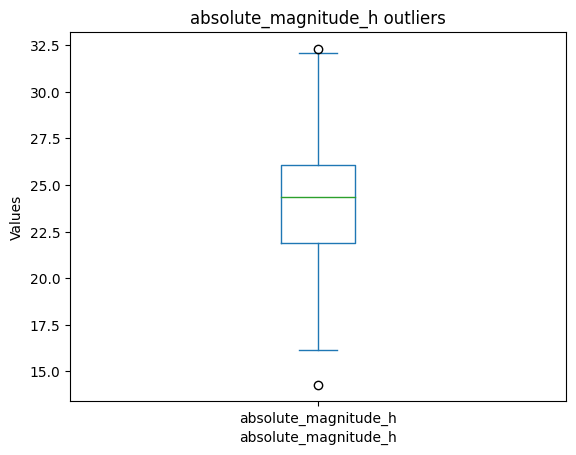

In [87]:
#Let's make sure there's no outliers for each column in neo dataset using plot(kind = 'box')
neo_dataset['absolute_magnitude_h'].plot(kind='box', xlabel='absolute_magnitude_h', ylabel='Values', 
                                   title='absolute_magnitude_h outliers')

<Axes: title={'center': 'estimated_diameter_min outliers'}, xlabel='estimated_diameter_min', ylabel='Values'>

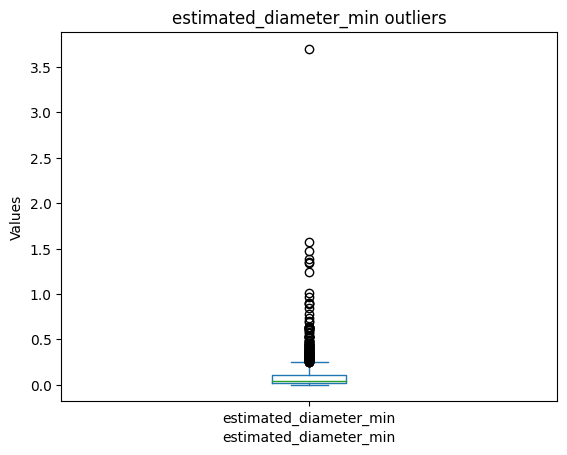

In [88]:
neo_dataset['estimated_diameter_min'].plot(kind='box', xlabel='estimated_diameter_min', ylabel='Values', 
                                   title='estimated_diameter_min outliers')

In [89]:
#intresting it seems there's an issue here, let's inspect this column
neo_dataset['estimated_diameter_min'].value_counts()

estimated_diameter_min
0.016617    9
0.024241    9
0.016016    8
0.021113    8
0.022108    7
           ..
0.217048    1
0.037545    1
0.096063    1
0.006174    1
0.060891    1
Name: count, Length: 657, dtype: int64

In [90]:
neo_dataset['estimated_diameter_min'].describe()

count    1151.000000
mean        0.101147
std         0.195857
min         0.000913
25%         0.016276
50%         0.036021
75%         0.110295
max         3.703011
Name: estimated_diameter_min, dtype: float64

it seems a most of this column values are under 0.1 that's why there's a lot of outliers, because when
calling the value_counts function most of the values that are less than 0.1 have a lot of records, 
again this is due to the merge, and with the describe method only at the quantile 4 (75%) is when 
the values of 0.1 and greater started to show up.

<Axes: title={'center': 'estimated_diameter_max outliers'}, xlabel='estimated_diameter_max', ylabel='Values'>

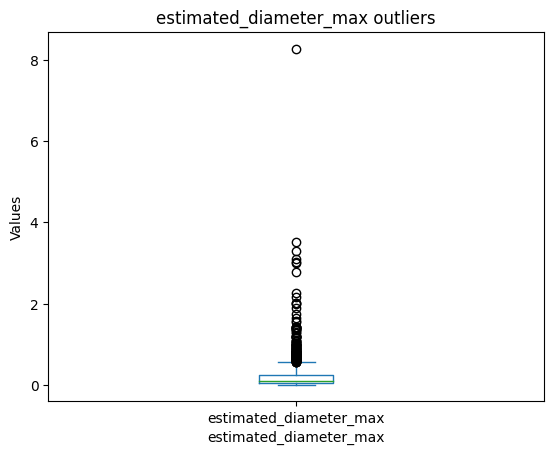

In [91]:
neo_dataset['estimated_diameter_max'].plot(kind='box', xlabel='estimated_diameter_max', ylabel='Values', 
                                   title='estimated_diameter_max outliers')

In [92]:
#let's inspect this column further.
neo_dataset['estimated_diameter_max'].sort_values()

546    0.002042
419    0.002260
940    0.003034
48     0.003927
235    0.004000
         ...   
929    3.020230
417    3.104845
40     3.296401
358    3.515928
343    8.280184
Name: estimated_diameter_max, Length: 1151, dtype: float64

In [93]:
neo_dataset['estimated_diameter_max'].value_counts()

estimated_diameter_max
0.037157    9
0.054205    9
0.035813    8
0.047211    8
0.049436    7
           ..
0.485333    1
0.083954    1
0.214803    1
0.013805    1
0.136157    1
Name: count, Length: 657, dtype: int64

In [94]:
neo_dataset['estimated_diameter_max'].describe()

count    1151.000000
mean        0.226172
std         0.437950
min         0.002042
25%         0.036395
50%         0.080545
75%         0.246627
max         8.280184
Name: estimated_diameter_max, dtype: float64

same issue here, now in the asteroid belt there are various objects that orbiting the earth ,
comets and asteroid, some them are large from 4km() to 32km, many of the objects in neo dataset 
have diameter less than 0.1 km (100 meters), so the majority of the objects' diameters falls under
100 meters.

<Axes: title={'center': 'velocity_km_s outliers'}, xlabel='velocity_km_s', ylabel='Values'>

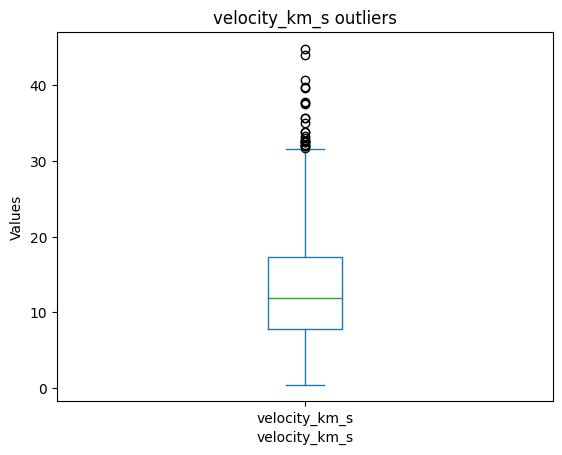

In [95]:
neo_dataset['velocity_km_s'].plot(kind='box', xlabel='velocity_km_s', ylabel='Values', 
                                   title='velocity_km_s outliers')

In [96]:
neo_dataset['velocity_km_s'].value_counts()

velocity_km_s
15.890526    1
18.029892    1
13.597655    1
12.071462    1
8.883024     1
            ..
17.401143    1
16.609985    1
12.868658    1
10.635753    1
4.119155     1
Name: count, Length: 1151, dtype: int64

In [97]:
neo_dataset['velocity_km_s'].describe()

count    1151.000000
mean       13.150541
std         7.090131
min         0.393950
25%         7.771117
50%        11.883778
75%        17.342944
max        44.866916
Name: velocity_km_s, dtype: float64

In [98]:
velocity = neo_dataset['velocity_km_s'].loc[neo_dataset['velocity_km_s'] > 35]
velocity

46      37.852110
115     43.966629
239     40.727238
258     39.592053
375     39.726161
466     37.601413
611     37.701303
913     44.866916
939     35.090640
1119    35.644483
1133    35.644483
Name: velocity_km_s, dtype: float64

The velocities of the objects in neo dataset can vary widely depending on their orbits and the 
gravitational influences they experience, most of them range between 5km to 30 km, now some of them 
may have higher velocities this could be due to their highly eccentric orbits, or those that have 
undergone gravitational slingshots around planets, so these velocities are valid.

<Axes: title={'center': 'miss_distance_km outliers'}, xlabel='miss_distance_km', ylabel='Values'>

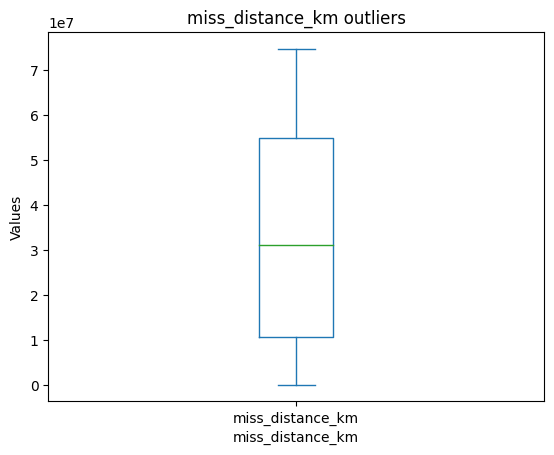

In [99]:
neo_dataset['miss_distance_km'].plot(kind='box', xlabel='miss_distance_km', ylabel='Values', 
                                   title='miss_distance_km outliers')

In [100]:
#FILL IN - Inspecting the dataframe visually
#display the first few rows 
donki_cme_dataset.head(25)

,date,halfAngle_CME,speed_CME,type_CME
0,2024-01-01,26.0,416.0,S
1,2024-01-02,40.0,617.0,C
2,2024-01-02,31.0,462.0,S
3,2024-01-02,15.0,206.0,S
4,2024-01-03,41.0,413.0,S
5,2024-01-03,33.0,383.0,S
6,2024-01-04,45.0,732.0,C
7,2024-01-04,22.0,893.0,C
8,2024-01-04,40.0,364.0,S
9,2024-01-04,10.0,384.0,S


In [101]:
#displaying the last few rows
donki_cme_dataset.tail()

,date,halfAngle_CME,speed_CME,type_CME
204,2024-02-28,43.0,730.0,C
205,2024-02-28,22.0,779.0,C
206,2024-02-29,36.0,322.0,S
207,2024-03-01,13.0,552.0,C
208,2024-03-01,40.0,263.0,S


In [102]:
#displaying a random sample
donki_cme_dataset.sample(5, random_state=2)

,date,halfAngle_CME,speed_CME,type_CME
155,2024-02-12,19.0,457.0,S
154,2024-02-12,32.0,317.0,S
35,2024-01-10,27.0,422.0,S
10,2024-01-05,22.0,552.0,C
13,2024-01-05,14.0,494.0,S


In [103]:
#Inspecting the dataframe programmatically
donki_cme_dataset.dtypes

date              object
halfAngle_CME    float64
speed_CME        float64
type_CME          object
dtype: object

In [104]:
# 'type_CME' column should be category, and it looks like 'halfAngle_CME' and 'speed_CME' columns 
#have only integer values, and date column should be in date format.

<Axes: title={'center': 'halfAngle_CME outliers'}, xlabel='halfAngle_CME', ylabel='Values'>

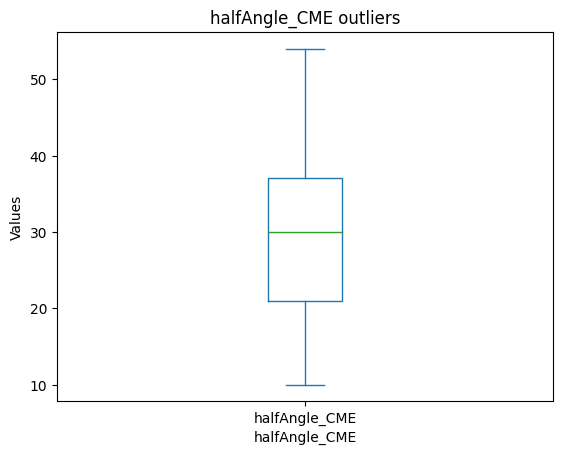

In [105]:
donki_cme_dataset['halfAngle_CME'].plot(kind='box', xlabel='halfAngle_CME', ylabel='Values', 
                                   title='halfAngle_CME outliers')

<Axes: title={'center': 'speed_CME outliers'}, xlabel='speed_CME', ylabel='Values'>

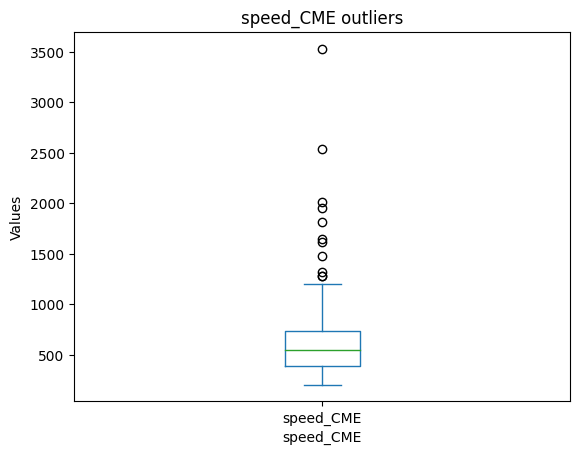

In [106]:
donki_cme_dataset['speed_CME'].plot(kind='box', xlabel='speed_CME', ylabel='Values', 
                                   title='speed_CME outliers')

In [107]:
#the speed of cme events range from 400km/s and some them can exceed 1000km/s.

<Axes: title={'center': 'TEMP outliers'}, xlabel='TEMP', ylabel='Values'>

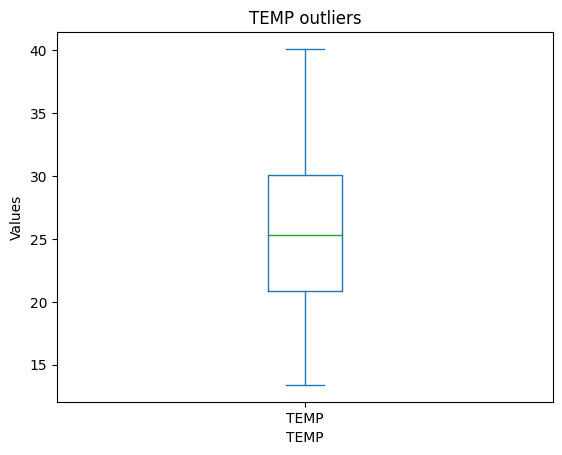

In [108]:
temp_df['TEMP'].plot(kind='box', xlabel='TEMP', ylabel='Values', 
                                   title='TEMP outliers')

<Axes: title={'center': 'SLP outliers'}, xlabel='SLP', ylabel='Values'>

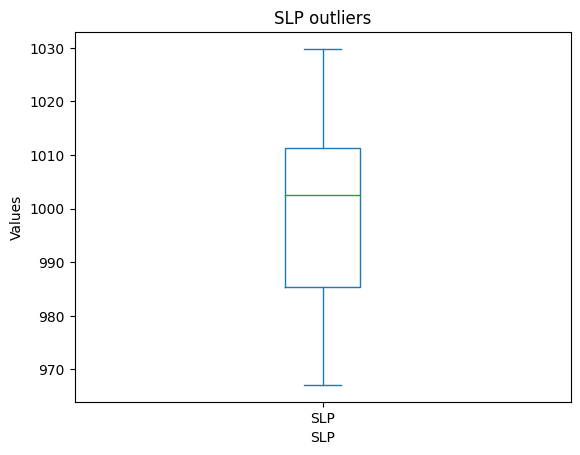

In [109]:
temp_df['SLP'].plot(kind='box', xlabel='SLP', ylabel='Values', 
                                   title='SLP outliers')

In [110]:
slp = temp_df[['date','SLP']].loc[temp_df['SLP'] < 980]
slp

,date,SLP
20,2024-01-21,967.1
21,2024-01-22,969.6
25,2024-01-26,974.8
26,2024-01-27,972.0
27,2024-01-28,976.2
52,2024-02-22,979.3
57,2024-02-27,970.9


the values of sea level pressure column can range from 980 to 1050 hPa, but sea level pressures 
between 967 and 970 hPa are relatively low but can occur, particularly in regions experiencing 
strong low-pressure systems like cyclones or intense storms.
searching in outher resourses is necessary so [The WPC sea level records for January](https://www.wpc.ncep.noaa.gov/research/roth/JanuaryRecordLowSLPs.gif) for January shows there are values below
980 hPa, and [The WPC sea level records for February](https://www.wpc.ncep.noaa.gov/research/roth/FebruaryRecordLowSLPs.gif) also has values lower than 980.

<Axes: title={'center': 'WDSP outliers'}, xlabel='WDSP', ylabel='Values'>

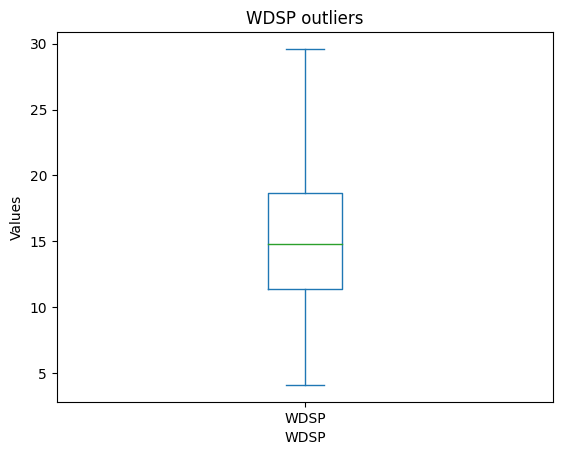

In [111]:
temp_df['WDSP'].plot(kind='box', xlabel='WDSP', ylabel='Values', 
                                   title='WDSP outliers')

In [112]:
#wind speed can range from  0.3m/s and can exceed 30 m/s in strong storms.

<Axes: title={'center': 'MXSPD outliers'}, xlabel='MXSPD', ylabel='Values'>

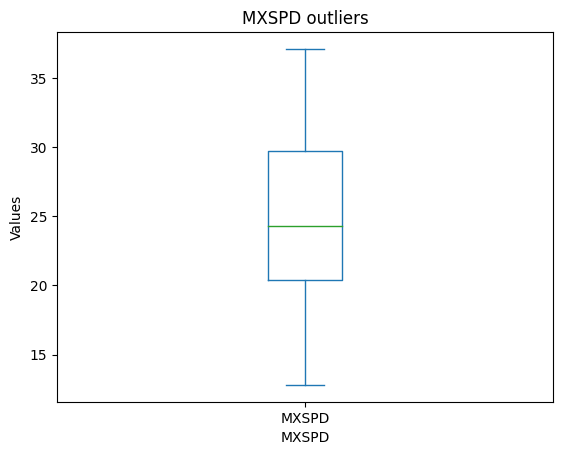

In [113]:
temp_df['MXSPD'].plot(kind='box', xlabel='MXSPD', ylabel='Values', 
                                   title='MXSPD outliers')

<Axes: title={'center': 'GUST outliers'}, xlabel='GUST', ylabel='Values'>

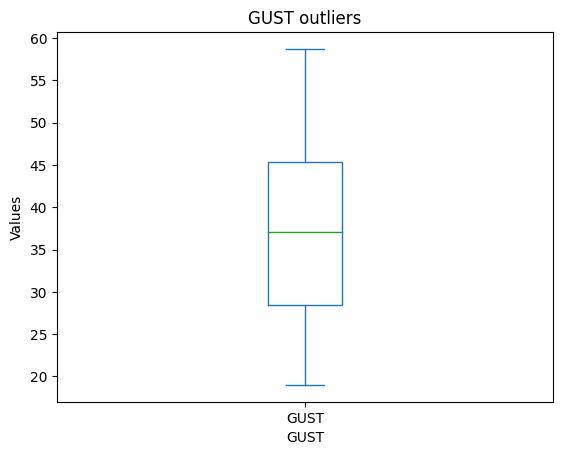

In [114]:
temp_df['GUST'].plot(kind='box', xlabel='GUST', ylabel='Values', 
                                   title='GUST outliers')

<Axes: title={'center': 'MAX temperature outliers'}, xlabel='MAX', ylabel='Values'>

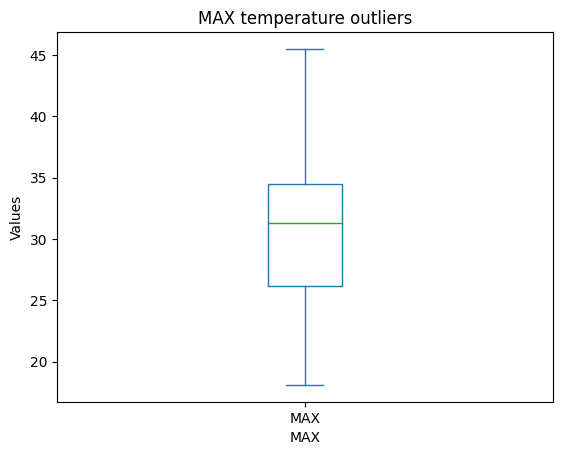

In [115]:
temp_df['MAX'].plot(kind='box', xlabel='MAX', ylabel='Values', 
                                   title='MAX temperature outliers')

<Axes: title={'center': 'MIN temperature outliers'}, xlabel='MIN', ylabel='Values'>

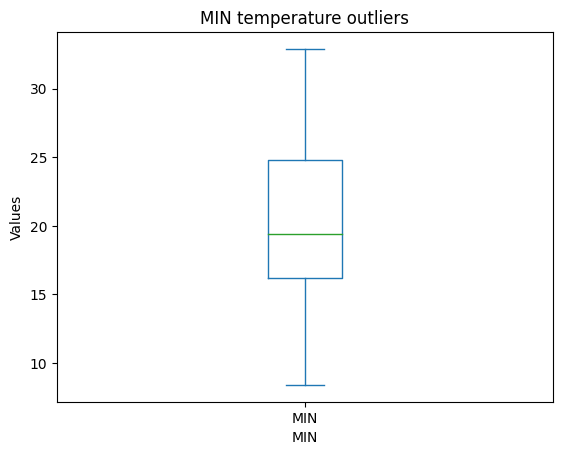

In [116]:
temp_df['MIN'].plot(kind='box', xlabel='MIN', ylabel='Values', 
                                   title='MIN temperature outliers')

### **3. Accuracy**

In [117]:
#- Inspecting the dataframe visually
#display the first few rows 
neo_dataset.head()

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
0,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07
1,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07
2,3309828,(2005 YQ96),20.62,0.199781,0.446725,2024-01-02,15.670282,2.498473e+07
3,3457842,(2009 HC21),22.10,0.101054,0.225964,2024-01-02,6.080866,7.360980e+07
4,3553062,(2010 XA11),26.10,0.016016,0.035813,2024-01-02,8.741383,3.527551e+07


In [118]:
#display the last few rows 
neo_dataset.tail()

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
1146,54426894,(2024 CX6),23.67,0.049041,0.109658,2024-03-02,16.718872,1.177312e+07
1147,54427300,(2024 DF),24.36,0.035691,0.079807,2024-03-02,10.643755,8.631646e+06
1148,54429482,(2024 ER),21.40,0.139494,0.311918,2024-03-02,12.692361,8.787370e+06
1149,54429483,(2024 ES),25.05,0.025975,0.058082,2024-03-02,6.154392,1.368924e+07
1150,54429992,(2024 EW1),26.77,0.011764,0.026305,2024-03-02,4.119155,8.089652e+06


In [119]:
#display 5 ramndom rows
neo_dataset.sample(5, random_state=2)

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
1065,54279762,(2022 KA),25.15,0.024806,0.055468,2024-02-26,7.954103,5.496205e+07
505,54423041,(2024 BH3),24.86,0.028350,0.063393,2024-02-02,7.277892,9.667724e+06
705,2482718,482718 (2013 ET9),21.10,0.160160,0.358129,2024-02-06,7.096168,6.932348e+07
61,54419817,(2024 AM3),26.60,0.012722,0.028447,2024-01-03,9.639132,2.680032e+06
512,2152742,152742 (1998 XE12),19.10,0.402305,0.899580,2024-01-28,24.948349,1.741222e+07


In [120]:
#- Inspecting the dataframe programmatically
neo_dataset.describe()

,id,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,velocity_km_s,miss_distance_km
count,1.151000e+03,1151.000000,1151.000000,1151.000000,1151.000000,1.151000e+03
mean,3.368391e+07,24.008877,0.101147,0.226172,13.150541,3.308985e+07
std,2.503064e+07,2.821170,0.195857,0.437950,7.090131,2.343208e+07
min,2.001685e+06,14.280000,0.000913,0.002042,0.393950,1.058801e+05
25%,3.741198e+06,21.910000,0.016276,0.036395,7.771117,1.061778e+07
50%,5.422611e+07,24.340000,0.036021,0.080545,11.883778,3.117233e+07
75%,5.442139e+07,26.065000,0.110295,0.246627,17.342944,5.489757e+07
max,5.444740e+07,32.320000,3.703011,8.280184,44.866916,7.468203e+07


<Axes: title={'center': 'absolute_magnitude_h frequency'}, xlabel='absolute_magnitude_h', ylabel='frequency'>

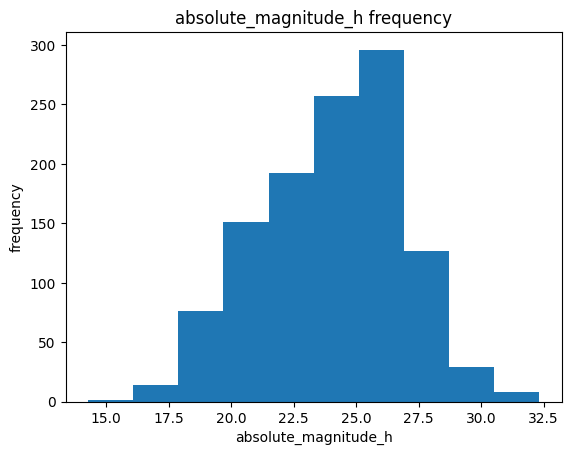

In [121]:
neo_dataset['absolute_magnitude_h'].plot(kind='hist', title='absolute_magnitude_h frequency',
                                        xlabel = 'absolute_magnitude_h', ylabel='frequency')

<Axes: title={'center': 'estimated_diameter_min frequency'}, xlabel='estimated_diameter_min', ylabel='frequency'>

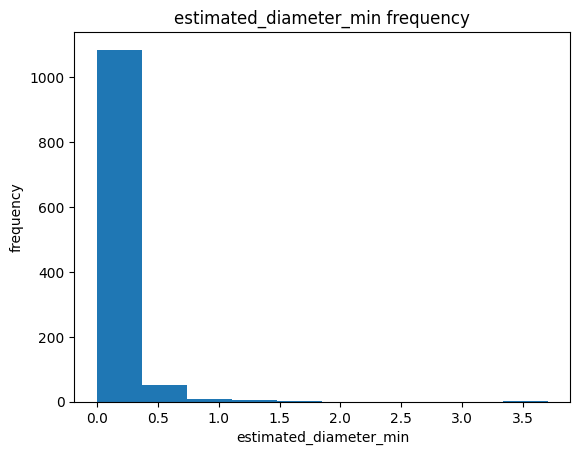

In [122]:
neo_dataset['estimated_diameter_min'].plot(kind='hist', title='estimated_diameter_min frequency',
                                        xlabel = 'estimated_diameter_min', ylabel='frequency')

<Axes: title={'center': 'estimated_diameter_max frequency'}, xlabel='estimated_diameter_max', ylabel='frequency'>

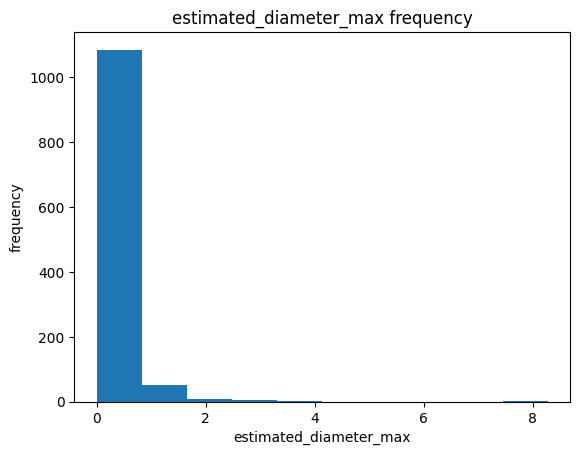

In [123]:
neo_dataset['estimated_diameter_max'].plot(kind='hist', title='estimated_diameter_max frequency',
                                        xlabel = 'estimated_diameter_max', ylabel='frequency')

<Axes: title={'center': 'velocity_km_s frequency'}, xlabel='velocity_km_s', ylabel='frequency'>

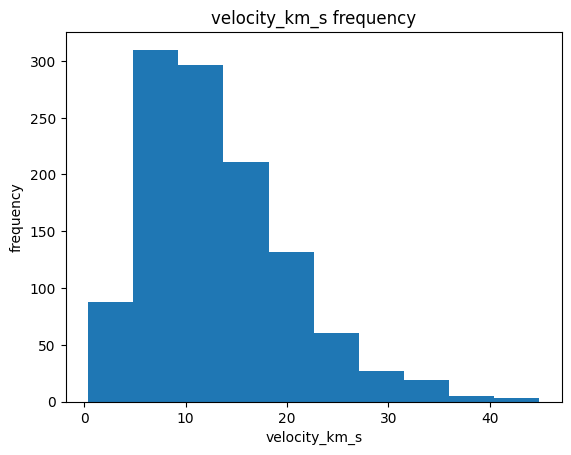

In [124]:
neo_dataset['velocity_km_s'].plot(kind='hist', title='velocity_km_s frequency',
                                        xlabel = 'velocity_km_s', ylabel='frequency')

<Axes: title={'center': 'miss_distance_km frequency'}, xlabel='miss_distance_km', ylabel='frequency'>

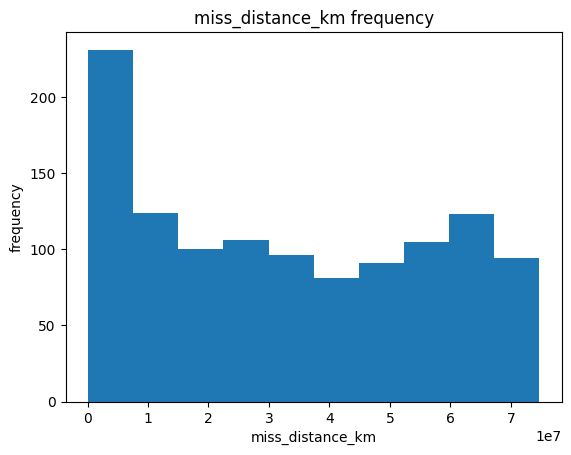

In [125]:
neo_dataset['miss_distance_km'].plot(kind='hist', title='miss_distance_km frequency',
                                        xlabel = 'miss_distance_km', ylabel='frequency')

In [126]:
#- Inspecting the dataframe visually
#display the first few rows 
donki_cme_dataset.head()

,date,halfAngle_CME,speed_CME,type_CME
0,2024-01-01,26.0,416.0,S
1,2024-01-02,40.0,617.0,C
2,2024-01-02,31.0,462.0,S
3,2024-01-02,15.0,206.0,S
4,2024-01-03,41.0,413.0,S


In [127]:
#display the last few rows 
donki_cme_dataset.tail()

,date,halfAngle_CME,speed_CME,type_CME
204,2024-02-28,43.0,730.0,C
205,2024-02-28,22.0,779.0,C
206,2024-02-29,36.0,322.0,S
207,2024-03-01,13.0,552.0,C
208,2024-03-01,40.0,263.0,S


In [128]:
#display 5 ramndom rows
donki_cme_dataset.sample(5, random_state=2)

,date,halfAngle_CME,speed_CME,type_CME
155,2024-02-12,19.0,457.0,S
154,2024-02-12,32.0,317.0,S
35,2024-01-10,27.0,422.0,S
10,2024-01-05,22.0,552.0,C
13,2024-01-05,14.0,494.0,S


In [129]:
#- Inspecting the dataframe programmatically
donki_cme_dataset.describe()

,halfAngle_CME,speed_CME
count,209.000000,209.000000
mean,29.416268,627.559809
std,10.576822,393.975909
min,10.000000,206.000000
25%,21.000000,389.000000
50%,30.000000,552.000000
75%,37.000000,732.000000
max,54.000000,3529.000000


<Axes: title={'center': 'halfAngle_CME frequency'}, xlabel='halfAngle_CME', ylabel='frequency'>

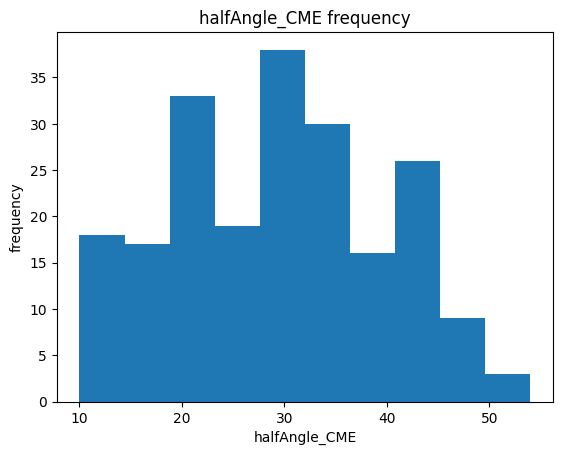

In [130]:
donki_cme_dataset['halfAngle_CME'].plot(kind='hist', title='halfAngle_CME frequency',
                                        xlabel = 'halfAngle_CME', ylabel='frequency')

<Axes: title={'center': 'speed_CME frequency'}, xlabel='speed_CME', ylabel='frequency'>

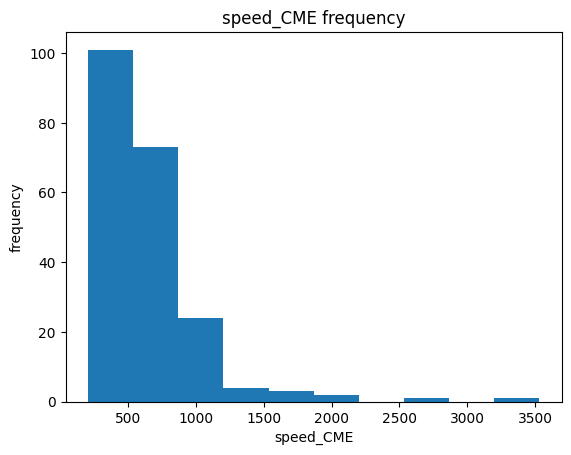

In [131]:
donki_cme_dataset['speed_CME'].plot(kind='hist', title='speed_CME frequency',
                                        xlabel = 'speed_CME', ylabel='frequency')

In [132]:
#- Inspecting the dataframe visually
#display the first few rows 
donki_flr_dataset.head()

,date,classType_FLR
0,2024-01-01,M2.3
1,2024-01-01,M4.7
2,2024-01-02,M1.1
3,2024-01-04,M1.1
4,2024-01-04,M3.8


In [133]:
#display the last few rows 
donki_flr_dataset.tail()

,date,classType_FLR
106,2024-02-24,M3.6
107,2024-02-24,M1.0
108,2024-02-25,M2.0
109,2024-02-28,C5.1
110,2024-02-28,M1.5


In [134]:
#display 5 ramndom rows
donki_flr_dataset.sample(5, random_state=2)

,date,classType_FLR
14,2024-01-11,M1.5
13,2024-01-11,M1.3
21,2024-01-22,M1.5
2,2024-01-02,M1.1
44,2024-01-24,M1.3


In [135]:
#- Inspecting the dataframe programmatically
donki_flr_dataset.describe()

,date,classType_FLR
count,111,111
unique,38,54
top,2024-01-23,M1.0
freq,12,12


In [136]:
#- Inspecting the dataframe visually
#display the first few rows 
temp_df.head()

,date,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
1,2024-01-02,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
2,2024-01-03,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
3,2024-01-04,19.5,1010.4,17.5,25.6,32.1,28.8,14.7
4,2024-01-05,20.6,1010.3,11.9,22.0,31.9,26.6,16.0
5,2024-01-06,20.6,1016.2,7.4,20.8,25.4,22.8,16.0


In [137]:
#display the last few rows 
temp_df.tail()

,date,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
57,2024-02-27,32.5,970.9,6.5,29.3,37.3,36.3,27.7
58,2024-02-28,13.4,981.2,22.0,37.1,55.9,33.8,8.4
59,2024-02-29,14.8,988.7,11.9,21.0,35.0,18.1,10.2
60,2024-03-01,22.3,999.0,24.2,32.2,44.3,26.4,15.3
61,2024-03-02,23.1,1016.6,12.8,26.0,39.0,25.0,19.4


In [138]:
temp_df.sample(5,random_state=2)

,date,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
37,2024-02-07,26.4,1009.2,18.7,24.3,35.4,30.6,23.9
1,2024-01-02,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
48,2024-02-18,28.6,1014.3,4.1,14.2,19.0,31.6,21.7
57,2024-02-27,32.5,970.9,6.5,29.3,37.3,36.3,27.7
24,2024-01-25,34.9,984.6,16.6,28.9,38.1,37.4,32.4


In [139]:
#- Inspecting the dataframe programmatically
temp_df.describe()

,date,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
count,61,61.000000,61.000000,61.000000,61.000000,61.000000,61.000000,61.000000
mean,2024-02-01 00:00:00,25.516393,999.139344,15.459016,24.862295,36.952459,30.324590,20.463934
min,2024-01-02 00:00:00,13.400000,967.100000,4.100000,12.800000,19.000000,18.100000,8.400000
25%,2024-01-17 00:00:00,20.900000,985.400000,11.400000,20.400000,28.400000,26.200000,16.200000
50%,2024-02-01 00:00:00,25.300000,1002.500000,14.800000,24.300000,37.100000,31.300000,19.400000
75%,2024-02-16 00:00:00,30.100000,1011.400000,18.700000,29.700000,45.300000,34.500000,24.800000
max,2024-03-02 00:00:00,40.100000,1029.800000,29.600000,37.100000,58.700000,45.500000,32.900000
std,NaN,6.255429,16.024172,5.879155,6.381932,10.101743,5.968435,6.503333


<Axes: title={'center': 'TEMP frequency'}, xlabel='TEMP', ylabel='frequency'>

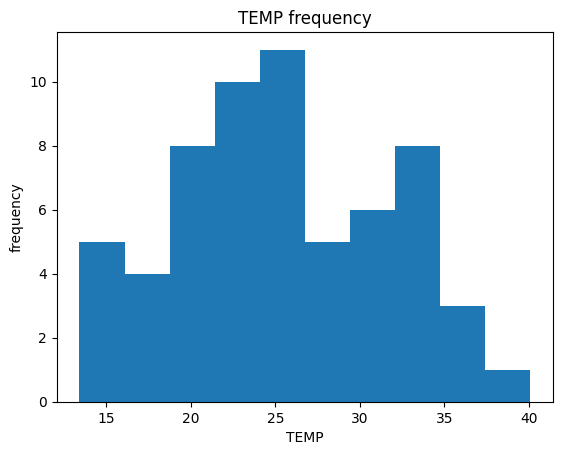

In [140]:
temp_df['TEMP'].plot(kind='hist', title='TEMP frequency',
                                        xlabel = 'TEMP', ylabel='frequency')

<Axes: title={'center': 'SLP frequency'}, xlabel='SLP', ylabel='frequency'>

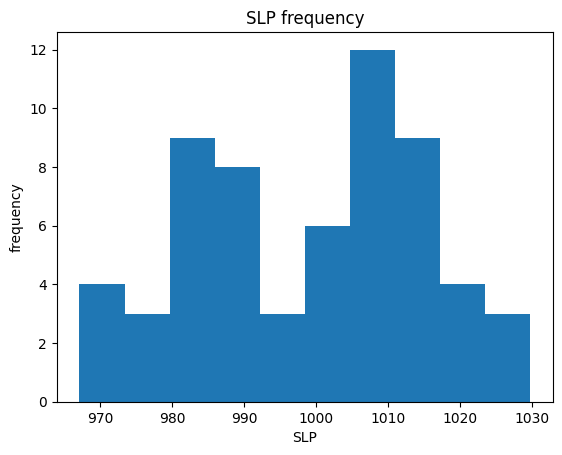

In [141]:
temp_df['SLP'].plot(kind='hist', title='SLP frequency',
                                        xlabel = 'SLP', ylabel='frequency')

<Axes: title={'center': 'WDSP frequency'}, xlabel='WDSP', ylabel='frequency'>

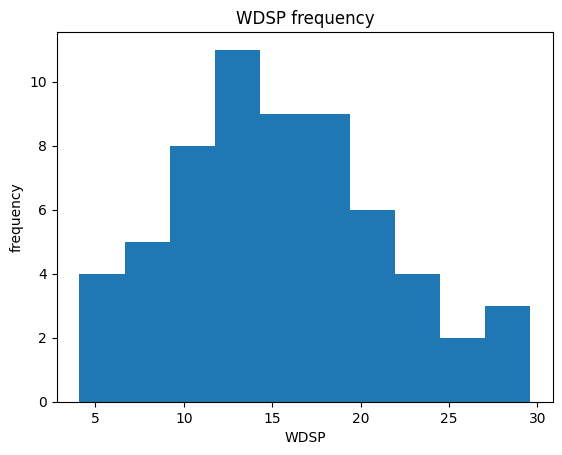

In [142]:
temp_df['WDSP'].plot(kind='hist', title='WDSP frequency',
                                        xlabel = 'WDSP', ylabel='frequency')

<Axes: title={'center': 'MXSPD frequency'}, xlabel='MXSPD', ylabel='frequency'>

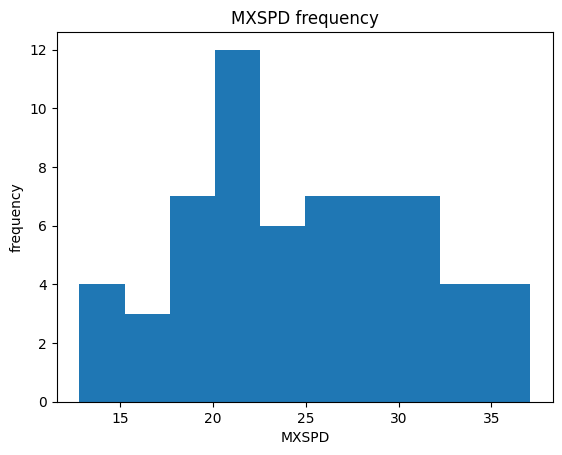

In [143]:
temp_df['MXSPD'].plot(kind='hist', title='MXSPD frequency',
                                        xlabel = 'MXSPD', ylabel='frequency')

<Axes: title={'center': 'GUST frequency'}, xlabel='GUST', ylabel='frequency'>

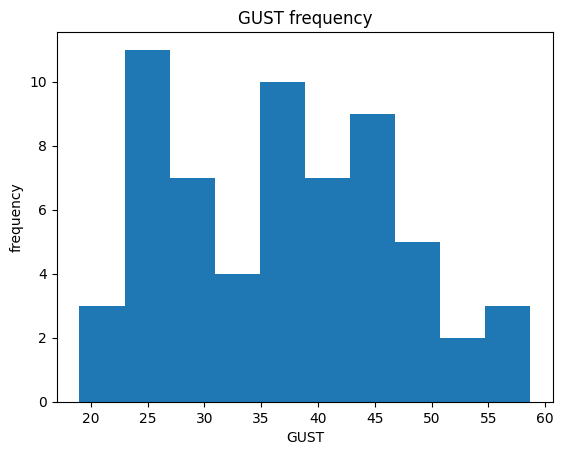

In [144]:
temp_df['GUST'].plot(kind='hist', title='GUST frequency',
                                        xlabel = 'GUST', ylabel='frequency')

<Axes: title={'center': 'MAX frequency'}, xlabel='MAX', ylabel='frequency'>

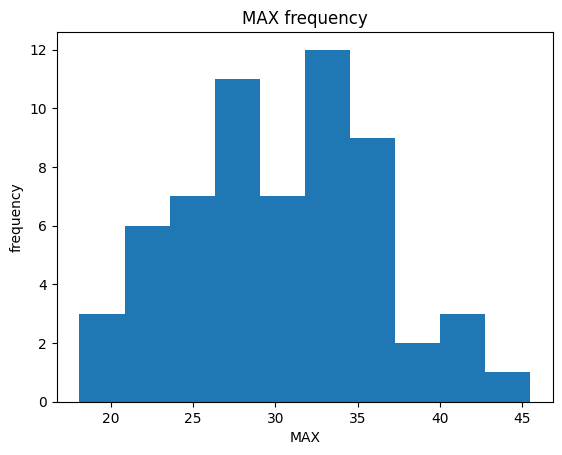

In [145]:
temp_df['MAX'].plot(kind='hist', title='MAX frequency',
                                        xlabel = 'MAX', ylabel='frequency')

<Axes: title={'center': 'MIN frequency'}, xlabel='MIN', ylabel='frequency'>

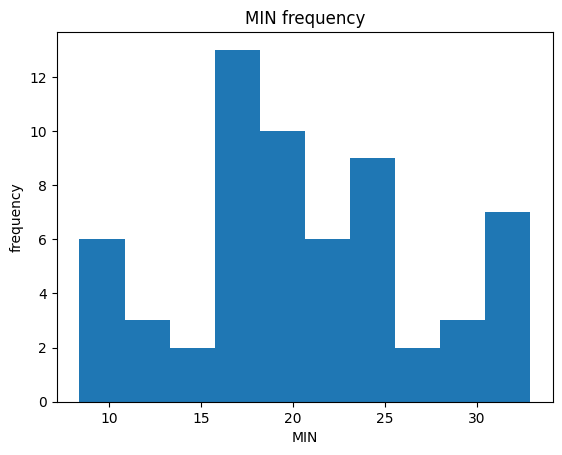

In [146]:
temp_df['MIN'].plot(kind='hist', title='MIN frequency',
                                        xlabel = 'MIN', ylabel='frequency')

In [147]:
#last but not least the column's values 'MXSPD'  are always greater than 'WDSP',
#so let's check if there's a value in 'WDSP' greater than 'MXSPD' on the same day
mxspd = temp_df.loc[temp_df['WDSP'] > temp_df['MXSPD']]
mxspd

,date,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN


### **3. Uniqueness**
Are there any duplicates?

In [148]:
#- Inspecting the dataframe visually
#display the first few rows 
neo_dataset.head()

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
0,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07
1,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07
2,3309828,(2005 YQ96),20.62,0.199781,0.446725,2024-01-02,15.670282,2.498473e+07
3,3457842,(2009 HC21),22.10,0.101054,0.225964,2024-01-02,6.080866,7.360980e+07
4,3553062,(2010 XA11),26.10,0.016016,0.035813,2024-01-02,8.741383,3.527551e+07


In [149]:
#display the last few rows 
neo_dataset.tail()

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
1146,54426894,(2024 CX6),23.67,0.049041,0.109658,2024-03-02,16.718872,1.177312e+07
1147,54427300,(2024 DF),24.36,0.035691,0.079807,2024-03-02,10.643755,8.631646e+06
1148,54429482,(2024 ER),21.40,0.139494,0.311918,2024-03-02,12.692361,8.787370e+06
1149,54429483,(2024 ES),25.05,0.025975,0.058082,2024-03-02,6.154392,1.368924e+07
1150,54429992,(2024 EW1),26.77,0.011764,0.026305,2024-03-02,4.119155,8.089652e+06


In [150]:
#display 5 ramndom rows
neo_dataset.sample(5, random_state=2)

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
1065,54279762,(2022 KA),25.15,0.024806,0.055468,2024-02-26,7.954103,5.496205e+07
505,54423041,(2024 BH3),24.86,0.028350,0.063393,2024-02-02,7.277892,9.667724e+06
705,2482718,482718 (2013 ET9),21.10,0.160160,0.358129,2024-02-06,7.096168,6.932348e+07
61,54419817,(2024 AM3),26.60,0.012722,0.028447,2024-01-03,9.639132,2.680032e+06
512,2152742,152742 (1998 XE12),19.10,0.402305,0.899580,2024-01-28,24.948349,1.741222e+07


In [151]:
#- Inspecting the dataframe programmatically
#Access the duplicated rows for duplicates in the Name and Age column
duplicates = neo_dataset.loc[neo_dataset.duplicated()]
duplicates

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km


In [152]:
#it seems that there's no duplicates here

In [153]:
#- Inspecting the dataframe visually
#display the first few rows 
donki_cme_dataset.head()

,date,halfAngle_CME,speed_CME,type_CME
0,2024-01-01,26.0,416.0,S
1,2024-01-02,40.0,617.0,C
2,2024-01-02,31.0,462.0,S
3,2024-01-02,15.0,206.0,S
4,2024-01-03,41.0,413.0,S


In [154]:
#display the last few rows 
donki_cme_dataset.tail()

,date,halfAngle_CME,speed_CME,type_CME
204,2024-02-28,43.0,730.0,C
205,2024-02-28,22.0,779.0,C
206,2024-02-29,36.0,322.0,S
207,2024-03-01,13.0,552.0,C
208,2024-03-01,40.0,263.0,S


In [155]:
#display 5 ramndom rows
donki_cme_dataset.sample(5, random_state=2)

,date,halfAngle_CME,speed_CME,type_CME
155,2024-02-12,19.0,457.0,S
154,2024-02-12,32.0,317.0,S
35,2024-01-10,27.0,422.0,S
10,2024-01-05,22.0,552.0,C
13,2024-01-05,14.0,494.0,S


In [156]:
#- Inspecting the dataframe programmatically
donki_cme_dataset.duplicated().sum()

0

In [157]:
#- Inspecting the dataframe visually
#display the first few rows 
donki_flr_dataset.head()

,date,classType_FLR
0,2024-01-01,M2.3
1,2024-01-01,M4.7
2,2024-01-02,M1.1
3,2024-01-04,M1.1
4,2024-01-04,M3.8


In [158]:
#display the last few rows 
donki_flr_dataset.tail()

,date,classType_FLR
106,2024-02-24,M3.6
107,2024-02-24,M1.0
108,2024-02-25,M2.0
109,2024-02-28,C5.1
110,2024-02-28,M1.5


In [159]:
#display 5 ramndom rows
donki_flr_dataset.sample(5, random_state=2)

,date,classType_FLR
14,2024-01-11,M1.5
13,2024-01-11,M1.3
21,2024-01-22,M1.5
2,2024-01-02,M1.1
44,2024-01-24,M1.3


In [160]:
#- Inspecting the dataframe programmatically
donki_flr_dataset.duplicated().sum()

5

In [161]:
dupl_flr = donki_flr_dataset.loc[donki_flr_dataset.duplicated()]
dupl_flr

,date,classType_FLR
36,2024-01-23,M1.0
38,2024-01-23,M1.0
39,2024-01-23,M1.0
87,2024-02-14,M1.0
102,2024-02-23,M1.0


In [162]:
#we should remove these rows

In [163]:
#- Inspecting the dataframe visually
#display the first few rows 
temp_df.head()

,date,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
1,2024-01-02,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
2,2024-01-03,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
3,2024-01-04,19.5,1010.4,17.5,25.6,32.1,28.8,14.7
4,2024-01-05,20.6,1010.3,11.9,22.0,31.9,26.6,16.0
5,2024-01-06,20.6,1016.2,7.4,20.8,25.4,22.8,16.0


In [164]:
#display the last few rows 
temp_df.tail()

,date,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
57,2024-02-27,32.5,970.9,6.5,29.3,37.3,36.3,27.7
58,2024-02-28,13.4,981.2,22.0,37.1,55.9,33.8,8.4
59,2024-02-29,14.8,988.7,11.9,21.0,35.0,18.1,10.2
60,2024-03-01,22.3,999.0,24.2,32.2,44.3,26.4,15.3
61,2024-03-02,23.1,1016.6,12.8,26.0,39.0,25.0,19.4


In [165]:
#display 5 ramndom rows
temp_df.sample(5, random_state=2)

,date,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
37,2024-02-07,26.4,1009.2,18.7,24.3,35.4,30.6,23.9
1,2024-01-02,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
48,2024-02-18,28.6,1014.3,4.1,14.2,19.0,31.6,21.7
57,2024-02-27,32.5,970.9,6.5,29.3,37.3,36.3,27.7
24,2024-01-25,34.9,984.6,16.6,28.9,38.1,37.4,32.4


In [166]:
#- Inspecting the dataframe programmatically
temp_df.duplicated().sum()

0

### **4. Consistency**
Are all the units united?

In [167]:
neo_dataset.head(10)

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
0,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07
1,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07
2,3309828,(2005 YQ96),20.62,0.199781,0.446725,2024-01-02,15.670282,2.498473e+07
3,3457842,(2009 HC21),22.10,0.101054,0.225964,2024-01-02,6.080866,7.360980e+07
4,3553062,(2010 XA11),26.10,0.016016,0.035813,2024-01-02,8.741383,3.527551e+07
5,3591616,(2011 YP10),23.94,0.043307,0.096837,2024-01-02,5.807002,1.054515e+07
6,3608936,(2012 SD22),20.05,0.259750,0.580818,2024-01-02,11.022794,2.459731e+07
7,3795154,(2017 YD8),21.87,0.112345,0.251212,2024-01-02,18.993643,3.010768e+07
8,3842680,(2019 KK5),22.79,0.073545,0.164452,2024-01-02,20.833130,3.904097e+06
9,2613286,613286 (2005 YQ96),20.63,0.198863,0.444672,2024-01-02,15.670290,2.498480e+07


In [168]:
#let's check the tail
neo_dataset.tail(10)

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
1141,3674864,(2014 OG1),21.72,0.120380,0.269178,2024-03-02,19.594015,4.499388e+07
1142,3693428,(2014 UR),26.60,0.012722,0.028447,2024-03-02,12.982130,5.828716e+07
1143,54117581,(2021 CM7),21.10,0.160160,0.358129,2024-03-02,25.694403,5.877195e+07
1144,54184281,(2021 PC7),19.39,0.352010,0.787118,2024-03-02,25.772583,6.239712e+07
1145,54200470,(2021 SD3),25.12,0.025151,0.056239,2024-03-02,5.198609,1.905772e+07
1146,54426894,(2024 CX6),23.67,0.049041,0.109658,2024-03-02,16.718872,1.177312e+07
1147,54427300,(2024 DF),24.36,0.035691,0.079807,2024-03-02,10.643755,8.631646e+06
1148,54429482,(2024 ER),21.40,0.139494,0.311918,2024-03-02,12.692361,8.787370e+06
1149,54429483,(2024 ES),25.05,0.025975,0.058082,2024-03-02,6.154392,1.368924e+07
1150,54429992,(2024 EW1),26.77,0.011764,0.026305,2024-03-02,4.119155,8.089652e+06


In [169]:
neo_dataset.sample(5, random_state=2)

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
1065,54279762,(2022 KA),25.15,0.024806,0.055468,2024-02-26,7.954103,5.496205e+07
505,54423041,(2024 BH3),24.86,0.028350,0.063393,2024-02-02,7.277892,9.667724e+06
705,2482718,482718 (2013 ET9),21.10,0.160160,0.358129,2024-02-06,7.096168,6.932348e+07
61,54419817,(2024 AM3),26.60,0.012722,0.028447,2024-01-03,9.639132,2.680032e+06
512,2152742,152742 (1998 XE12),19.10,0.402305,0.899580,2024-01-28,24.948349,1.741222e+07


in the neo dataframe the columns (estimated_diameter_min, 
estimated_diameter_max, velocity_km_s,miss_distance_km) in cme_donki dataframe
(speed_CME) are in kilometers per second but
the columns (WDSP, GUST, MXSPD) are in meters per seconds

### *Tidiness Issues*:

###  1. Multiple types of observational units are stored in the same table
Near objects dataset has data about objects in the asteroid belt well there are more than one object on every day in the dataset and also when we merged the neo_donki dataset that has space events some dates have both FLR and CME other has only FLR and the other has only CME so it's pretty confusing to have all these information in one table.
* First observational unit is neo dataset that has data about different objects in the asteroid belt with some information about each object on that date.
* Second observational unit is the dataset that has information about FLR and CME events in days from 02-01-2024 to 02-03-2024 and some information about each event on that day, note that several events can happen in the same day.
* Third observational unit is the dataset that has daily temperature, and other earth weather information.

So the best option here is to seperate each observationl unit into three tables, and whenever there's the need to merge these 3 tables, merging through the variable date is the solution.


In [170]:
#FILL IN - Inspecting the dataframe visually
#display the first few rows 
df_com.head()

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km,classType_FLR,halfAngle_CME,speed_CME,type_CME,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
0,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07,M1.1,40.0,617.0,C,20.9,986.9,13.0,22.7,41.4,24.1,18.0
1,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07,M1.1,31.0,462.0,S,20.9,986.9,13.0,22.7,41.4,24.1,18.0
2,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07,M1.1,15.0,206.0,S,20.9,986.9,13.0,22.7,41.4,24.1,18.0
3,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07,M1.1,40.0,617.0,C,20.9,986.9,13.0,22.7,41.4,24.1,18.0
4,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07,M1.1,31.0,462.0,S,20.9,986.9,13.0,22.7,41.4,24.1,18.0


In [171]:
#display the last few rows 
df_com.tail()

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km,classType_FLR,halfAngle_CME,speed_CME,type_CME,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
7704,54431498,(2024 FE1),26.13,0.015796,0.035322,2024-03-01,6.006097,6.071125e+06,NaN,40.0,263.0,S,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
7705,54431500,(2024 FH1),25.72,0.019079,0.042662,2024-03-01,4.491427,5.728611e+06,NaN,13.0,552.0,C,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
7706,54431500,(2024 FH1),25.72,0.019079,0.042662,2024-03-01,4.491427,5.728611e+06,NaN,40.0,263.0,S,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
7707,2678989,678989 (2018 GY4),19.06,0.409784,0.916305,2024-03-01,35.644483,6.728181e+07,NaN,13.0,552.0,C,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
7708,2678989,678989 (2018 GY4),19.06,0.409784,0.916305,2024-03-01,35.644483,6.728181e+07,NaN,40.0,263.0,S,29.7,1006.9,14.0,22.5,30.1,34.3,25.3


In [172]:
#display 5 ramndom rows
df_com.sample(5, random_state=2)

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km,classType_FLR,halfAngle_CME,speed_CME,type_CME,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
5964,54246616,(2022 CK6),26.58,0.012840,0.028710,2024-02-14,12.071462,2.300942e+07,M1.0,39.0,341.0,S,22.5,998.7,21.3,35.2,48.4,31.3,19.0
6070,3989097,(2020 BR5),25.50,0.021113,0.047211,2024-02-13,15.444092,6.287856e+07,C5.0,18.0,791.0,C,32.2,992.6,16.6,31.7,50.5,35.2,27.1
1837,3795107,(2017 YL6),22.69,0.077011,0.172203,2024-01-23,16.350491,3.300810e+07,M4.3,42.0,613.0,C,26.3,982.2,14.2,24.9,46.0,31.5,21.4
5195,3841201,(2019 GO20),19.32,0.363542,0.812905,2024-01-30,14.948663,4.833021e+07,C1.9,18.0,563.0,C,25.5,986.2,15.0,24.3,31.5,28.9,19.4
3072,54423053,(2024 BV3),26.79,0.011656,0.026064,2024-01-23,12.823610,3.436067e+06,M2.3,20.0,696.0,C,26.3,982.2,14.2,24.9,46.0,31.5,21.4


In [173]:
#FILL IN - Inspecting the dataframe programmatically
df_com.nunique()

id                        890
name                      890
absolute_magnitude_h      566
estimated_diameter_min    566
estimated_diameter_max    566
date                       47
velocity_km_s             891
miss_distance_km          890
classType_FLR              47
halfAngle_CME              39
speed_CME                 137
type_CME                    4
TEMP                       45
SLP                        42
WDSP                       43
MXSPD                      43
GUST                       46
MAX                        40
MIN                        39
dtype: int64

Issue and justification:the unique values in this table are few comparing to the total records in this table so there are so many values in many columns are being repeated ,I used them as four separate tables in assesing stage, when needed i will use the combined dataset.

### 2. Multiple variables are stored in one column
Investigate the `name` column programmatically using the `.describe()` and `.value_counts()` functionality, what are the values in this column?

In [174]:
#FILL IN - Inspecting the dataframe visually
#display the first few rows 
neo_dataset.head()

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
0,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07
1,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07
2,3309828,(2005 YQ96),20.62,0.199781,0.446725,2024-01-02,15.670282,2.498473e+07
3,3457842,(2009 HC21),22.10,0.101054,0.225964,2024-01-02,6.080866,7.360980e+07
4,3553062,(2010 XA11),26.10,0.016016,0.035813,2024-01-02,8.741383,3.527551e+07


In [175]:
#display the last few rows 
neo_dataset.tail()

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
1146,54426894,(2024 CX6),23.67,0.049041,0.109658,2024-03-02,16.718872,1.177312e+07
1147,54427300,(2024 DF),24.36,0.035691,0.079807,2024-03-02,10.643755,8.631646e+06
1148,54429482,(2024 ER),21.40,0.139494,0.311918,2024-03-02,12.692361,8.787370e+06
1149,54429483,(2024 ES),25.05,0.025975,0.058082,2024-03-02,6.154392,1.368924e+07
1150,54429992,(2024 EW1),26.77,0.011764,0.026305,2024-03-02,4.119155,8.089652e+06


In [176]:
#display 5 ramndom rows
neo_dataset.sample(5, random_state=2)

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
1065,54279762,(2022 KA),25.15,0.024806,0.055468,2024-02-26,7.954103,5.496205e+07
505,54423041,(2024 BH3),24.86,0.028350,0.063393,2024-02-02,7.277892,9.667724e+06
705,2482718,482718 (2013 ET9),21.10,0.160160,0.358129,2024-02-06,7.096168,6.932348e+07
61,54419817,(2024 AM3),26.60,0.012722,0.028447,2024-01-03,9.639132,2.680032e+06
512,2152742,152742 (1998 XE12),19.10,0.402305,0.899580,2024-01-28,24.948349,1.741222e+07


In [177]:
#FILL IN - Inspecting the dataframe programmatically
neo_dataset['name'].describe()

count            1151
unique           1150
top       (2008 WZ94)
freq                2
Name: name, dtype: object

In [178]:
neo_dataset['name'].value_counts()

name
(2008 WZ94)           2
415949 (2001 XY10)    1
(2017 FU158)          1
(2023 TC)             1
(2023 SG7)            1
                     ..
(2024 BW3)            1
(2024 BY3)            1
(2024 BN4)            1
(2024 CV2)            1
(2024 EW1)            1
Name: count, Length: 1150, dtype: int64

Issue and justification: *The values in the column 'name' mostly have this format (yyyy letters) the year indicates the year that that object was discovered and the letters A to Y represent the 24 half-month periods (e.g., January 1-15 is A, January 16-31 is B, etc.).
some values in 'name' column may have a number like "415949 (2001 XY10)"  this number '415949' is the catalog number assigned to the object after its orbit has been well-determined.*
**so maybe i would extract the year for exploring stage's sake**

## 3. Clean data
Clean the data to solve the 4 issues corresponding to data quality and tidiness found in the assessing step. **Make sure you include justifications for your cleaning decisions.**

After the cleaning for each issue, please use **either** the visually or programatical method to validate the cleaning was succesful.

At this stage, you are also expected to remove variables that are unnecessary for your analysis and combine your datasets. Depending on your datasets, you may choose to perform variable combination and elimination before or after the cleaning stage. Your dataset must have **at least** 4 variables after combining the data.

It doesn't make sense to remove unwanted variables in this late stage......, like i wouldn't bother myself doing all this assesing if i know i don't want this column, so i already had done that.

In [179]:
#for unknown reasen dataframe.copy() didn't work and it gave me NoneType.
neo_cleaned = pd.DataFrame(neo_dataset)
cme_cleaned = pd.DataFrame(donki_cme_dataset)
flr_cleaned = pd.DataFrame(donki_flr_dataset)
temp_cleaned = pd.DataFrame(temp_df)

In [180]:
type(neo_cleaned)

pandas.core.frame.DataFrame

### **Quality Issue 1. Validity**

In [181]:

neo_cleaned.rename(columns={'close_approach_date':'date'}, inplace=True)
neo_cleaned

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km
0,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07
1,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07
2,3309828,(2005 YQ96),20.62,0.199781,0.446725,2024-01-02,15.670282,2.498473e+07
3,3457842,(2009 HC21),22.10,0.101054,0.225964,2024-01-02,6.080866,7.360980e+07
4,3553062,(2010 XA11),26.10,0.016016,0.035813,2024-01-02,8.741383,3.527551e+07
...,...,...,...,...,...,...,...,...
1146,54426894,(2024 CX6),23.67,0.049041,0.109658,2024-03-02,16.718872,1.177312e+07
1147,54427300,(2024 DF),24.36,0.035691,0.079807,2024-03-02,10.643755,8.631646e+06
1148,54429482,(2024 ER),21.40,0.139494,0.311918,2024-03-02,12.692361,8.787370e+06
1149,54429483,(2024 ES),25.05,0.025975,0.058082,2024-03-02,6.154392,1.368924e+07


In [182]:
neo_cleaned['date'] = pd.to_datetime(neo_cleaned['date'])


In [183]:
neo_cleaned.drop('id', axis = 1, inplace=True)

In [184]:
#Validate the cleaning was successful
neo_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1151 entries, 0 to 1150
Data columns (total 7 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   name                    1151 non-null   object        
 1   absolute_magnitude_h    1151 non-null   float64       
 2   estimated_diameter_min  1151 non-null   float64       
 3   estimated_diameter_max  1151 non-null   float64       
 4   date                    1151 non-null   datetime64[ns]
 5   velocity_km_s           1151 non-null   float64       
 6   miss_distance_km        1151 non-null   float64       
dtypes: datetime64[ns](1), float64(5), object(1)
memory usage: 63.1+ KB


Justification: 
* For neo dataset the cleaning strategy is to convert date from string type to date format,
* no need for id column in my research, 
* and lastly changing the name of 'close_approach_date' to 'date' for making combinig datasets easy.

### **Quality Issue 2: Uniqueness**

In [185]:
#Apply the cleaning strategy, the only dataset with duplicates is donki_flr_dataset
#dropping the duplicated rows
flr_cleaned = flr_cleaned.drop_duplicates()


In [186]:
dupl_flr

,date,classType_FLR
36,2024-01-23,M1.0
38,2024-01-23,M1.0
39,2024-01-23,M1.0
87,2024-02-14,M1.0
102,2024-02-23,M1.0


In [187]:
donki_flr_dataset.loc[donki_flr_dataset['classType_FLR'] == 'M1.0']

,date,classType_FLR
16,2024-01-12,M1.0
33,2024-01-23,M1.0
36,2024-01-23,M1.0
38,2024-01-23,M1.0
39,2024-01-23,M1.0
40,2024-01-24,M1.0
80,2024-02-11,M1.0
86,2024-02-14,M1.0
87,2024-02-14,M1.0
100,2024-02-23,M1.0


In [188]:
#Validate the cleaning was successful
sum(flr_cleaned.duplicated())

0

Justification: *Since all the duplicates have the same exact record no need for them and even if they happened more than one time in the exact day and had the same class type since i did only care about the day and not the hour no need for more than one even in the same type.*

### **Quality Issue 2. Consistency**

In [189]:
, in the neo dataframe the columns (estimated_diameter_min, 
#estimated_diameter_max, velocity_km_s,miss_distance_km) (speed_CME) are in kilometers per second but
#the columns (WDSP, GUST, MXSPD) are in meters per seconds

('in', 'the', 'neo', 'dataframe', 'the', 'columns', '(estimated_diameter_min,')

In [190]:
#Apply the cleaning strategy
km_cols = ['estimated_diameter_min', 'estimated_diameter_max', 'velocity_km_s', 'miss_distance_km']
km_col = ['speed_CME']


In [191]:
for col in km_cols:
    neo_cleaned[col] = neo_cleaned[col]*1000

In [192]:
cme_cleaned['speed_CME'] = cme_cleaned['speed_CME']*1000

In [193]:
#displaying the first few rows from the original neo dataset
neo_dataset.head()

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
0,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07
1,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07
2,3309828,(2005 YQ96),20.62,0.199781,0.446725,2024-01-02,15.670282,2.498473e+07
3,3457842,(2009 HC21),22.10,0.101054,0.225964,2024-01-02,6.080866,7.360980e+07
4,3553062,(2010 XA11),26.10,0.016016,0.035813,2024-01-02,8.741383,3.527551e+07


In [194]:
#displaying the last few rows from the original neo dataset
neo_dataset.tail()

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,close_approach_date,velocity_km_s,miss_distance_km
1146,54426894,(2024 CX6),23.67,0.049041,0.109658,2024-03-02,16.718872,1.177312e+07
1147,54427300,(2024 DF),24.36,0.035691,0.079807,2024-03-02,10.643755,8.631646e+06
1148,54429482,(2024 ER),21.40,0.139494,0.311918,2024-03-02,12.692361,8.787370e+06
1149,54429483,(2024 ES),25.05,0.025975,0.058082,2024-03-02,6.154392,1.368924e+07
1150,54429992,(2024 EW1),26.77,0.011764,0.026305,2024-03-02,4.119155,8.089652e+06


In [195]:
#displaying the first few rows from the cleaned neo dataset 
neo_cleaned.head()

,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km
0,415949 (2001 XY10),19.37,355.267088,794.401360,2024-01-02,15890.526422,5.045241e+10
1,(2003 SR84),26.00,16.770846,37.500752,2024-01-02,10719.181898,1.979817e+10
2,(2005 YQ96),20.62,199.781365,446.724713,2024-01-02,15670.281764,2.498473e+10
3,(2009 HC21),22.10,101.054342,225.964377,2024-01-02,6080.866172,7.360980e+10
4,(2010 XA11),26.10,16.016034,35.812940,2024-01-02,8741.382878,3.527551e+10


In [196]:
#displaying the last few rows from the cleaned neo dataset 
neo_cleaned.tail()

,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km
1146,(2024 CX6),23.67,49.040510,109.657914,2024-03-02,16718.871612,1.177312e+10
1147,(2024 DF),24.36,35.690693,79.806815,2024-03-02,10643.754905,8.631646e+09
1148,(2024 ER),21.40,139.493823,311.917671,2024-03-02,12692.361071,8.787370e+09
1149,(2024 ES),25.05,25.974965,58.081788,2024-03-02,6154.391939,1.368924e+10
1150,(2024 EW1),26.77,11.763999,26.305101,2024-03-02,4119.155215,8.089652e+09


In [197]:
#by comparing the original neo dataset with the cleaned one, we can see that changes have been made.
#Let's check it now programmatically using describe method
neo_cleaned.describe()

,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km
count,1151.000000,1151.000000,1151.000000,1151,1151.000000,1.151000e+03
mean,24.008877,101.147013,226.171596,2024-01-31 14:50:46.394439680,13150.540808,3.308985e+10
min,14.280000,0.913177,2.041926,2024-01-01 00:00:00,393.949575,1.058801e+08
25%,21.910000,16.276317,36.394950,2024-01-16 00:00:00,7771.117214,1.061778e+10
50%,24.340000,36.020935,80.545258,2024-02-01 00:00:00,11883.778486,3.117233e+10
75%,26.065000,110.294785,246.626636,2024-02-16 00:00:00,17342.944188,5.489757e+10
max,32.320000,3703.010782,8280.183831,2024-03-02 00:00:00,44866.916090,7.468203e+10
std,2.821170,195.857067,437.949716,NaN,7090.131019,2.343208e+10


In [198]:
#using describe on the original neo dataset
neo_dataset.describe()

,id,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,velocity_km_s,miss_distance_km
count,1.151000e+03,1151.000000,1151.000000,1151.000000,1151.000000,1.151000e+03
mean,3.368391e+07,24.008877,0.101147,0.226172,13.150541,3.308985e+07
std,2.503064e+07,2.821170,0.195857,0.437950,7.090131,2.343208e+07
min,2.001685e+06,14.280000,0.000913,0.002042,0.393950,1.058801e+05
25%,3.741198e+06,21.910000,0.016276,0.036395,7.771117,1.061778e+07
50%,5.422611e+07,24.340000,0.036021,0.080545,11.883778,3.117233e+07
75%,5.442139e+07,26.065000,0.110295,0.246627,17.342944,5.489757e+07
max,5.444740e+07,32.320000,3.703011,8.280184,44.866916,7.468203e+07


by using the describe function on both cleaned and origin neo we can say for sure the converting
from km/s to m/s was successful.


In [199]:
#displaying the first few rows from the original donki_cme_dataset 
donki_cme_dataset.head()

,date,halfAngle_CME,speed_CME,type_CME
0,2024-01-01,26.0,416.0,S
1,2024-01-02,40.0,617.0,C
2,2024-01-02,31.0,462.0,S
3,2024-01-02,15.0,206.0,S
4,2024-01-03,41.0,413.0,S


In [200]:
#displaying the last few rows from the original cme dataset 
donki_cme_dataset.tail()

,date,halfAngle_CME,speed_CME,type_CME
204,2024-02-28,43.0,730.0,C
205,2024-02-28,22.0,779.0,C
206,2024-02-29,36.0,322.0,S
207,2024-03-01,13.0,552.0,C
208,2024-03-01,40.0,263.0,S


In [201]:
#displaying the first few rows from the cleaned cme dataset 
cme_cleaned.head()

,date,halfAngle_CME,speed_CME,type_CME
0,2024-01-01,26.0,416000.0,S
1,2024-01-02,40.0,617000.0,C
2,2024-01-02,31.0,462000.0,S
3,2024-01-02,15.0,206000.0,S
4,2024-01-03,41.0,413000.0,S


In [202]:
#displaying the last few rows from the cleaned cme dataset 
cme_cleaned.tail()

,date,halfAngle_CME,speed_CME,type_CME
204,2024-02-28,43.0,730000.0,C
205,2024-02-28,22.0,779000.0,C
206,2024-02-29,36.0,322000.0,S
207,2024-03-01,13.0,552000.0,C
208,2024-03-01,40.0,263000.0,S


In [203]:
#by comparing the original cme dataset with the cleaned one, we can see that changes have been made.
#Let's check it now programmatically using describe method
cme_cleaned.describe()

,halfAngle_CME,speed_CME
count,209.000000,2.090000e+02
mean,29.416268,6.275598e+05
std,10.576822,3.939759e+05
min,10.000000,2.060000e+05
25%,21.000000,3.890000e+05
50%,30.000000,5.520000e+05
75%,37.000000,7.320000e+05
max,54.000000,3.529000e+06


In [204]:
donki_cme_dataset.describe()

,halfAngle_CME,speed_CME
count,209.000000,209.000000
mean,29.416268,627.559809
std,10.576822,393.975909
min,10.000000,206.000000
25%,21.000000,389.000000
50%,30.000000,552.000000
75%,37.000000,732.000000
max,54.000000,3529.000000


by using the describe function on both cleaned and origin cme datasets, we can say for sure the converting from km/s to m/s was successful.

### **Tidiness Issue 1. Multiple types of observational units are stored in the same table**

In [205]:
df_com

,id,name,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km,classType_FLR,halfAngle_CME,speed_CME,type_CME,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
0,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07,M1.1,40.0,617.0,C,20.9,986.9,13.0,22.7,41.4,24.1,18.0
1,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07,M1.1,31.0,462.0,S,20.9,986.9,13.0,22.7,41.4,24.1,18.0
2,2415949,415949 (2001 XY10),19.37,0.355267,0.794401,2024-01-02,15.890526,5.045241e+07,M1.1,15.0,206.0,S,20.9,986.9,13.0,22.7,41.4,24.1,18.0
3,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07,M1.1,40.0,617.0,C,20.9,986.9,13.0,22.7,41.4,24.1,18.0
4,3160747,(2003 SR84),26.00,0.016771,0.037501,2024-01-02,10.719182,1.979817e+07,M1.1,31.0,462.0,S,20.9,986.9,13.0,22.7,41.4,24.1,18.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7704,54431498,(2024 FE1),26.13,0.015796,0.035322,2024-03-01,6.006097,6.071125e+06,NaN,40.0,263.0,S,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
7705,54431500,(2024 FH1),25.72,0.019079,0.042662,2024-03-01,4.491427,5.728611e+06,NaN,13.0,552.0,C,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
7706,54431500,(2024 FH1),25.72,0.019079,0.042662,2024-03-01,4.491427,5.728611e+06,NaN,40.0,263.0,S,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
7707,2678989,678989 (2018 GY4),19.06,0.409784,0.916305,2024-03-01,35.644483,6.728181e+07,NaN,13.0,552.0,C,29.7,1006.9,14.0,22.5,30.1,34.3,25.3


In [206]:
df_com['date'] = pd.to_datetime(df_com['date'])

In [207]:
df_com.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7709 entries, 0 to 7708
Data columns (total 19 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   id                      7709 non-null   int64         
 1   name                    7709 non-null   object        
 2   absolute_magnitude_h    7709 non-null   float64       
 3   estimated_diameter_min  7709 non-null   float64       
 4   estimated_diameter_max  7709 non-null   float64       
 5   date                    7709 non-null   datetime64[ns]
 6   velocity_km_s           7709 non-null   float64       
 7   miss_distance_km        7709 non-null   float64       
 8   classType_FLR           6906 non-null   object        
 9   halfAngle_CME           7534 non-null   float64       
 10  speed_CME               7534 non-null   float64       
 11  type_CME                7534 non-null   object        
 12  TEMP                    7709 non-null   float64 

In [208]:
#FILL IN - Apply the cleaning strategy
grouped = df_com.groupby(['date', 'name','miss_distance_km' ], sort=True)[['TEMP', 
                            'SLP', 'WDSP', 'MXSPD', 'GUST', 'MAX', 'MIN', 'speed_CME',
                                  'velocity_km_s']].agg('mean')

In [209]:
#FILL IN - Validate the cleaning was successful
grouped

TEMP     SLP  WDSP  MXSPD  \
date       name              miss_distance_km                              
2024-01-01 (2015 OD22)       6.541738e+07      26.6  1016.6  13.1   21.0   
           (2018 BA)         5.925668e+07      26.6  1016.6  13.1   21.0   
           (2020 BC)         2.507066e+07      26.6  1016.6  13.1   21.0   
           (2021 SG2)        7.179448e+07      26.6  1016.6  13.1   21.0   
           (2022 AO2)        5.504957e+07      26.6  1016.6  13.1   21.0   
...                                             ...     ...   ...    ...   
2024-03-01 (2024 FA)         2.529522e+07      29.7  1006.9  14.0   22.5   
           (2024 FE1)        6.071125e+06      29.7  1006.9  14.0   22.5   
           (2024 FH1)        5.728611e+06      29.7  1006.9  14.0   22.5   
           366470 (2002 FD)  6.230248e+07      29.7  1006.9  14.0   22.5   
           678989 (2018 GY4) 6.728181e+07      29.7  1006.9  14.0   22.5   

                                               GUST   MAX   MIN  speed_CME  \
date       name              miss_distance_km                                
2024-01-01 (2015 OD22)       6.541738e+07      27.8  32.9  17.4      416.0   
           (2018 BA)         5.925668e+07      27.8  32.9  17.4      416.0   
           (2020 BC)         2.507066e+07      27.8  32.9  17.4      416.0   
           (2021 SG2)        7.179448e+07      27.8  32.9  17.4      416.0   
           (2022 AO2)        5.504957e+07      27.8  32.9  17.4      416.0   
...                                             ...   ...   ...        ...   
2024-03-01 (2024 FA)         2.529522e+07      30.1  34.3  25.3      407.5   
           (2024 FE1)        6.071125e+06      30.1  34.3  25.3      407.5   
           (2024 FH1)        5.728611e+06      30.1  34.3  25.3      407.5   
           366470 (2002 FD)  6.230248e+07      30.1  34.3  25.3      407.5   
           678989 (2018 GY4) 6.728181e+07      30.1  34.3  25.3      407.5   

                                               velocity_km_s  
date       name              miss_distance_km                 
2024-01-01 (2015 OD22)       6.541738e+07          25.393165  
           (2018 BA)         5.925668e+07          16.705187  
           (2020 BC)         2.507066e+07           8.314177  
           (2021 SG2)        7.179448e+07          19.260123  
           (2022 AO2)        5.504957e+07          19.513593  
...                                                      ...  
2024-03-01 (2024 FA)         2.529522e+07          15.280389  
           (2024 FE1)        6.071125e+06           6.006097  
           (2024 FH1)        5.728611e+06           4.491427  
           366470 (2002 FD)  6.230248e+07          17.730673  
           678989 (2018 GY4) 6.728181e+07          35.644483  

[891 rows x 9 columns]

Justification: by Group-by and Aggregation to understand the overall numercal values behavior, according to days, the object and its distance from earth to better understanding the relation that might be between these objects and the other variables.

### **Tidiness Issue 2. Multiple variables are stored in one column**

In [210]:
#FILL IN - Apply the cleaning strategy
#extract the year that the object was dicovered and name of the object using regular expression.
neo_cleaned[['year_discovered', 'name_neo']] = neo_dataset['name'].str.extract(r'\((\d{4}) ([A-Za-z0-9]+)\)')



In [211]:
neo_cleaned.drop(columns=['name'], inplace=True)

In [212]:
#FILL IN - Validate the cleaning was successful
neo_cleaned.head()

,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km,year_discovered,name_neo
0,19.37,355.267088,794.401360,2024-01-02,15890.526422,5.045241e+10,2001,XY10
1,26.00,16.770846,37.500752,2024-01-02,10719.181898,1.979817e+10,2003,SR84
2,20.62,199.781365,446.724713,2024-01-02,15670.281764,2.498473e+10,2005,YQ96
3,22.10,101.054342,225.964377,2024-01-02,6080.866172,7.360980e+10,2009,HC21
4,26.10,16.016034,35.812940,2024-01-02,8741.382878,3.527551e+10,2010,XA11


In [213]:
neo_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1151 entries, 0 to 1150
Data columns (total 8 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   absolute_magnitude_h    1151 non-null   float64       
 1   estimated_diameter_min  1151 non-null   float64       
 2   estimated_diameter_max  1151 non-null   float64       
 3   date                    1151 non-null   datetime64[ns]
 4   velocity_km_s           1151 non-null   float64       
 5   miss_distance_km        1151 non-null   float64       
 6   year_discovered         1151 non-null   object        
 7   name_neo                1151 non-null   object        
dtypes: datetime64[ns](1), float64(5), object(2)
memory usage: 72.1+ KB


In [214]:
neo_cleaned['year_discovered'] = neo_cleaned['year_discovered'].astype('int')

<Axes: title={'center': 'The distribution of years'}, xlabel='year', ylabel='frequency'>

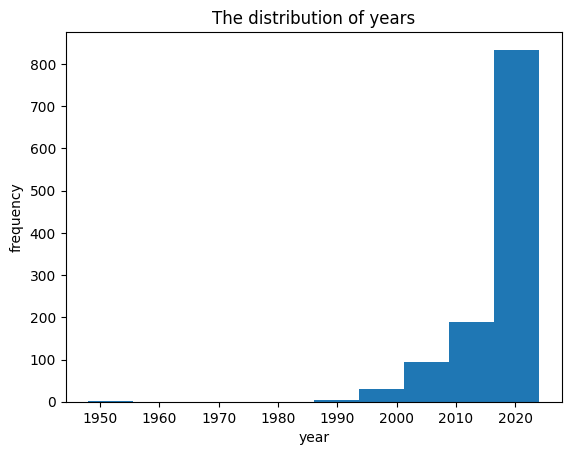

In [215]:
#let's use plot with kind = hist to see the distribution of the year to make sure it was a successful
#operation.
neo_cleaned['year_discovered'].plot(kind='hist', x = 'year_discovered', 
                         xlabel='year', ylabel='frequency', title='The distribution of years')

Justification: using the extract method and regular expression the year that the object was discovered was successfully extracted and the characters after the year was used as names for neo objects. 

### **Remove unnecessary variables and combine datasets**

i want to perform another combination on the cleaned four datasets that were cleaned separately.
this cleaned dataset will be saved and used for answering the research questions.

In [217]:
#same as the first combination process.
#i chose the outer for this merge because we have two different space event, both of them happened at 
#different dates maybe so i want all the dates that FLR happened or CME.
cleaned_cme_flr = pd.merge(flr_cleaned, cme_cleaned, on='date', how='outer')
cleaned_cme_flr


,date,classType_FLR,halfAngle_CME,speed_CME,type_CME
0,2024-01-01,M2.3,26.0,416000.0,S
1,2024-01-01,M4.7,26.0,416000.0,S
2,2024-01-02,M1.1,40.0,617000.0,C
3,2024-01-02,M1.1,31.0,462000.0,S
4,2024-01-02,M1.1,15.0,206000.0,S
...,...,...,...,...,...
523,2024-02-28,M1.5,43.0,730000.0,C
524,2024-02-28,M1.5,22.0,779000.0,C
525,2024-02-29,NaN,36.0,322000.0,S
526,2024-03-01,NaN,13.0,552000.0,C


consider this is the one dataset that has over than 500 records and up to 4 variables.

In [220]:
cleaned_cme_flr['date'] = pd.to_datetime(cleaned_cme_flr['date'])

In [222]:
#but this i only want the dates where there were observations for near eath objects and there's either
#a FLR or CME, i'm not interested in dates where there's only FLR or CME with no data for neo, 
#or there's data for neo but there's no CME or FLR.
cleaned_neo_donki = pd.merge(neo_cleaned, cleaned_cme_flr, on = 'date', how='inner')
cleaned_neo_donki

,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km,year_discovered,name_neo,classType_FLR,halfAngle_CME,speed_CME,type_CME
0,19.37,355.267088,794.401360,2024-01-02,15890.526422,5.045241e+10,2001,XY10,M1.1,40.0,617000.0,C
1,19.37,355.267088,794.401360,2024-01-02,15890.526422,5.045241e+10,2001,XY10,M1.1,31.0,462000.0,S
2,19.37,355.267088,794.401360,2024-01-02,15890.526422,5.045241e+10,2001,XY10,M1.1,15.0,206000.0,S
3,26.00,16.770846,37.500752,2024-01-02,10719.181898,1.979817e+10,2003,SR84,M1.1,40.0,617000.0,C
4,26.00,16.770846,37.500752,2024-01-02,10719.181898,1.979817e+10,2003,SR84,M1.1,31.0,462000.0,S
...,...,...,...,...,...,...,...,...,...,...,...,...
10225,26.13,15.796286,35.321568,2024-03-01,6006.096836,6.071125e+09,2024,FE1,NaN,40.0,263000.0,S
10226,25.72,19.078972,42.661879,2024-03-01,4491.427500,5.728611e+09,2024,FH1,NaN,13.0,552000.0,C
10227,25.72,19.078972,42.661879,2024-03-01,4491.427500,5.728611e+09,2024,FH1,NaN,40.0,263000.0,S
10228,19.06,409.783980,916.304836,2024-03-01,35644.483480,6.728181e+10,2018,GY4,NaN,13.0,552000.0,C


In [225]:
#finally the last merge with the last dataset tempdaily.
#i will use inner merge because i only want the matching dates.
cleaned_final = pd.merge(cleaned_neo_donki, temp_cleaned, on='date', how = 'inner')
cleaned_final

,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km,year_discovered,name_neo,classType_FLR,halfAngle_CME,speed_CME,type_CME,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
0,19.37,355.267088,794.401360,2024-01-02,15890.526422,5.045241e+10,2001,XY10,M1.1,40.0,617000.0,C,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
1,19.37,355.267088,794.401360,2024-01-02,15890.526422,5.045241e+10,2001,XY10,M1.1,31.0,462000.0,S,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
2,19.37,355.267088,794.401360,2024-01-02,15890.526422,5.045241e+10,2001,XY10,M1.1,15.0,206000.0,S,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
3,26.00,16.770846,37.500752,2024-01-02,10719.181898,1.979817e+10,2003,SR84,M1.1,40.0,617000.0,C,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
4,26.00,16.770846,37.500752,2024-01-02,10719.181898,1.979817e+10,2003,SR84,M1.1,31.0,462000.0,S,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10207,26.13,15.796286,35.321568,2024-03-01,6006.096836,6.071125e+09,2024,FE1,NaN,40.0,263000.0,S,22.3,999.0,24.2,32.2,44.3,26.4,15.3
10208,25.72,19.078972,42.661879,2024-03-01,4491.427500,5.728611e+09,2024,FH1,NaN,13.0,552000.0,C,22.3,999.0,24.2,32.2,44.3,26.4,15.3
10209,25.72,19.078972,42.661879,2024-03-01,4491.427500,5.728611e+09,2024,FH1,NaN,40.0,263000.0,S,22.3,999.0,24.2,32.2,44.3,26.4,15.3
10210,19.06,409.783980,916.304836,2024-03-01,35644.483480,6.728181e+10,2018,GY4,NaN,13.0,552000.0,C,22.3,999.0,24.2,32.2,44.3,26.4,15.3


## 4. Update your data store
Update your local database/data store with the cleaned data, following best practices for storing your cleaned data:

- Must maintain different instances / versions of data (raw and cleaned data)
- Must name the dataset files informatively
- Ensure both the raw and cleaned data is saved to your database/data store

In [5]:
print(folder_name)

Datasets_2024-01


In [226]:
#FILL IN - saving data
cleaned_file = "2024_cleaned_neo_cme_flr_temp.csv"
save_neo(cleaned_final, folder_name, cleaned_file)

## 5. Answer the research question

### **5.1:** Define and answer the research question 
Going back to the problem statement in step 1, use the cleaned data to answer the question you raised. Produce **at least** two visualizations using the cleaned data and explain how they help you answer the question.

*Research question:* IS there a relationship between the objects in the asteroid belt with the weather on planet earth?
This question needs the exploration of the the variables ['absolute_magnitude_h', 'estimated_diameter_min', 'estimated_diameter_max' (i will take the mean value of these two columns.),
'miss_distance_km'] related to the objects from neo dataset, with the variables ['TEMP', 'SLP', 'WDSP', 'MXSPD', 'GUST', 'MAX', 'MIN'] related to weather on earth.


In [31]:
#Visual 1 - FILL IN
#read the merged final cleaned dataset
df_f = pd.read_csv("Datasets_2024-01/2024_cleaned_neo_cme_flr_temp.csv")
df_f.head()

,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km,year_discovered,name_neo,classType_FLR,halfAngle_CME,speed_CME,type_CME,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
0,19.37,355.267088,794.401360,2024-01-02,15890.526422,5.045241e+10,2001,XY10,M1.1,40.0,617000.0,C,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
1,19.37,355.267088,794.401360,2024-01-02,15890.526422,5.045241e+10,2001,XY10,M1.1,31.0,462000.0,S,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
2,19.37,355.267088,794.401360,2024-01-02,15890.526422,5.045241e+10,2001,XY10,M1.1,15.0,206000.0,S,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
3,26.00,16.770846,37.500752,2024-01-02,10719.181898,1.979817e+10,2003,SR84,M1.1,40.0,617000.0,C,33.3,1006.9,6.4,15.3,20.6,34.5,31.1
4,26.00,16.770846,37.500752,2024-01-02,10719.181898,1.979817e+10,2003,SR84,M1.1,31.0,462000.0,S,33.3,1006.9,6.4,15.3,20.6,34.5,31.1


In [32]:
type(df_f)

pandas.core.frame.DataFrame

In [65]:
magn_earth = df_f.groupby(['absolute_magnitude_h'], sort=True)[['TEMP', 'SLP', 'WDSP',
                                                'MXSPD', 'GUST','MAX',  'MIN']].mean()
magn_earth

,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
absolute_magnitude_h,,,,,,,
14.28,30.6,988.8,14.4,20.8,29.5,33.1,22.8
16.14,32.6,967.1,14.4,27.2,35.7,34.9,30.6
16.28,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
16.41,32.0,974.8,18.6,31.9,44.7,37.4,25.5
16.47,32.5,1005.3,9.1,18.6,24.9,33.3,28.0
...,...,...,...,...,...,...,...
30.86,26.0,1029.8,9.7,20.4,37.1,41.9,20.3
30.90,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
31.46,32.5,1005.3,9.1,18.6,24.9,33.3,28.0


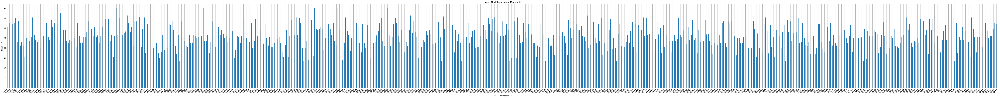

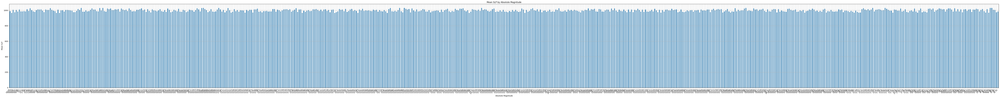

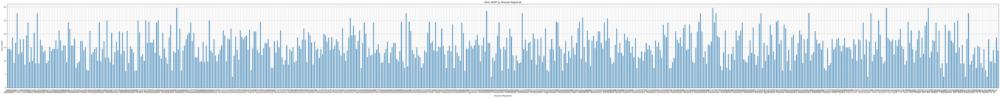

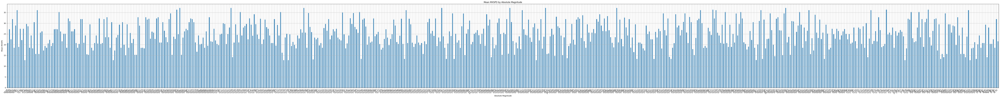

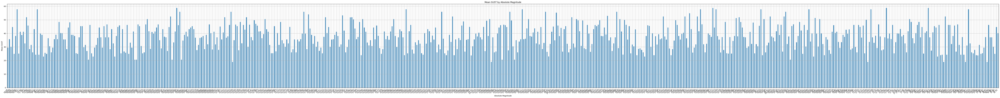

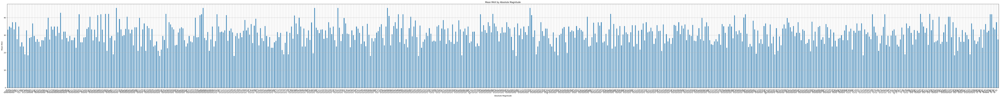

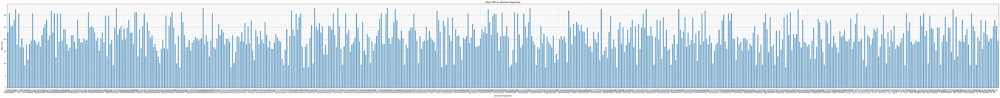

In [68]:
import matplotlib.pyplot as plt

cols_plot = ['TEMP' ,'SLP', 'WDSP', 'MXSPD', 'GUST', 'MAX', 'MIN']

for co in cols_plot:
    magn_earth[co].plot(kind='bar', figsize=(80, 8), x='absolute_magnitude_h')
    plt.title(f'Mean {co} by Absolute Magnitude')
    plt.xlabel('Absolute Magnitude')
    plt.ylabel(f'Mean {co}')
    plt.grid(True)
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

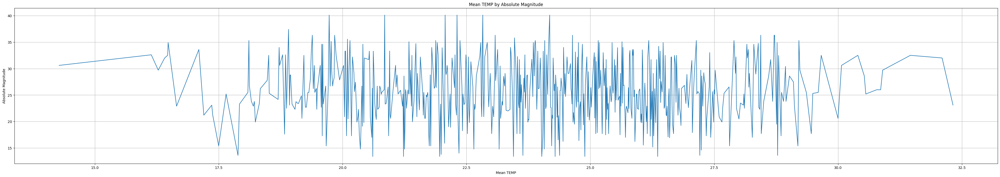

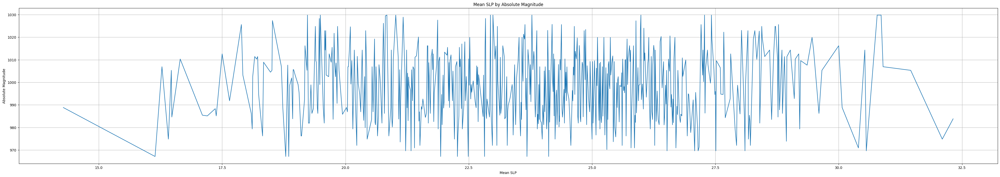

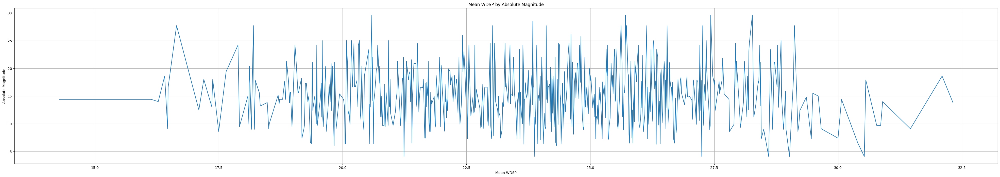

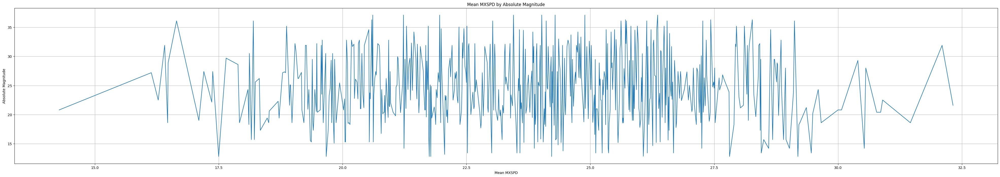

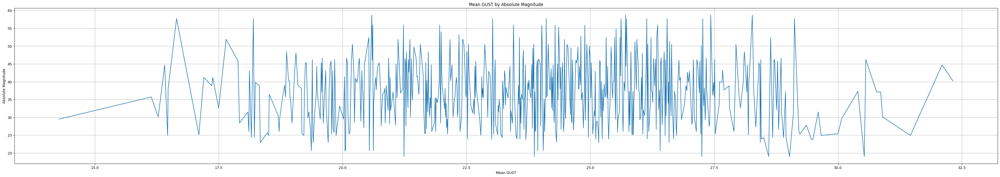

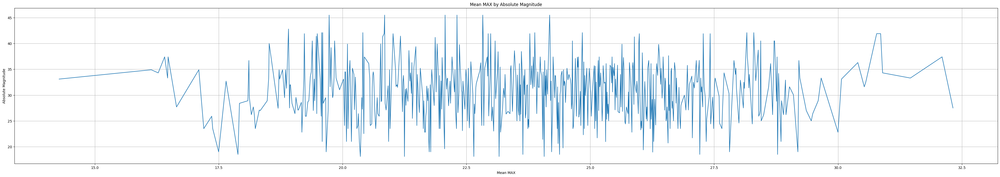

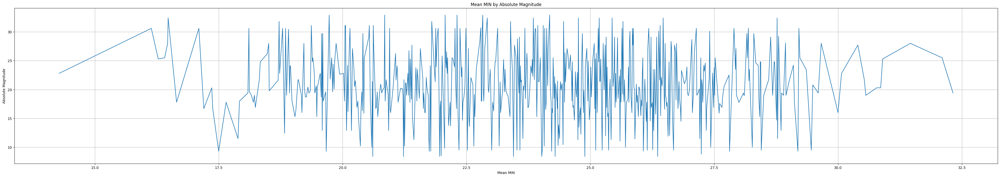

In [46]:
for co in cols_plot:
    magn_earth[co].plot(kind='line', figsize=(50, 8), x = co, y = 'absolute_magnitude_h')
    plt.title(f'Mean {co} by Absolute Magnitude')
    plt.xlabel(f'Mean {co}')
    plt.ylabel('Absolute Magnitude')
    plt.grid(True)
    plt.show()

In [69]:
df_f['mean_estimated_diameter'] = (df_f['estimated_diameter_min'] + df_f['estimated_diameter_max'])/2
df_f

,absolute_magnitude_h,estimated_diameter_min,estimated_diameter_max,date,velocity_km_s,miss_distance_km,year_discovered,name_neo,classType_FLR,halfAngle_CME,speed_CME,type_CME,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN,mean_estimated_diameter
0,19.37,355.267088,794.401360,2024-01-02,15890.526422,5.045241e+10,2001,XY10,M1.1,40.0,617000.0,C,33.3,1006.9,6.4,15.3,20.6,34.5,31.1,574.834224
1,19.37,355.267088,794.401360,2024-01-02,15890.526422,5.045241e+10,2001,XY10,M1.1,31.0,462000.0,S,33.3,1006.9,6.4,15.3,20.6,34.5,31.1,574.834224
2,19.37,355.267088,794.401360,2024-01-02,15890.526422,5.045241e+10,2001,XY10,M1.1,15.0,206000.0,S,33.3,1006.9,6.4,15.3,20.6,34.5,31.1,574.834224
3,26.00,16.770846,37.500752,2024-01-02,10719.181898,1.979817e+10,2003,SR84,M1.1,40.0,617000.0,C,33.3,1006.9,6.4,15.3,20.6,34.5,31.1,27.135799
4,26.00,16.770846,37.500752,2024-01-02,10719.181898,1.979817e+10,2003,SR84,M1.1,31.0,462000.0,S,33.3,1006.9,6.4,15.3,20.6,34.5,31.1,27.135799
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10207,26.13,15.796286,35.321568,2024-03-01,6006.096836,6.071125e+09,2024,FE1,NaN,40.0,263000.0,S,22.3,999.0,24.2,32.2,44.3,26.4,15.3,25.558927
10208,25.72,19.078972,42.661879,2024-03-01,4491.427500,5.728611e+09,2024,FH1,NaN,13.0,552000.0,C,22.3,999.0,24.2,32.2,44.3,26.4,15.3,30.870426
10209,25.72,19.078972,42.661879,2024-03-01,4491.427500,5.728611e+09,2024,FH1,NaN,40.0,263000.0,S,22.3,999.0,24.2,32.2,44.3,26.4,15.3,30.870426
10210,19.06,409.783980,916.304836,2024-03-01,35644.483480,6.728181e+10,2018,GY4,NaN,13.0,552000.0,C,22.3,999.0,24.2,32.2,44.3,26.4,15.3,663.044408


In [70]:
diameter_earth = df_f.groupby(['mean_estimated_diameter'], sort=True)[['TEMP', 'SLP', 'WDSP',
                                                'MXSPD', 'GUST','MAX',  'MIN']].mean()
diameter_earth

,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
mean_estimated_diameter,,,,,,,
1.477551,23.1,983.8,13.8,21.6,40.2,27.5,19.4
1.635094,32.0,974.8,18.6,31.9,44.7,37.4,25.5
2.195546,32.5,1005.3,9.1,18.6,24.9,33.3,28.0
2.841467,29.7,1006.9,14.0,22.5,30.1,34.3,25.3
2.894294,26.0,1029.8,9.7,20.4,37.1,41.9,20.3
...,...,...,...,...,...,...,...
2185.458766,32.5,1005.3,9.1,18.6,24.9,33.3,28.0
2246.687230,32.0,974.8,18.6,31.9,44.7,37.4,25.5
2385.297851,29.7,1006.9,14.0,22.5,30.1,34.3,25.3


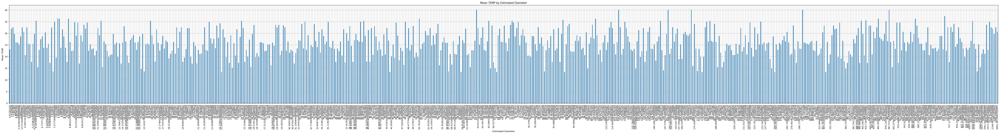

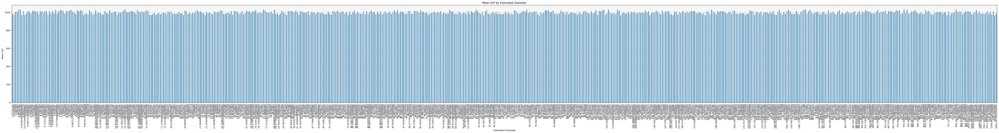

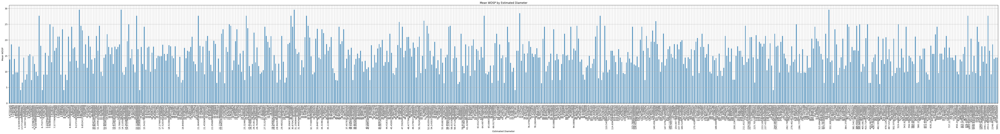

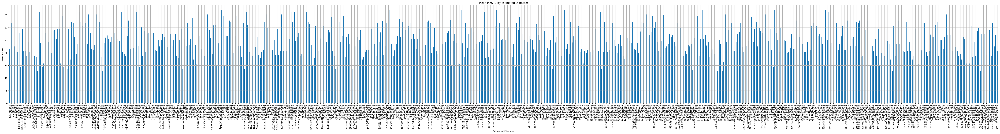

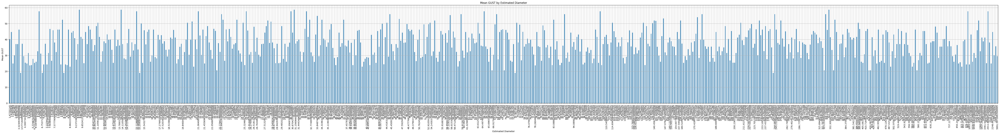

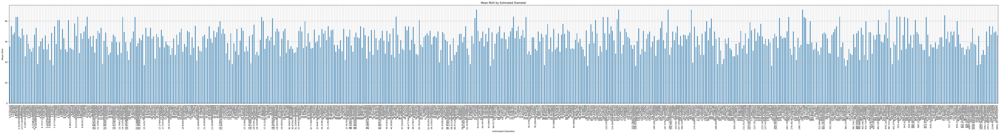

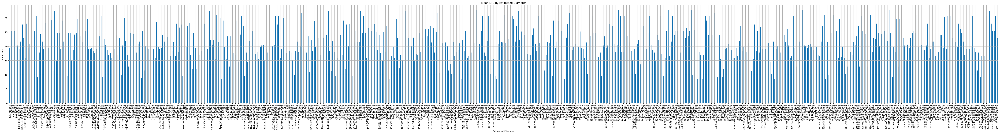

In [71]:

for co in cols_plot:
    diameter_earth[co].plot(kind='bar', figsize=(80, 8))
    plt.title(f'Mean {co} by Estimated Diameter')
    plt.xlabel('Estimated Diameter')
    plt.ylabel(f'Mean {co}')
    plt.grid(True)
    plt.show()

In [72]:
velocity_earth = df_f.groupby(['velocity_km_s'], sort=True)[['TEMP', 'SLP', 'WDSP',
                                                'MXSPD', 'GUST','MAX',  'MIN']].mean()
velocity_earth

,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
velocity_km_s,,,,,,,
393.949575,26.2,1008.9,13.2,17.3,22.9,27.0,24.8
530.438380,40.1,1015.5,17.1,23.3,38.1,45.5,32.9
1437.722189,34.6,1022.9,11.2,23.5,37.1,42.1,29.7
1484.077375,31.7,983.5,23.4,34.6,52.4,36.1,29.1
1552.993012,26.3,982.2,14.2,24.9,46.0,31.5,21.4
...,...,...,...,...,...,...,...
39592.053348,17.3,1014.3,25.0,32.8,46.6,21.0,12.9
39726.161013,28.2,987.8,6.3,15.2,26.6,33.8,19.9
40727.238437,26.0,1029.8,9.7,20.4,37.1,41.9,20.3


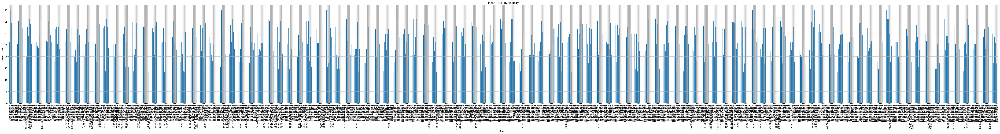

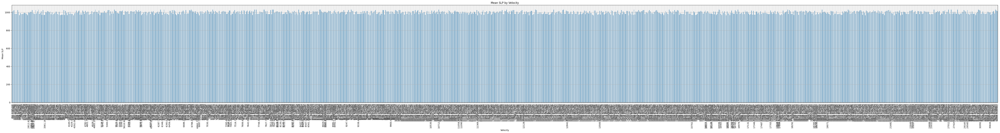

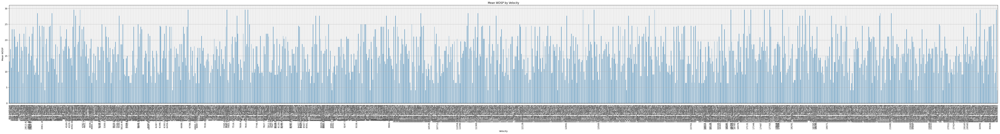

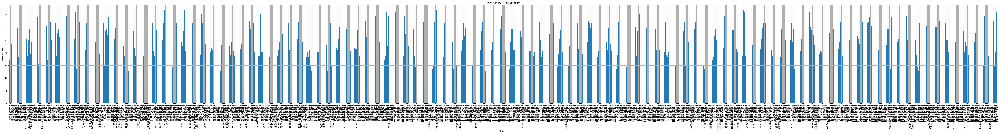

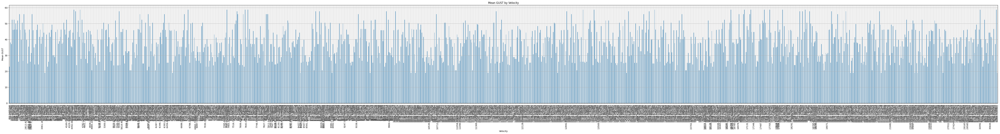

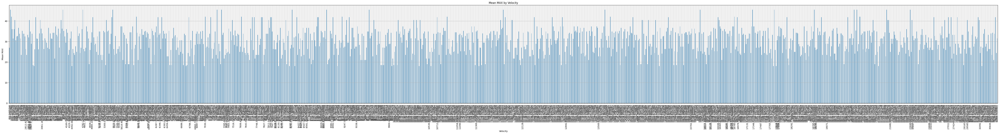

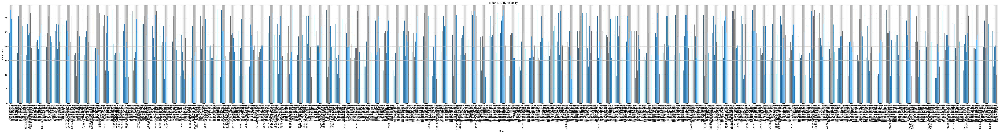

In [73]:
for co in cols_plot:
    velocity_earth[co].plot(kind='bar', figsize=(80, 8))
    plt.title(f'Mean {co} by Velocity')
    plt.xlabel('Velocity')
    plt.ylabel(f'Mean {co}')
    plt.grid(True)
    plt.show()

In [80]:
distance_earth = df_f.groupby(['miss_distance_km'], sort=True)[[ 'TEMP', 'SLP', 'WDSP',
                                                'MXSPD', 'GUST','MAX',  'MIN']].mean()
distance_earth

,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
miss_distance_km,,,,,,,
1.058801e+08,17.7,1019.9,7.3,13.4,23.9,25.0,9.5
1.090451e+08,25.3,1014.5,15.5,20.2,23.7,26.4,20.8
1.194762e+08,36.3,1024.8,21.1,29.5,46.2,40.5,24.8
1.214647e+08,29.7,1009.6,12.4,18.6,25.3,33.3,25.5
1.400097e+08,17.3,1014.3,25.0,32.8,46.6,21.0,12.9
...,...,...,...,...,...,...,...
7.447971e+10,26.0,1029.8,9.7,20.4,37.1,41.9,20.3
7.453924e+10,29.1,972.0,24.5,32.1,41.6,34.0,23.5
7.453924e+10,29.1,972.0,24.5,32.1,41.6,34.0,23.5


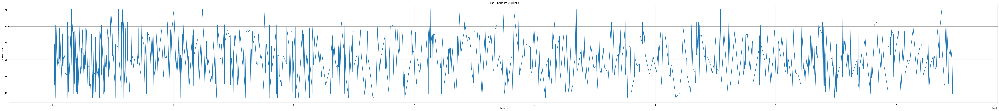

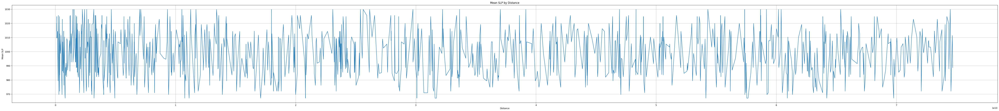

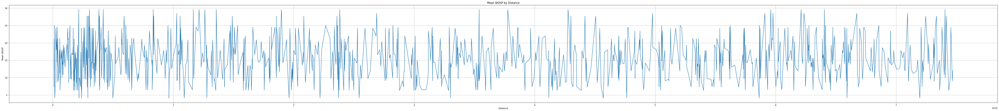

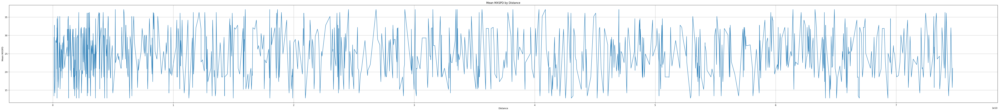

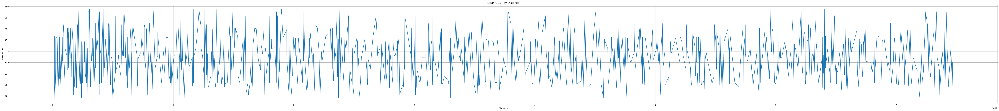

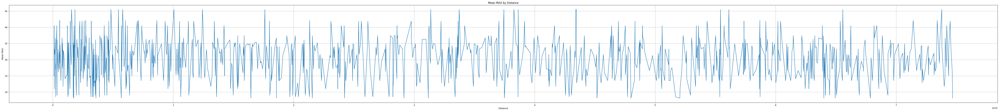

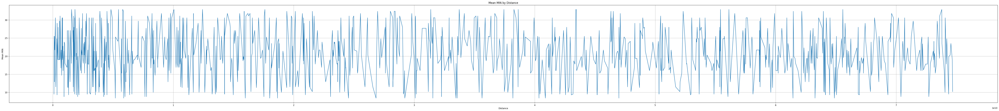

In [85]:

for co in cols_plot:
    distance_earth[co].plot(kind='line', figsize=(80, 8), x ='miss_distance_km')
    plt.title(f'Mean {co} by Distance')
    plt.xlabel('Distance')
    plt.ylabel(f'Mean {co}')
    plt.grid(True)
    plt.show()

*Answer to research question:* FILL IN

*Research question:* Is there a relationship between the space events like CME and FLR with NEO objects features ['absolute_magnitude_h', 'mean_estimated_diameter','miss_distance_km'].

In [92]:
cme_speed_neo = df_f.groupby(['speed_CME'], sort=True)[['absolute_magnitude_h', 
                                    'mean_estimated_diameter','miss_distance_km', 'velocity_km_s']].mean()
cme_speed_neo

,absolute_magnitude_h,mean_estimated_diameter,miss_distance_km,velocity_km_s
speed_CME,,,,
206000.0,23.495909,155.564927,2.324782e+10,11872.355594
207000.0,24.083500,134.736577,3.346925e+10,14312.188929
209000.0,24.003143,165.238896,3.490476e+10,14367.662436
215000.0,23.813077,181.170353,2.854276e+10,13044.445835
227000.0,24.182222,88.838043,2.251230e+10,15100.846404
...,...,...,...,...
1815000.0,24.611500,89.830127,2.588888e+10,11497.569610
1953000.0,23.813077,181.170353,2.854276e+10,13044.445835
2012000.0,24.434211,115.988566,2.491796e+10,12876.928873


In [93]:
neo_cols = ['absolute_magnitude_h', 'mean_estimated_diameter','miss_distance_km', 'velocity_km_s']

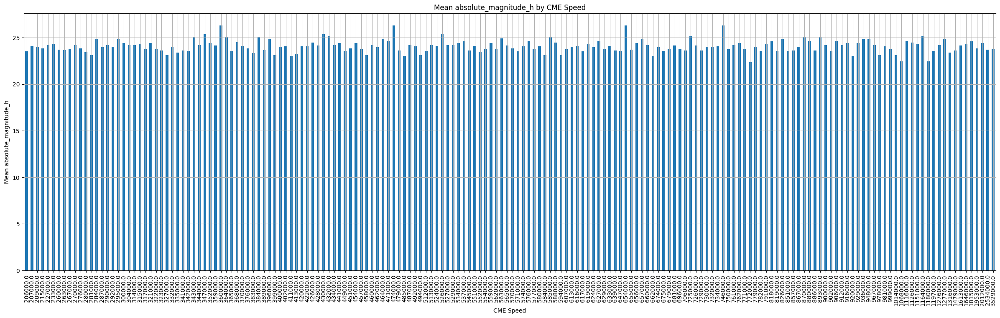

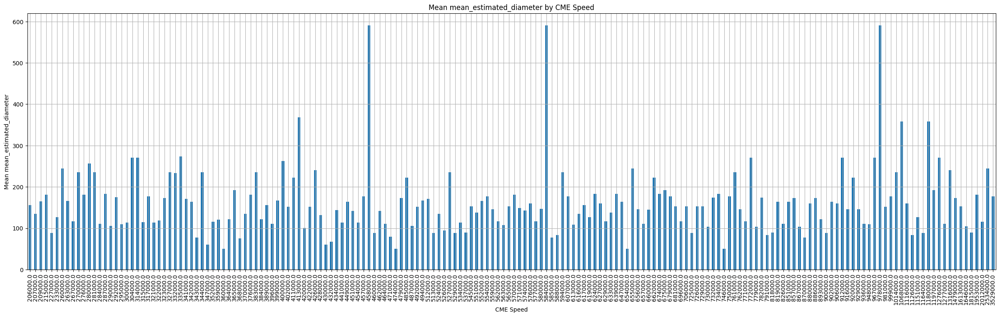

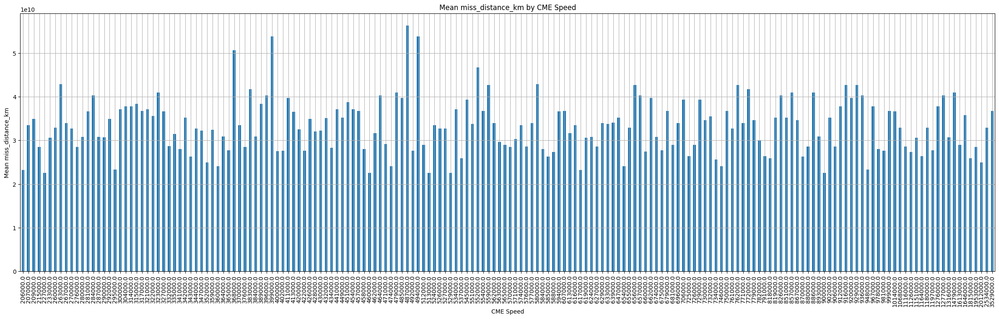

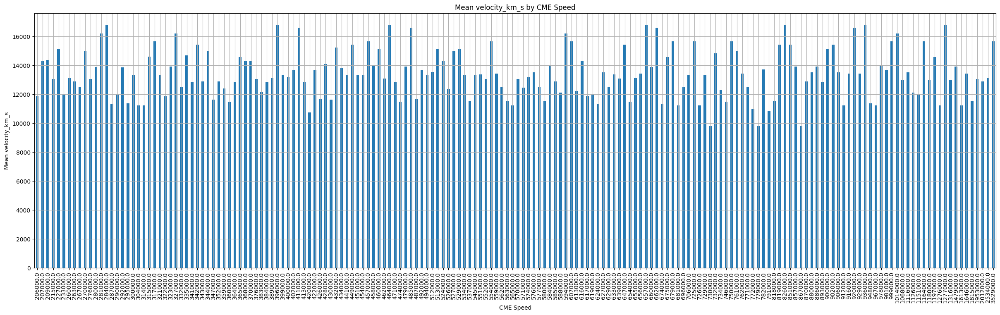

In [94]:
for co in neo_cols:
    cme_speed_neo[co].plot(kind='bar', figsize=(30, 8))
    plt.title(f'Mean {co} by CME Speed')
    plt.xlabel('CME Speed')
    plt.ylabel(f'Mean {co}')
    plt.grid(True)
    plt.show()

In [95]:
cme_halfAngle_neo = df_f.groupby(['halfAngle_CME'], sort=True)[['absolute_magnitude_h', 
                                    'mean_estimated_diameter','miss_distance_km', 'velocity_km_s']].mean()
cme_halfAngle_neo

,absolute_magnitude_h,mean_estimated_diameter,miss_distance_km,velocity_km_s
halfAngle_CME,,,,
10.0,24.035486,149.989754,3.145246e+10,12967.539673
11.0,23.113077,166.933469,5.388212e+10,13344.753939
12.0,23.975519,150.554641,3.458613e+10,13911.193742
13.0,24.189801,140.086024,3.153128e+10,11855.613579
14.0,23.551220,148.541745,3.834671e+10,14696.706335
15.0,24.285281,128.747562,3.312541e+10,14746.425826
16.0,23.931636,153.206056,3.139887e+10,14470.484053
17.0,23.627895,152.375618,3.938104e+10,13348.565068
18.0,24.325978,125.719632,2.913609e+10,12749.318656


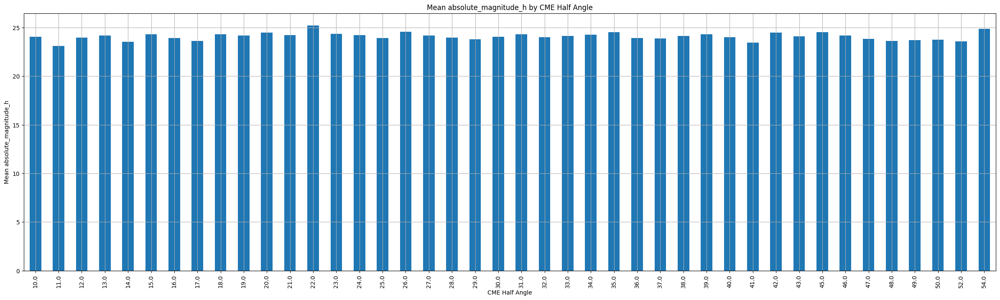

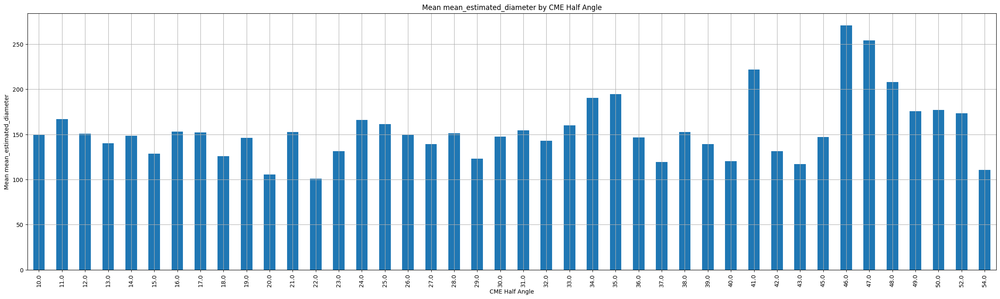

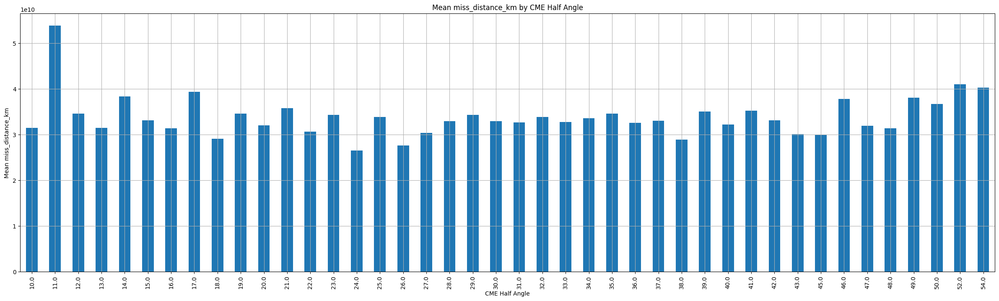

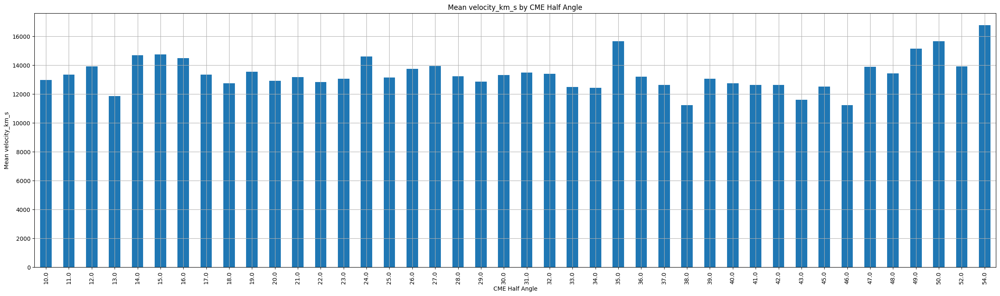

In [96]:
for co in neo_cols:
    cme_halfAngle_neo[co].plot(kind='bar', figsize=(30, 8))
    plt.title(f'Mean {co} by CME Half Angle')
    plt.xlabel('CME Half Angle')
    plt.ylabel(f'Mean {co}')
    plt.grid(True)
    plt.show()

In [97]:
flr_class_neo = df_f.groupby(['classType_FLR'], sort=True)[['absolute_magnitude_h', 
                                    'mean_estimated_diameter','miss_distance_km',
                                                                'velocity_km_s']].mean()
flr_class_neo

,absolute_magnitude_h,mean_estimated_diameter,miss_distance_km,velocity_km_s
classType_FLR,,,,
C1.9,23.093810,235.044325,3.667543e+10,16195.739094
C3.0,23.740929,166.254929,3.137937e+10,14195.260013
C3.1,24.611500,89.830127,2.588888e+10,11497.569610
C3.3,23.627895,152.375618,3.938104e+10,13348.565068
C3.5,23.106667,590.539603,2.807032e+10,14028.348722
C3.8,23.878738,189.444848,3.643264e+10,14068.495899
C4.0,23.282963,213.291130,3.746080e+10,13235.535640
C4.1,24.050151,155.548686,3.476732e+10,13419.331894
C5.0,24.332069,83.183331,2.643394e+10,10865.501695


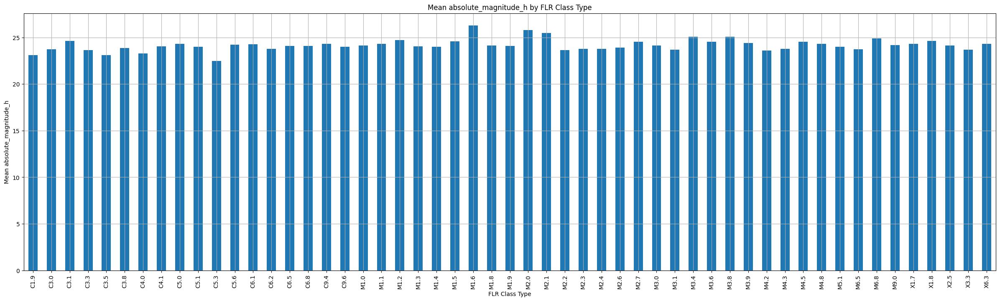

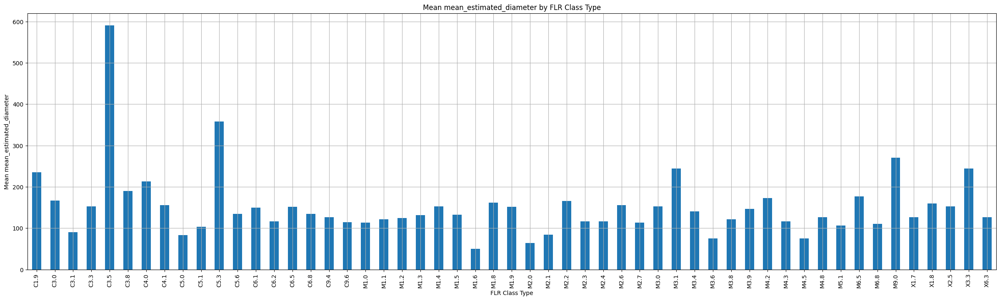

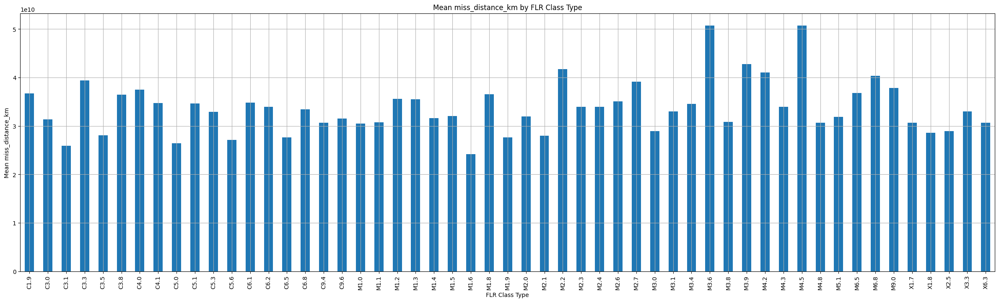

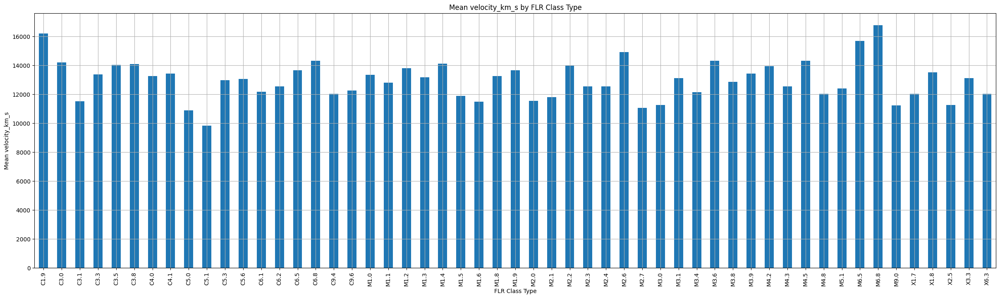

In [98]:
for co in neo_cols:
    flr_class_neo[co].plot(kind='bar', figsize=(30, 8))
    plt.title(f'Mean {co} by FLR Class Type')
    plt.xlabel('FLR Class Type')
    plt.ylabel(f'Mean {co}')
    plt.grid(True)
    plt.show()

In [ ]:
#Visual 2 - FILL IN

*Answer to research question:* FILL IN

*Research question:* IS there a relationship between Weather space events like CME and FLR on the weather on Earth?

In [99]:
class_type_flr_earth = df_f.groupby(['classType_FLR'], sort=True)[cols_plot].mean()
class_type_flr_earth

,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
classType_FLR,,,,,,,
C1.9,25.500000,986.200000,15.000000,24.300000,31.500000,28.900000,19.400000
C3.0,20.542857,982.485714,12.957143,23.092857,36.221429,24.100000,18.342857
C3.1,17.900000,983.100000,10.800000,21.000000,28.900000,21.700000,16.000000
C3.3,20.600000,1016.200000,7.400000,20.800000,25.400000,22.800000,16.000000
C3.5,30.600000,988.800000,14.400000,20.800000,29.500000,33.100000,22.800000
C3.8,25.914563,1011.332039,8.159223,19.817476,25.176699,27.489320,21.359223
C4.0,24.155556,1001.651852,9.474074,22.696296,28.451852,26.385185,20.325926
C4.1,26.152764,1003.044221,9.578392,20.031156,25.271859,27.968342,22.236181
C5.0,32.200000,992.600000,16.600000,31.700000,50.500000,35.200000,27.100000


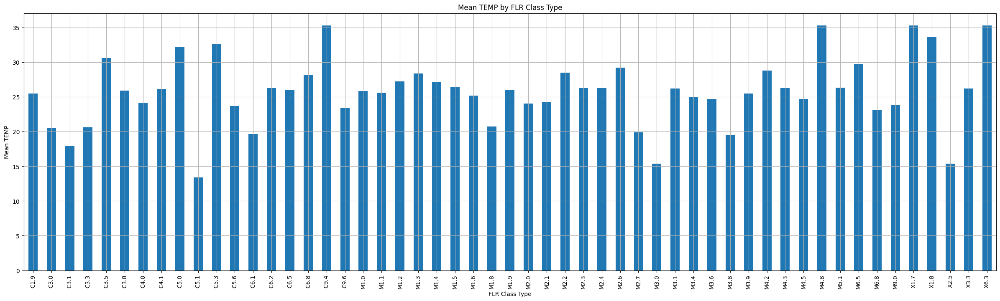

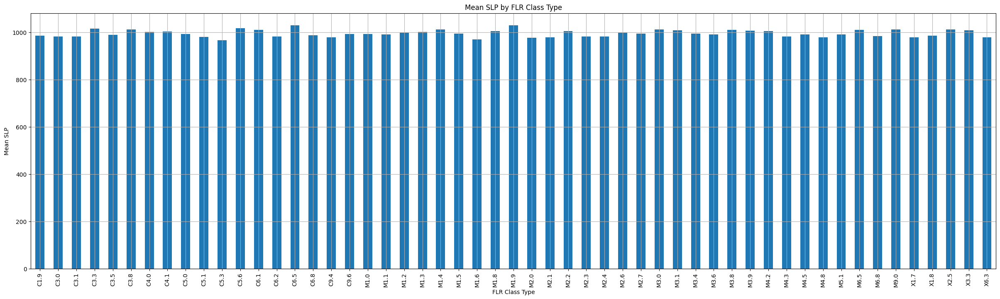

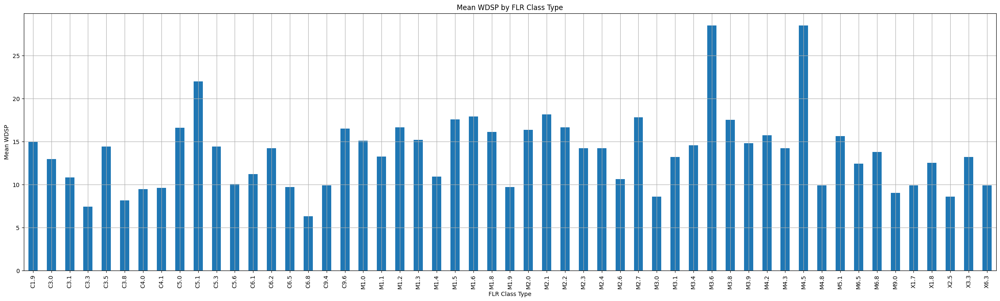

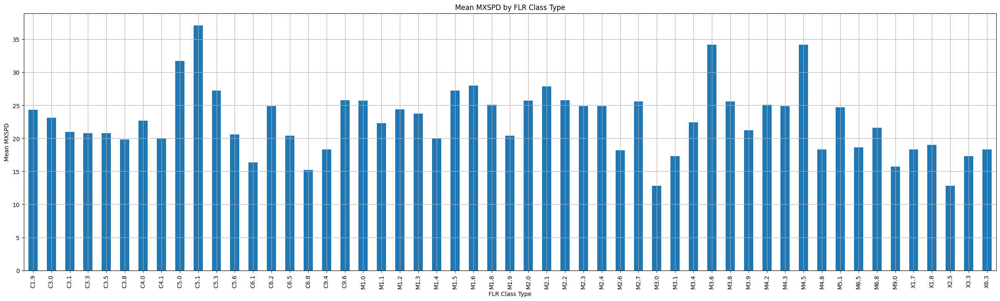

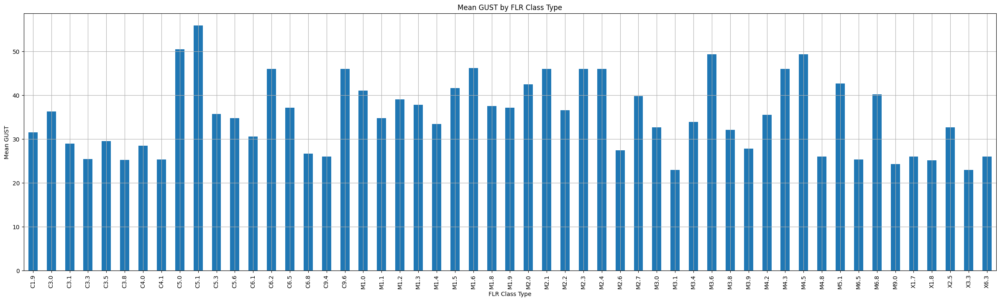

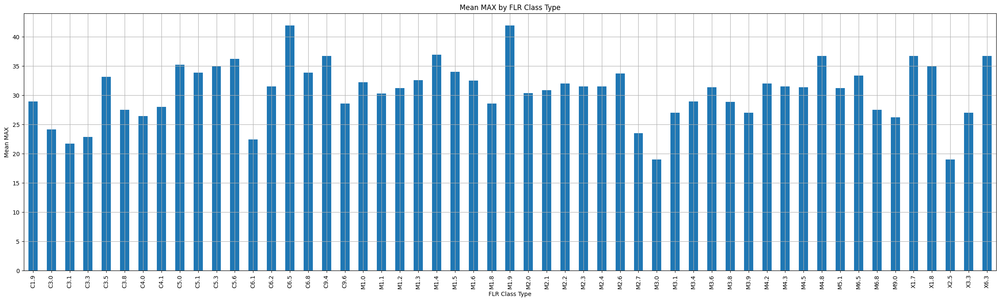

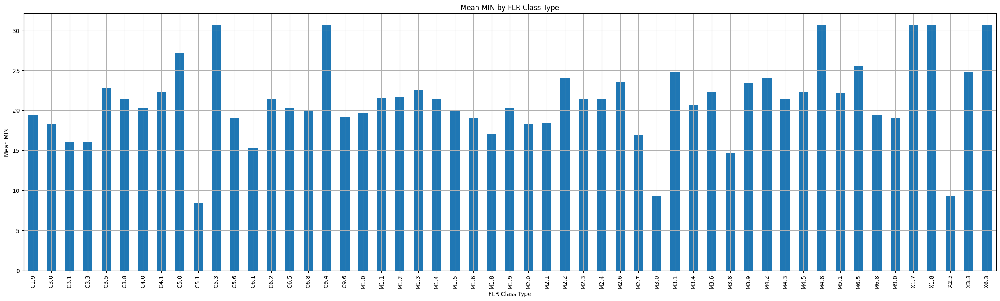

In [100]:
for co in cols_plot:
    class_type_flr_earth[co].plot(kind='bar', figsize=(30, 8))
    plt.title(f'Mean {co} by FLR Class Type')
    plt.xlabel('FLR Class Type')
    plt.ylabel(f'Mean {co}')
    plt.grid(True)
    plt.show()

In [101]:
cme_halfAngle_earth = df_f.groupby(['halfAngle_CME'], sort=True)[cols_plot].mean()
cme_halfAngle_earth

,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
halfAngle_CME,,,,,,,
10.0,29.219619,1010.033905,12.736952,22.557143,34.212190,35.885143,23.499810
11.0,20.600000,1010.300000,11.900000,22.000000,31.900000,26.600000,16.000000
12.0,26.495420,988.129771,8.629008,17.475573,29.333588,31.362595,19.108397
13.0,26.916418,993.083582,11.161194,18.071642,30.450746,29.394030,21.461194
14.0,22.253659,997.446341,16.378049,29.265854,42.017073,28.207317,16.219512
15.0,25.832584,993.243820,12.947191,22.052809,34.219101,28.740449,22.331461
16.0,23.690909,991.681818,14.454545,26.170000,37.381818,28.336364,20.041818
17.0,20.600000,1016.200000,7.400000,20.800000,25.400000,22.800000,16.000000
18.0,22.731522,987.591848,15.424457,26.692391,38.669565,26.797826,18.707065


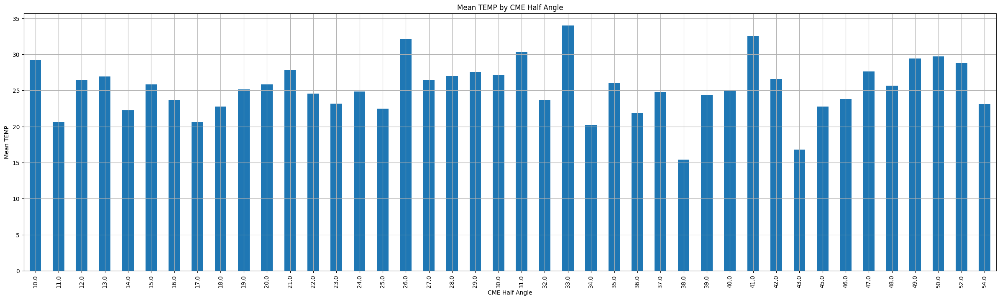

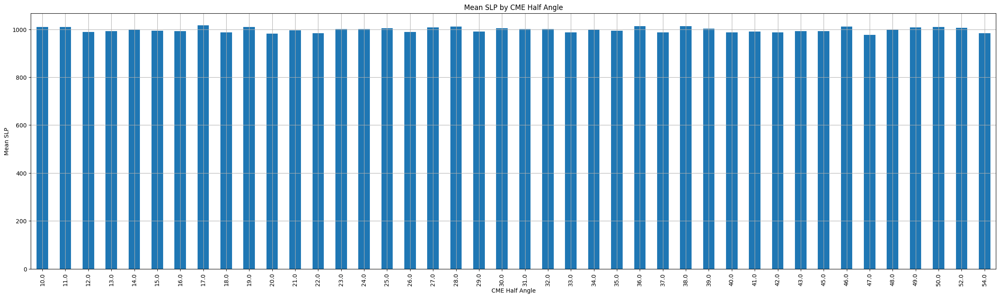

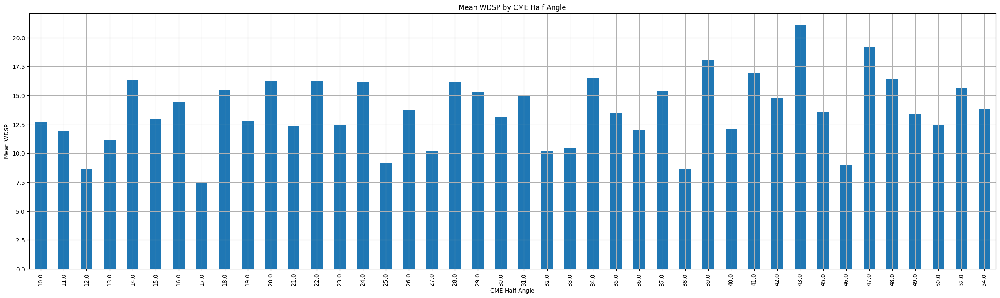

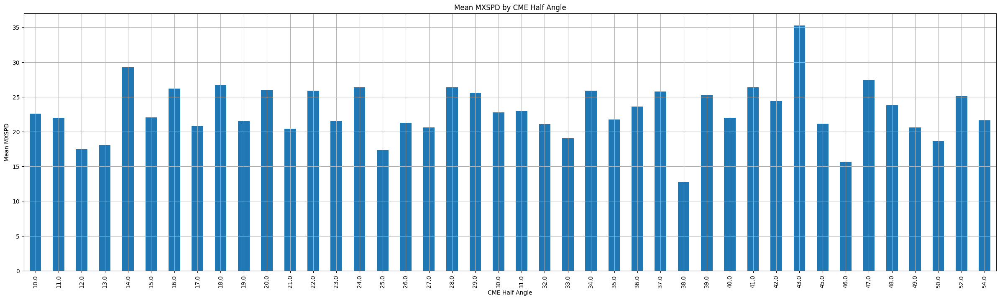

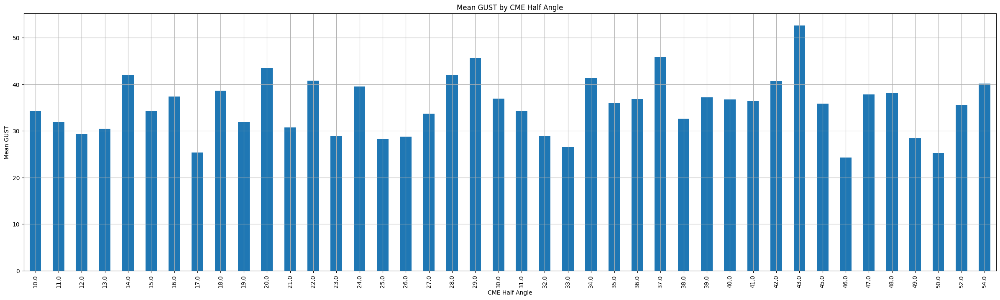

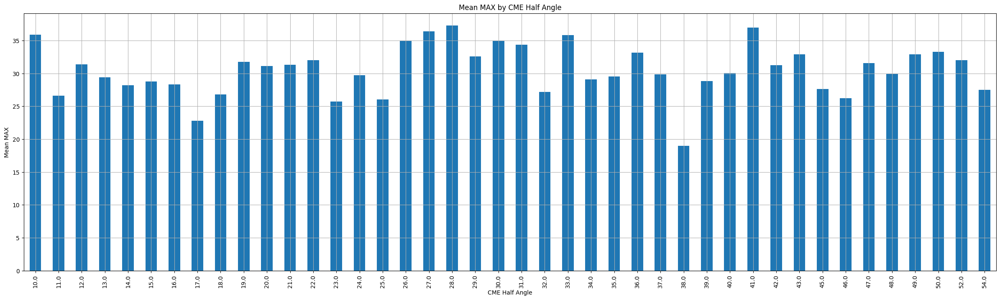

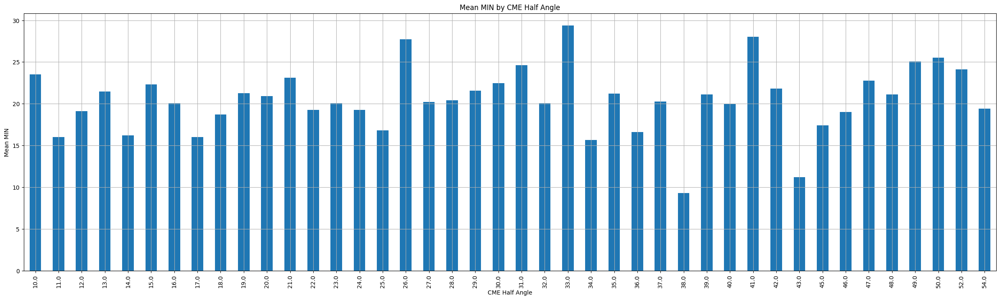

In [102]:
for co in cols_plot:
    cme_halfAngle_earth[co].plot(kind='bar', figsize=(30, 8))
    plt.title(f'Mean {co} by CME Half Angle')
    plt.xlabel('CME Half Angle')
    plt.ylabel(f'Mean {co}')
    plt.grid(True)
    plt.show()

In [103]:
cme_speed_earth = df_f.groupby(['speed_CME'], sort=True)[cols_plot].mean()
cme_speed_earth

,TEMP,SLP,WDSP,MXSPD,GUST,MAX,MIN
speed_CME,,,,,,,
206000.0,33.3,1006.90,6.4,15.3,20.60,34.50,31.10
207000.0,28.2,987.80,6.3,15.2,26.60,33.80,19.90
209000.0,28.3,980.08,11.6,26.3,33.82,31.86,22.72
215000.0,14.6,1003.20,17.8,30.1,50.10,30.60,8.80
227000.0,23.7,1011.70,20.9,34.2,49.70,35.40,11.30
...,...,...,...,...,...,...,...
1815000.0,17.9,983.10,10.8,21.0,28.90,21.70,16.00
1953000.0,14.6,1003.20,17.8,30.1,50.10,30.60,8.80
2012000.0,22.5,998.70,21.3,35.2,48.40,31.30,19.00


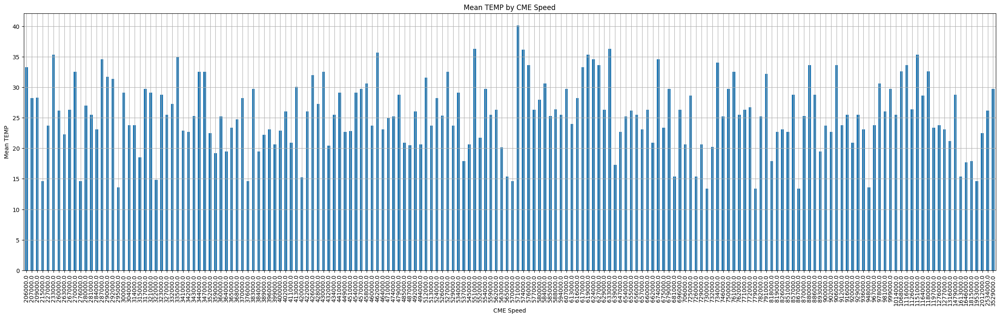

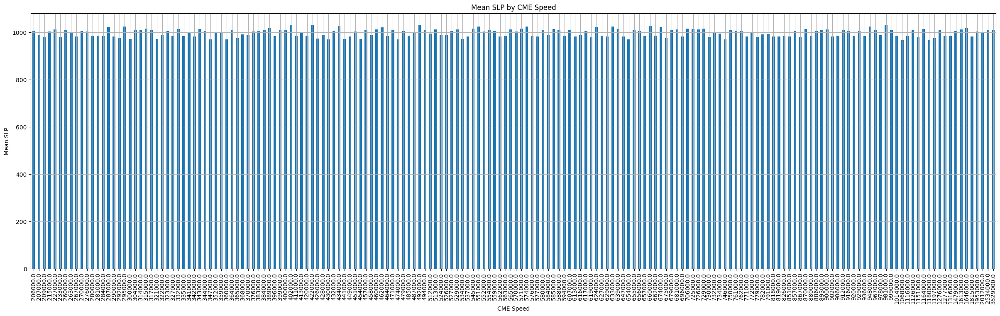

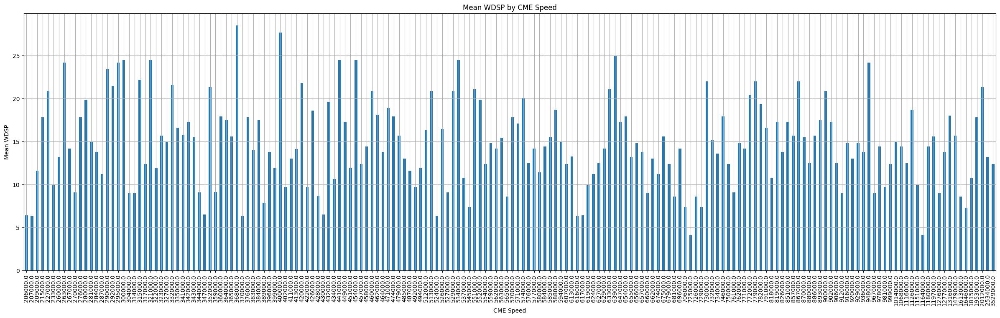

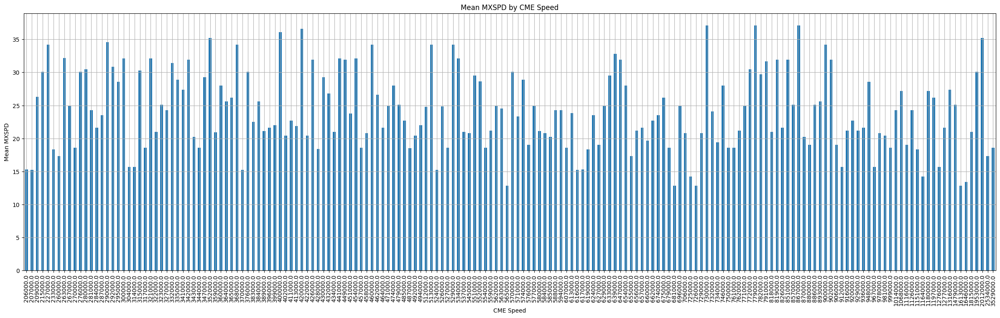

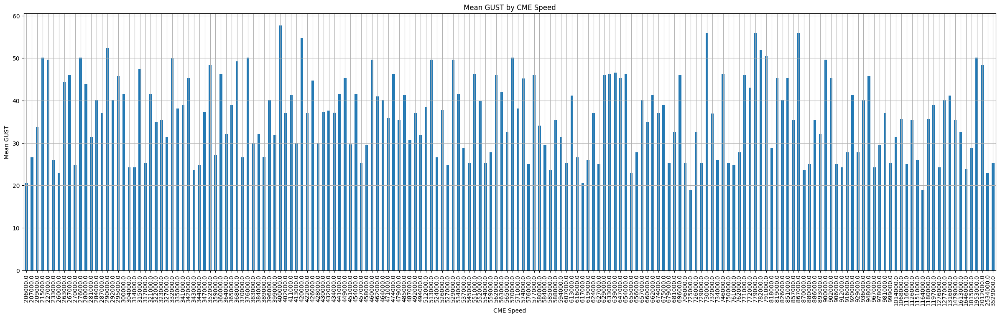

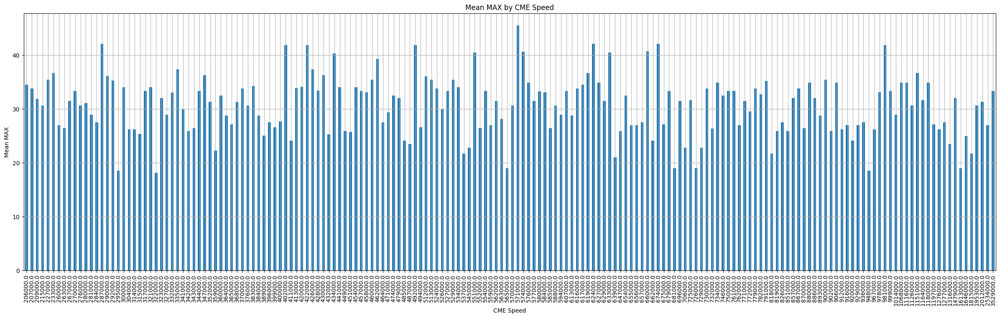

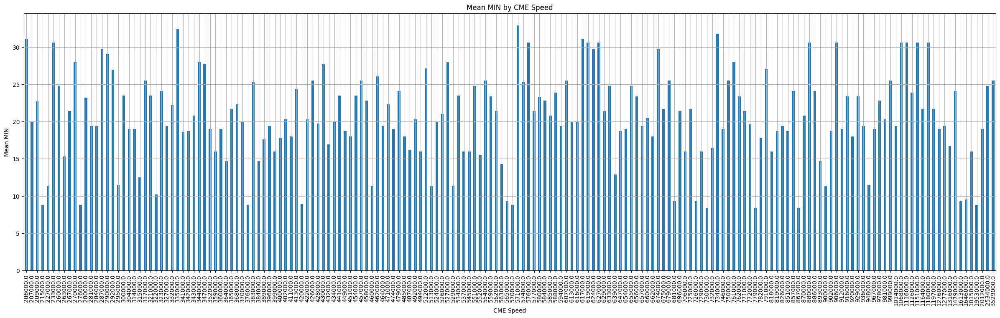

In [104]:
for co in cols_plot:
    cme_speed_earth[co].plot(kind='bar', figsize=(30, 8))
    plt.title(f'Mean {co} by CME Speed')
    plt.xlabel('CME Speed')
    plt.ylabel(f'Mean {co}')
    plt.grid(True)
    plt.show()

### **5.2:** Reflection
In 2-4 sentences, if you had more time to complete the project, what actions would you take? For example, which data quality and structural issues would you look into further, and what research questions would you further explore?

*Answer:* If i had more time i'd take not only the dates where the object was obsereved but only the day but also the hour for more details so i can see if any weather space events can change their orbits, i would also fetch more data from neo, donki and weather on earth datasets not only for a couple of months but years and get more data on the magnatic feild of the earth, surface tempareture and other natural disasters like hurricance and earthquackes to see if there's a relationship between these and space weather events.